In [4]:
import pandas as pd

df = pd.read_csv(r'/kaggle/input/samplepesu/Training Dataset_csv/V_AIRPLANE_001_LABELS.csv')

time_stamps = df.iloc[:,0]
time2 = list()
final_string = ""
for i in time_stamps:
    y = i.split()
    x = y[0]
    for j in x:
        if j.isdigit() or j == '.':
            final_string += j
    
    final_float = float(final_string)
    
    final_string =""
    time2.append(final_float)

In [5]:
labels = df.iloc[:,1]
print(labels)

0      [313.448181152344,204.424362182617,36.06567382...
1      [311.489379882813,204.399459838867,36.05471801...
2      [309.946655273438,203.389114379883,36.08734130...
3      [308.959167480469,203.633331298828,36.10455322...
4      [307.942230224609,203.588897705078,36.11926269...
                             ...                        
321    [297.975799560547,173.713272094727,37.44937133...
322    [300.422698974609,173.536026000977,37.89077758...
323    [300.410247802734,174.719696044922,37.90219116...
324    [300.782714843750,173.838226318359,37.95410156...
325    [299.602630615234,174.956436157227,37.81704711...
Name: [313,205,36,24], Length: 326, dtype: object


In [6]:
import os
os.makedirs('data')


In [7]:
import cv2
cap = cv2.VideoCapture('V_AIRPLANE_001.mp4')

In [36]:
#pasting code that im not using here

#code to add headers to csv
import os
import pandas as pd
import numpy as np
import json
import csv

file = pd.read_csv("/kaggle/input/samplepesu/Training Dataset_csv/V_AIRPLANE_001_LABELS.csv")

headerList = ['time_stamp','Airplane','Bird','Drone','Helicopter']
file.to_csv("gfg2.csv", header=headerList, index=False)

data = pd.read_csv("gfg2.csv")

cat_id(data)

#code to read the new csv file
with open('gfg2.csv') as file_obj:
      
    # Create reader object by passing the file 
    # object to reader method
    reader_obj = csv.reader(file_obj)
      
    # Iterate over each row in the csv 
    # file using reader object
    for row in reader_obj:
        print(row)

1

In [9]:
for i in time2:
    getFrame(i)

In [10]:
print(time2)

[0.033333, 0.066667, 0.1, 0.13333, 0.16667, 0.2, 0.23333, 0.26667, 0.3, 0.33333, 0.36667, 0.4, 0.43333, 0.46667, 0.5, 0.53333, 0.56667, 0.6, 0.63333, 0.66667, 0.7, 0.73333, 0.76667, 0.8, 0.83333, 0.86667, 0.9, 0.93333, 0.96667, 1.0, 1.0333, 1.0667, 1.1, 1.1333, 1.1667, 1.2, 1.2333, 1.2667, 1.3, 1.3333, 1.3667, 1.4, 1.4333, 1.4667, 1.5, 1.5333, 1.5667, 1.6, 1.6333, 1.6667, 1.7, 1.7333, 1.7667, 1.8, 1.8333, 1.8667, 1.9, 1.9333, 1.9667, 2.0, 2.0333, 2.0667, 2.1, 2.1333, 2.1667, 2.2, 2.2333, 2.2667, 2.3, 2.3333, 2.3667, 2.4, 2.4333, 2.4667, 2.5, 2.5333, 2.5667, 2.6, 2.6333, 2.6667, 2.7, 2.7333, 2.7667, 2.8, 2.8333, 2.8667, 2.9, 2.9333, 2.9667, 3.0, 3.0333, 3.0667, 3.1, 3.1333, 3.1667, 3.2, 3.2333, 3.2667, 3.3, 3.3333, 3.3667, 3.4, 3.4333, 3.4667, 3.5, 3.5333, 3.5667, 3.6, 3.6333, 3.6667, 3.7, 3.7333, 3.7667, 3.8, 3.8333, 3.8667, 3.9, 3.9333, 3.9667, 4.0, 4.0333, 4.0667, 4.1, 4.1333, 4.1667, 4.2, 4.2333, 4.2667, 4.3, 4.3333, 4.3667, 4.4, 4.4333, 4.4667, 4.5, 4.5333, 4.5667, 4.6, 4.6333, 4.6

In [ ]:
#from here new

In [ ]:
#dont use this make sure


dataset = None
import os
import pandas as pd
trainingDatasetVidDir = "/kaggle/input/samplepesu/Training Dataset_Videos"
trainingDatasetCSVDir = "/kaggle/input/samplepesu/Training Dataset_csv"
for video in os.listdir(trainingDatasetVidDir)[0:1]:
    csvFile = video.split('.')[0] + '_LABELS.csv'
    colNames = ['sec', 'Airplane', 'Bird', 'Drone', 'Helicopter']
    df = pd.read_csv(os.path.join(trainingDatasetCSVDir, csvFile), names=colNames, header=None)

    df = df.dropna()
    df['sec'] = df['sec'].apply(lambda x: x.split(' ')[0][1:])
    df = df[df['sec'] != '']
    df['sec'] = df['sec'].astype(float)
    
    res = pd.DataFrame(columns=['image', 'boxes', 'labels', 'area', 'iscrowd', 'image_id'])
    res['image'] = df['sec'].apply(lambda x: getFrame(os.path.join(trainingDatasetVidDir, video), x))
    res['img_rgb'] = res['image'].apply(lambda x: cv2.cvtColor(x, cv2.COLOR_BGR2RGB).astype(np.float32))
    res['img_res'] = res['img_rgb'].apply(lambda x: cv2.resize(x, (300, 300), cv2.INTER_AREA))
    res['img_res'] /= 255.0
    
    boxes = []
    labels = []
    areas = []
    iscrowds = []
    image_ids = []

    for index, row in df.iterrows():
        rBoxes = []
        rAreas = []
        rLabels = []
        rIscrowds = []
        rImage_id = []

        boundingBoxes = {'Airplane': [], 'Bird': [], 'Drone': [], 'Helicopter': []}
        for c in colNames[1:]:
            if row[c] == '[]':
                continue
            bb = row[c].split(';')
            for b in bb:
                b = b.split(',')
                b = [re.sub(r'\[|\]', '', i) for i in b]

                try:
                    x1, y1, x2, y2 = float(b[0]), float(b[1]), float(b[2]), float(b[3])
                except ValueError:
                    continue

                boundingBox = [x1, y1, x1+x2, y1+y2]
                area = (boundingBox[2] - boundingBox[0]) * (boundingBox[3] - boundingBox[1])
                iscrowd = 0

                rBoxes.append(boundingBox)
                rAreas.append(area)
                rLabels.append(['Airplane', 'Bird', 'Drone', 'Helicopter'].index(c))
                rIscrowds.append(iscrowd)
        
        image_id = [index]
        boxes.append(torch.as_tensor(rBoxes, dtype=torch.float32))
        labels.append(torch.as_tensor(rLabels, dtype=torch.int64))
        areas.append(torch.as_tensor(rAreas, dtype=torch.float32))
        iscrowds.append(torch.as_tensor(rIscrowds, dtype=torch.int64))
        image_ids.append(torch.as_tensor(image_id, dtype=torch.int64))

    res['boxes'] = boxes
    res['labels'] = labels
    res['area'] = areas
    res['iscrowd'] = iscrowds
    res['image_id'] = image_ids
    break
print(res.head())

In [1]:
import os
import pandas as pd
import numpy as np
import json
import csv
#have to change this function to make it find the thing
def cat_id(data): #data is the csv file read by pandas
    category_list =[]
    x=0
    with open('gfg2.csv') as file_obj:
      
    # Create reader object by passing the file 
    # object to reader method
        reader_obj = csv.reader(file_obj)

        # Iterate over each row in the csv 
        # file using reader object
        for row in reader_obj:
            x+=1
            if(x==4): #4 just so that we skip header and reach normal row
                for i in range(5):
                    if '[]' not in row[i]: # make list of objects that dont have [] as val 
                        category_list.append(i -1)
                break
    return category_list[1]
    """
    if '[]' in row: # make list of objects that dont have [] as val 
                    category_list.append()
        x+=1
        if(x==4): #4 just so that we skip header and reach normal row
            if i.columns[i].find('[]'): # make list of objects that dont have [] as val 
                category_list.append(i)
    print(category_list)
    
    for i in range(5):
        if data.columns[i].find('[]'): # make list of objects that dont have [] as val 
            category_list.append(i)
    with open(data) as file_obj:
      
    # Create reader object by passing the file 
    # object to reader method
    reader_obj = csv.reader(file_obj)
      
    # Iterate over each row in the csv 
    # file using reader object
    
    return category_list[1]
    """

In [2]:
import cv2
import os
os.makedirs('data')
os.makedirs('Airplane')
os.makedirs('Bird')
os.makedirs('Drone')
os.makedirs('Helicopter')
os.makedirs('data/Airplane')
os.makedirs('data/Bird')
os.makedirs('data/Drone')
os.makedirs('data/Helicopter')



def getFrame(path,sec,category,unique_id):
    cap = cv2.VideoCapture(path)
    cap.set(cv2.CAP_PROP_POS_MSEC,sec*1000)
    hasFrames,image = cap.read()
    if hasFrames:
        cv2.imwrite("/kaggle/working/data/"+str(category)+'/'+str(unique_id)+".jpg", image)
        print("/kaggle/working/data/"+str(category)+'/'+str(unique_id)+".jpg")
        print(sec)
    return image
        

In [14]:
import os
import pandas as pd
import numpy as np
import json
import csv
import re

file = pd.read_csv("/kaggle/input/samplepesu/Training Dataset_csv/V_AIRPLANE_001_LABELS.csv")

headerList = ['time_stamp','Airplane','Bird','Drone','Helicopter']
file.to_csv("gfg2.csv", header=headerList, index=False)

data = pd.read_csv("gfg2.csv")
data = data.dropna()

vid_dir = "/kaggle/input/samplepesu/Training Dataset_Videos/V_AIRPLANE_001.mp4"






path = '/kaggle/input/samplepesu/Training Dataset_csv/V_AIRPLANE_001_LABELS.csv'
save_json_path = 'train7.json'

classes = ['Airplane','Bird','Drone','Helicopter']

data = pd.read_csv(path)

unique_id =3



images = []
categories = []
annotations = []

category = {}


data['fileid'] = np.arange(326) # changing below code to hardcoded
#data['filename'].astype('category').cat.codes

data['categoryid']= 4
#data['categoryid'] = data['categoryid']+1
data['annid'] = data.index
counter = 0

def id_inc(unique_id):
    unique_id+=1
    return unique_id
    
def cleanrow(row):
    id = cat_id(row)
    x = row[id+1] # this will be the string
    bb = x.split(';')
    boundingBox = []
    area =0
    for b in bb:
        b = b.split(',')
        b = [re.sub(r'\[|\]', '', i) for i in b]
        try:
            x1, y1, x2, y2 = float(b[0]), float(b[1]), float(b[2]), float(b[3])
            boundingBox.append(x1)
            boundingBox.append(y1)
            boundingBox.append(x1+x2)
            boundingBox.append(y1+y2)

            area = (boundingBox[2] - boundingBox[0]) * (boundingBox[3] - boundingBox[1])
            iscrowd = 0
        except ValueError:
            boundingBox.append(311.489379882813)
            boundingBox.append(204.399459838867)
            boundingBox.append(36.054718017578)
            boundingBox.append(24.1059265136719)
            area = (boundingBox[2] - boundingBox[0]) * (boundingBox[3] - boundingBox[1])
            iscrowd = 0

        
    x = list()
    x.append(boundingBox)
    x.append(area)
    return x
    #return (boundingBox,area)

def inc_counter(counter):
    counter+=1
    return counter
    
def image(row,fileid,unique_id,counter):
    image = {}
    x= cleanrow(row)
    boundingBox = x[0]
    area = x[1]
    
    image["height"] = boundingBox[1]
    image["width"] = boundingBox[0]
    category_id = cat_id(row)
     #we have to create the image at a directory
    #make the format into category_uniqueid, also make dirs for each category
    frame_path = "/kaggle/working/data/"+str(classes[category_id])+"/"+str(unique_id)+".jpg" #write the frame path that will be created for the image
    # "/kaggle/working/data/"str(category)+"/"+str(unique_id)+".jpg"
    image["id"] = unique_id
    try:
        #try to pass time if error then give hardcoded value
        getFrame(vid_dir,row[0],classes[category_id],unique_id)
    except:
        
        getFrame(vid_dir,0.666,classes[category_id],unique_id)
    #getframe(path,sec,category,unique_id)
    
    image["file_name"] = frame_path
    return image

def category(row):
    category = {}
    category["supercategory"] = 'None'
    category_id = cat_id(row)
    category["id"] = category_id
    category["name"] = classes[category_id]
    return category

def annotation(row,unique_id):
    annotation = {}
    x =list()
    x= cleanrow(row)
    boundingBox = x[0]
    area = x[1]
 
    #area = (row.xmax -row.xmin)*(row.ymax - row.ymin)
    annotation["segmentation"] = []
    annotation["iscrowd"] = 0
    annotation["area"] = area
    category_id = cat_id(row)
    #annotation["image_id"] = row.fileid
    annotation["image_id"] = unique_id  # -1 if annotation is called after image
    
    #annotation["bbox"] = [row.xmin, row.ymin, row.xmax -row.xmin,row.ymax-row.ymin ]
    temp = list()
    temp.append(boundingBox[0])
    temp.append(boundingBox[1])
    temp_val = boundingBox[2]-boundingBox[0]
    temp.append(temp_val)
    
    temp_val = boundingBox[3] - boundingBox[1]
    temp.append(temp_val)
    
    annotation["bbox"] = temp
    annotation["category_id"] = category_id
    annotation["id"] = unique_id 
    return annotation

for row in data.itertuples():
    time = ""
    bound1 =[]
    bound2 =[]
    bound3 =[]
    time = row[1]
    bound1 = row[2]
    bound2 = row[3]
    bound3 = row[4]
    row_two =[] # row_two is what we send to annotations
    row_two.append(time)
    row_two.append(bound1)
    row_two.append(bound2)
    row_two.append(bound3)
    annotations.append(annotation(row_two,unique_id))
    unique_id=+1

unique_id =3
imagedf = data
for row in imagedf.itertuples():
    
    images.append(image(row,unique_id,unique_id,counter))
    unique_id = unique_id+1

catdf = data
for row in catdf.itertuples():
    categories.append(category(row))

data_coco = {}
data_coco["images"] = images
data_coco["categories"] = categories
data_coco["annotations"] = annotations
id_inc(unique_id) # keep incrementing to get unique id for each file id

json.dump(data_coco, open(save_json_path, "w"), indent=4)

def createjson():
    file = pd.read_csv("/kaggle/input/samplepesu/Training Dataset_csv/V_AIRPLANE_001_LABELS.csv")

    headerList = ['time_stamp','Airplane','Bird','Drone','Helicopter']
    file.to_csv("gfg2.csv", header=headerList, index=False)

    data = pd.read_csv("gfg2.csv")
    data = data.dropna()

    save_json_path = 'traincoco.json'

    path = '/kaggle/input/samplepesu/Training Dataset_csv/V_AIRPLANE_001_LABELS.csv'
    save_json_path = 'traincoco.json'

    classes = ['Airplane','Bird','Drone','Helicopter']

    data = pd.read_csv(path)

    unique_id =0

    images = []
    categories = []
    annotations = []

    category = {}
    
    
    imagedf = data
    for row in imagedf.itertuples():

        images.append(image(row,unique_id,unique_id))
        
        unique_id=unique_id+1
        print('done')

    catdf = data
    for row in catdf.itertuples():
        categories.append(category(row))

    data_coco = {}
    data_coco["images"] = images
    data_coco["categories"] = categories
    data_coco["annotations"] = annotations
    id_inc(unique_id) # keep incrementing to get unique id for each file id

    json.dump(data_coco, open(save_json_path, "w"), indent=4)


/kaggle/working/data/Airplane/3.jpg
/kaggle/working/data/Airplane/4.jpg
/kaggle/working/data/Airplane/5.jpg
/kaggle/working/data/Airplane/6.jpg
/kaggle/working/data/Airplane/7.jpg
/kaggle/working/data/Airplane/8.jpg
/kaggle/working/data/Airplane/9.jpg
/kaggle/working/data/Airplane/10.jpg
/kaggle/working/data/Airplane/11.jpg
/kaggle/working/data/Airplane/12.jpg
/kaggle/working/data/Airplane/13.jpg


In [ ]:





#preparing json csv file with image,category and annotations
images = []
categories = []
annotations = []

category = {}
category["supercategory"] = 'none'
category["id"] = 0
category["name"] = 'None'
categories.append(category)

classes = ['Airplane','Bird','Drone','Helicopter']


#'Airplane': [], 'Bird': [], 'Drone': [], 'Helicopter' : []
categorical_id = cat_id(data)

data['fileid'] = cat_id


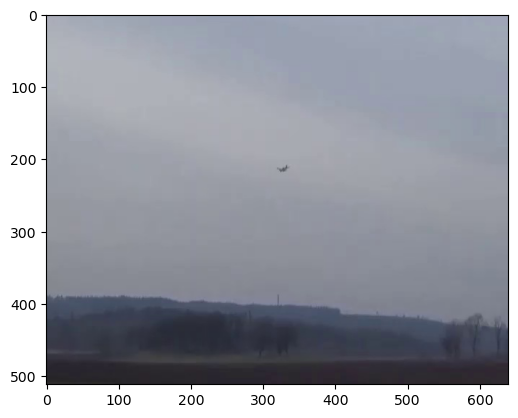

In [13]:
#y[~(y[y.columns[:]] == 0).all(axis =1)]

dir = "/kaggle/working/data/Airplane/3.jpg"
%matplotlib inline
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img = mpimg.imread(dir)
imgplot = plt.imshow(img)
plt.show()

In [3]:
dir = '/kaggle/working'
count =0
for file in os.listdir(dir):
    count = count +1
print(count)

4367


In [11]:
import matplotlib.pyplot as plt
import matplotlib.image as mpimg
img = mpimg.imread('/kaggle/working/data/Airplane/306.jpg')
imgplot = plt.imshow(img)
plt.show()

FileNotFoundError: [Errno 2] No such file or directory: '/kaggle/working/data/Airplane/306.jpg'

In [3]:
#final model code 
import transformers

In [36]:
from transformers import pipeline

checkpoint = "google/owlvit-base-patch32"
detector = pipeline(model=checkpoint, task="zero-shot-object-detection")

Could not find image processor class in the image processor config or the model config. Loading based on pattern matching with the model's feature extractor configuration.


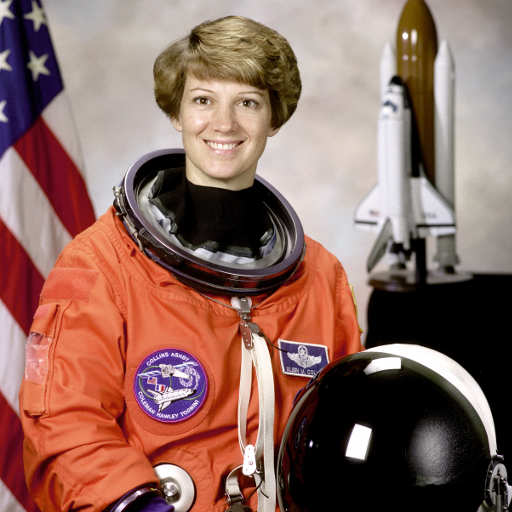

In [37]:
import skimage
import numpy as np
from PIL import Image

image = skimage.data.astronaut()
image = Image.fromarray(np.uint8(image)).convert("RGB")

image

In [44]:
predictions = detector(
    image,
    candidate_labels=["Airplane", "Bird", "nasa badge", "Helicopter"],
)
predictions
#'Airplane','Bird','Drone','Helicopter'

[{'score': 0.2696020305156708,
  'label': 'nasa badge',
  'box': {'xmin': 131, 'ymin': 344, 'xmax': 208, 'ymax': 425}},
 {'score': 0.11271136999130249,
  'label': 'nasa badge',
  'box': {'xmin': 274, 'ymin': 338, 'xmax': 329, 'ymax': 381}}]

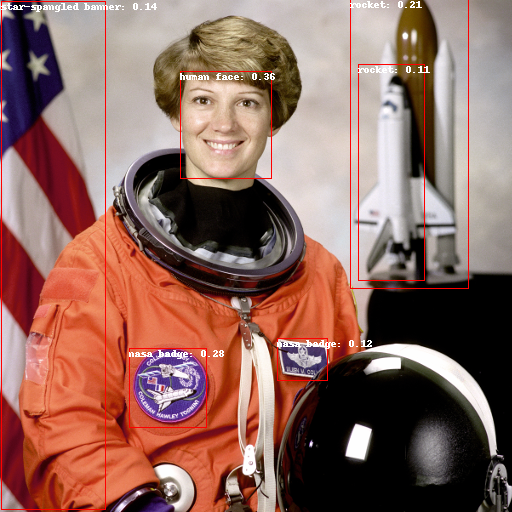

In [40]:
from PIL import ImageDraw

draw = ImageDraw.Draw(image)

for prediction in predictions:
    box = prediction["box"]
    label = prediction["label"]
    score = prediction["score"]

    xmin, ymin, xmax, ymax = box.values()
    draw.rectangle((xmin, ymin, xmax, ymax), outline="red", width=1)
    draw.text((xmin, ymin), f"{label}: {round(score,2)}", fill="white")

image

In [28]:
from transformers import AutoProcessor, AutoModelForZeroShotObjectDetection

model = AutoModelForZeroShotObjectDetection.from_pretrained(checkpoint)
processor = AutoProcessor.from_pretrained(checkpoint)

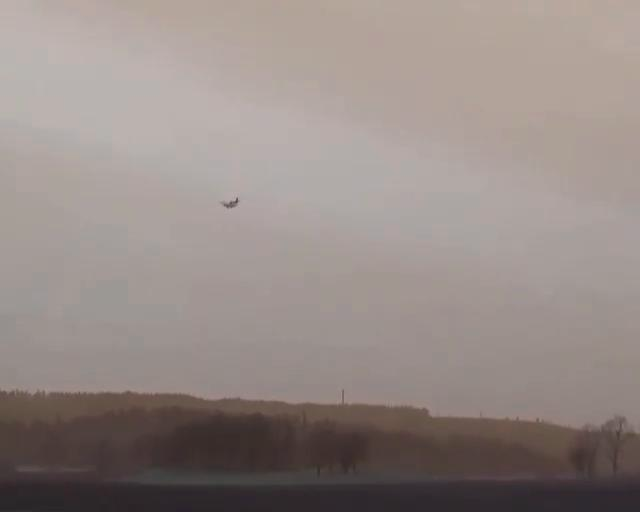

In [29]:
image = cv2.imread('/kaggle/input/samplepesu/Test_data_images/1.jpeg')
image = Image.fromarray(np.uint8(image)).convert("RGB")

image

In [30]:
text_queries = ["airplane", "bird", "drone", "helicopter"]
inputs = processor(text=text_queries, images=im, return_tensors="pt")

In [33]:
import torch

with torch.no_grad():
    outputs = model(**inputs)
    print([im.size[::-1]])
    target_sizes = torch.tensor([im.size[::-1]])
    results = processor.post_process_object_detection(outputs, threshold=0.1, target_sizes=target_sizes)[0]

draw = ImageDraw.Draw(im)

scores = results["scores"].tolist()
labels = results["labels"].tolist()
boxes = results["boxes"].tolist()

for box, score, label in zip(boxes, scores, labels):
    xmin, ymin, xmax, ymax = box
    draw.rectangle((xmin, ymin, xmax, ymax), outline="red", width=1)
    draw.text((xmin, ymin), f"{text_queries[label]}: {round(score,2)}", fill="white")

im

TypeError: 'int' object is not subscriptable

In [2]:
import os
HOME = os.getcwd()
print(HOME)

/kaggle/working


In [3]:
%cd {HOME}
!git clone https://github.com/IDEA-Research/GroundingDINO.git
%cd {HOME}/GroundingDINO
!pip3 install -q -e .
!pip3 install -q roboflow

/kaggle/working
Cloning into 'GroundingDINO'...
remote: Enumerating objects: 273, done.
remote: Counting objects: 100% (47/47), done.
remote: Compressing objects: 100% (30/30), done.
remote: Total 273 (delta 20), reused 19 (delta 17), pack-reused 226
Receiving objects: 100% (273/273), 12.34 MiB | 13.04 MiB/s, done.
Resolving deltas: 100% (124/124), done.
/kaggle/working/GroundingDINO
ERROR: pip's dependency resolver does not currently take into account all the packages that are installed. This behaviour is the source of the following dependency conflicts.
librosa 0.10.0.post2 requires soundfile>=0.12.1, but you have soundfile 0.11.0 which is incompatible.
cloud-tpu-client 0.10 requires google-api-python-client==1.8.0, but you have google-api-python-client 2.83.0 which is incompatible.
apache-beam 2.44.0 requires dill<0.3.2,>=0.3.1.1, but you have dill 0.3.6 which is incompatible.


In [10]:

import os

CONFIG_PATH = os.path.join(HOME, "GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py")
print(CONFIG_PATH, "; exist:", os.path.isfile(CONFIG_PATH))

/kaggle/working/GroundingDINO/groundingdino/config/GroundingDINO_SwinT_OGC.py ; exist: True


In [4]:

%cd {HOME}
!mkdir {HOME}/weights
%cd {HOME}/weights

!wget -q https://github.com/IDEA-Research/GroundingDINO/releases/download/v0.1.0-alpha/groundingdino_swint_ogc.pth

/kaggle/working
/kaggle/working/weights


In [5]:
import os

WEIGHTS_NAME = "groundingdino_swint_ogc.pth"
WEIGHTS_PATH = os.path.join(HOME, "weights", WEIGHTS_NAME)
print(WEIGHTS_PATH, "; exist:", os.path.isfile(WEIGHTS_PATH))

/kaggle/working/weights/groundingdino_swint_ogc.pth ; exist: True


In [8]:

%cd {HOME}
!mkdir {HOME}/data
%cd {HOME}/data

!wget -q https://media.roboflow.com/notebooks/examples/dog.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-2.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-3.jpeg
!wget -q https://media.roboflow.com/notebooks/examples/dog-4.jpeg

/kaggle/working
/kaggle/working/data


In [11]:

%cd {HOME}/GroundingDINO

from groundingdino.util.inference import load_model, load_image, predict, annotate

model = load_model(CONFIG_PATH, WEIGHTS_PATH)

/kaggle/working/GroundingDINO


/opt/conda/lib/python3.7/site-packages/torch/functional.py:504: UserWarning: torch.meshgrid: in an upcoming release, it will be required to pass the indexing argument. (Triggered internally at /usr/local/src/pytorch/aten/src/ATen/native/TensorShape.cpp:3190.)
  return _VF.meshgrid(tensors, **kwargs)  # type: ignore[attr-defined]


final text_encoder_type: bert-base-uncased


Some weights of the model checkpoint at bert-base-uncased were not used when initializing BertModel: ['cls.predictions.transform.dense.weight', 'cls.predictions.transform.LayerNorm.weight', 'cls.predictions.transform.dense.bias', 'cls.predictions.bias', 'cls.seq_relationship.weight', 'cls.predictions.transform.LayerNorm.bias', 'cls.predictions.decoder.weight', 'cls.seq_relationship.bias']
- This IS expected if you are initializing BertModel from the checkpoint of a model trained on another task or with another architecture (e.g. initializing a BertForSequenceClassification model from a BertForPreTraining model).
- This IS NOT expected if you are initializing BertModel from the checkpoint of a model that you expect to be exactly identical (initializing a BertForSequenceClassification model from a BertForSequenceClassification model).


In [21]:
imgTestDatasetDir = '/kaggle/input/samplepesu/Test_data_images'
import csv
def getPredictionString(image):
    img = cv2.imread(imgTestDatasetDir+'/'+image)    
    img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB).astype(np.float32)
    img /= 255.0
    img = torchvision.transforms.functional.to_tensor(img)
    with torch.no_grad():
        prediction = model([img.to(device)])[0]
    prediction_cpu = {
    'boxes': prediction['boxes'].cpu(),
    'labels': prediction['labels'].cpu(),
    'scores': prediction['scores'].cpu()
    }
    print(image)
    plot_img_bbox(torch_to_pil(img), prediction_cpu)
    df = pd.DataFrame(columns=['Test Image', 'Prediction string'])
    nms_prediction = apply_nms(prediction_cpu, iou_thresh=0.2)
    df['Test Image'] = image
    predString = ''
    for i in range(len(nms_prediction['labels'])):
        predString += '{'+'{0} {1} {2} {3} {4} {5}'.format(nms_prediction['labels'][i], nms_prediction['scores'][i], int(nms_prediction['boxes'][i][0]), int(nms_prediction['boxes'][i][1]), int(nms_prediction['boxes'][i][2] - nms_prediction['boxes'][i][0]), int(nms_prediction['boxes'][i][3] - nms_prediction['boxes'][i][1]))+'}'
    if predString == '':
        predString = '{}'
    return predString

mmnpDF = None
mmnpDF = pd.DataFrame(columns=['Test Image','Prediction string'])
mmnpDF['Test Image'] = os.listdir(imgTestDatasetDir)
mmnpDF['Test Image'] = mmnpDF['Test Image'].apply(lambda x: x.split('.')[0])
mmnpDF['Test Image'] = mmnpDF['Test Image'].apply(lambda x: int(x))
mmnpDF = mmnpDF.sort_values(by=['Test Image'])
mmnpDF['Test Image'] = mmnpDF['Test Image'].apply(lambda x: str(x)+'.jpeg')

mmnpDF['Prediction string'] = mmnpDF['Test Image'].apply(lambda x: getPredictionString(x))

mmnpDF = mmnpDF.reset_index(drop=True)


print(mmnpDF.head())
mmnpDF.to_csv('results.csv', index=False)

NameError: name 'cv2' is not defined

In [27]:
import cv2

im = cv2.imread('/kaggle/input/samplepesu/Test_data_images/1.jpeg')

print(type(im))
# <class 'numpy.ndarray'>

print(im.shape)
print(type(im.shape))
#512 height , 640 width

<class 'numpy.ndarray'>
(512, 640, 3)
<class 'tuple'>


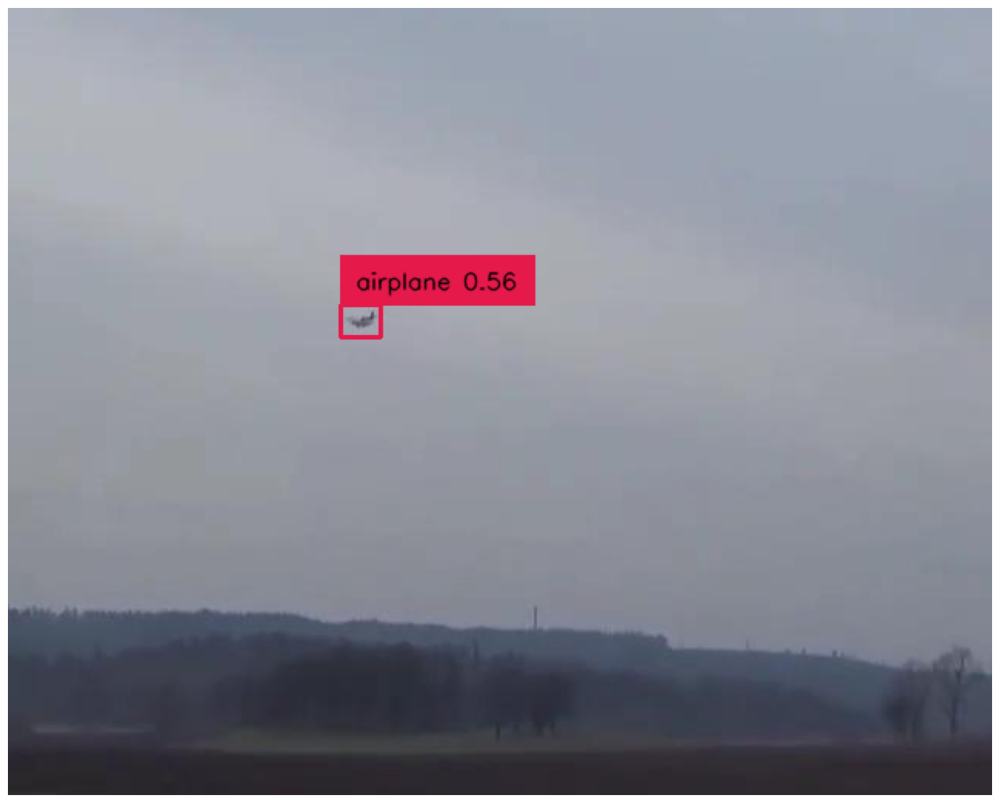

1.jpeg
229.3846893310547 203.8033447265625 26.473994255065918 20.913068771362305


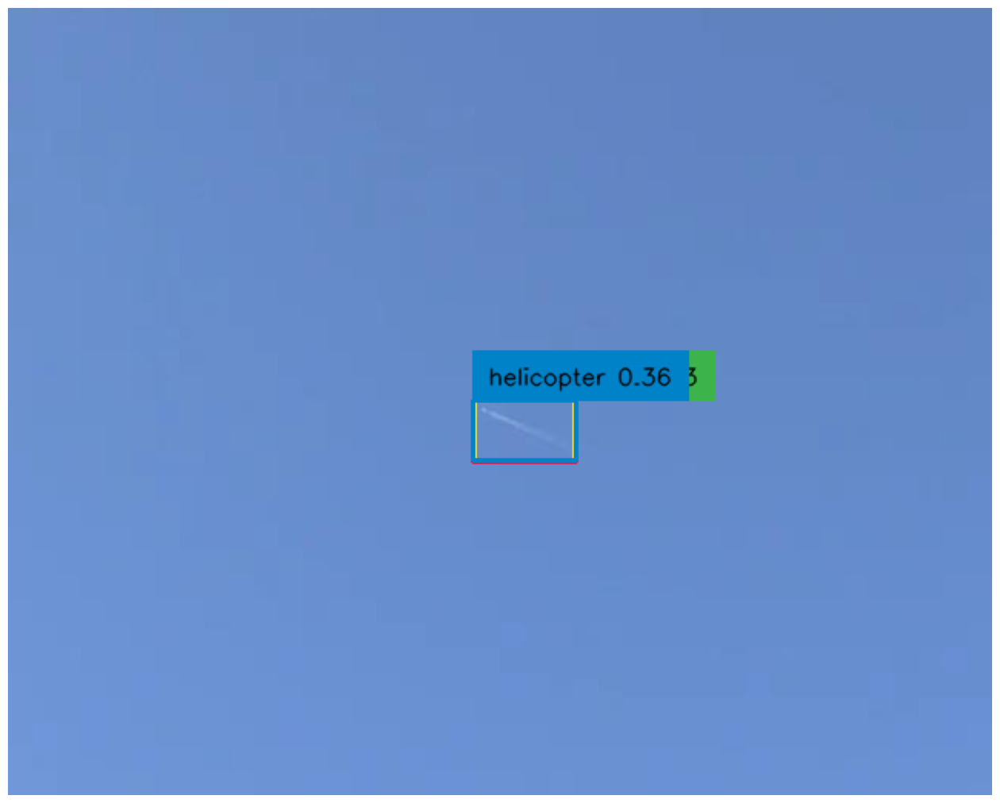

2.jpeg
336.10286712646484 275.29559326171875 66.21427536010742 39.103851318359375


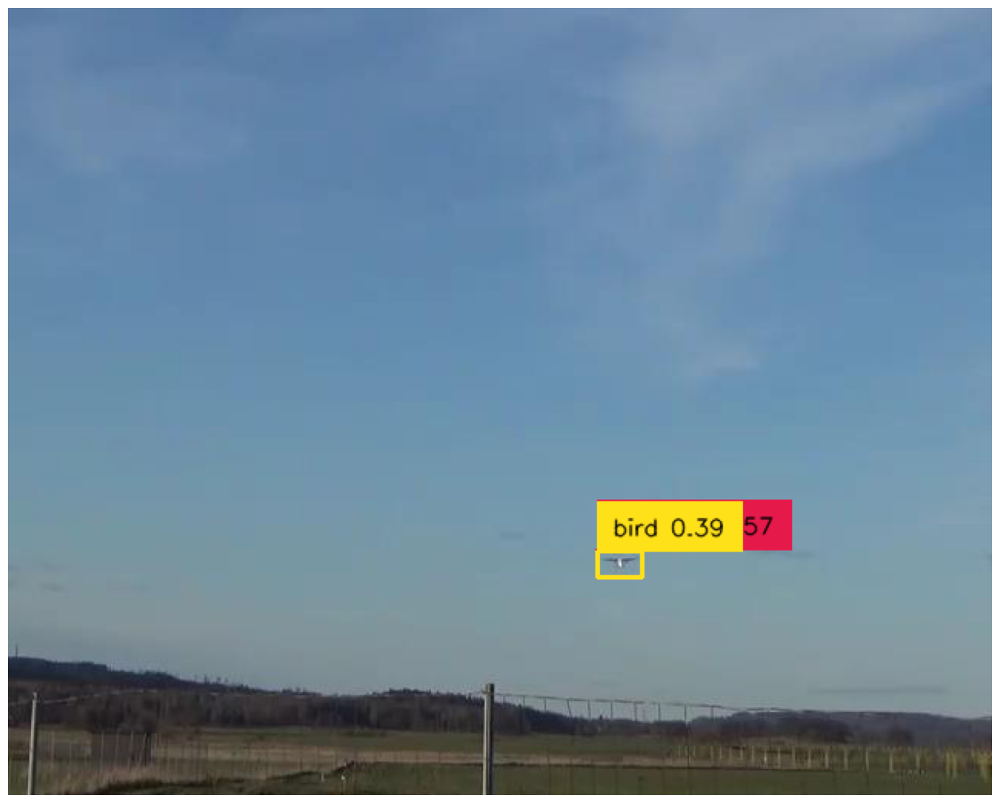

3.jpeg
397.93033599853516 361.6403503417969 28.705828189849854 17.414995193481445


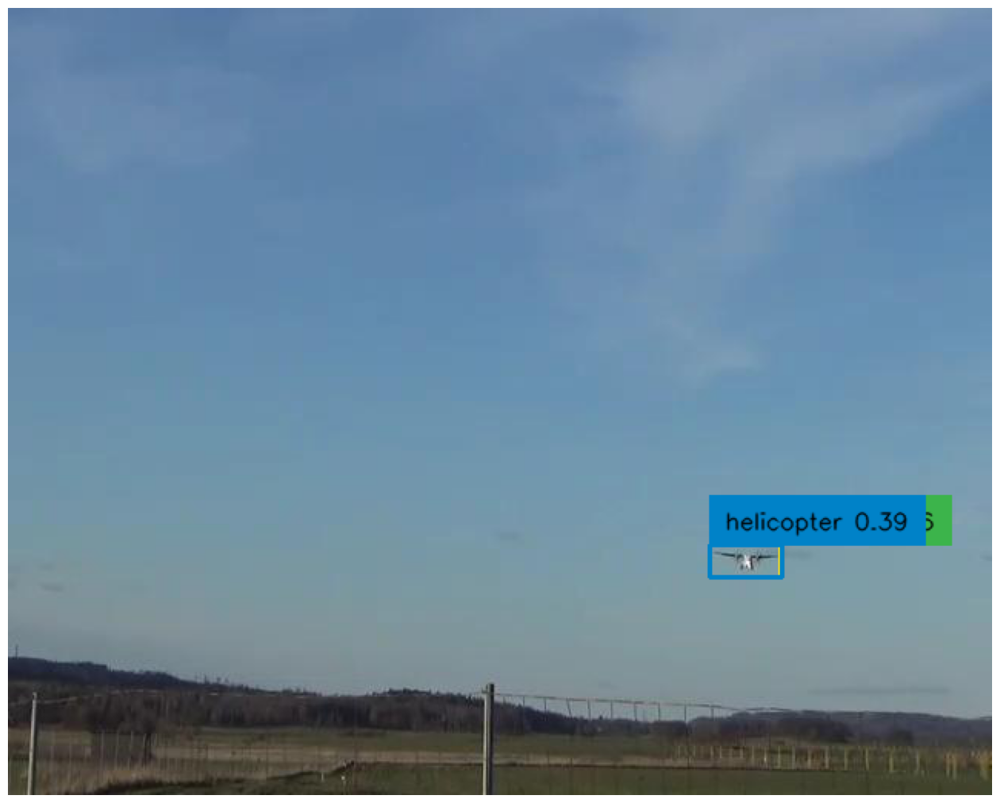

4.jpeg
479.59022521972656 359.8416442871094 46.78891658782959 21.28076171875


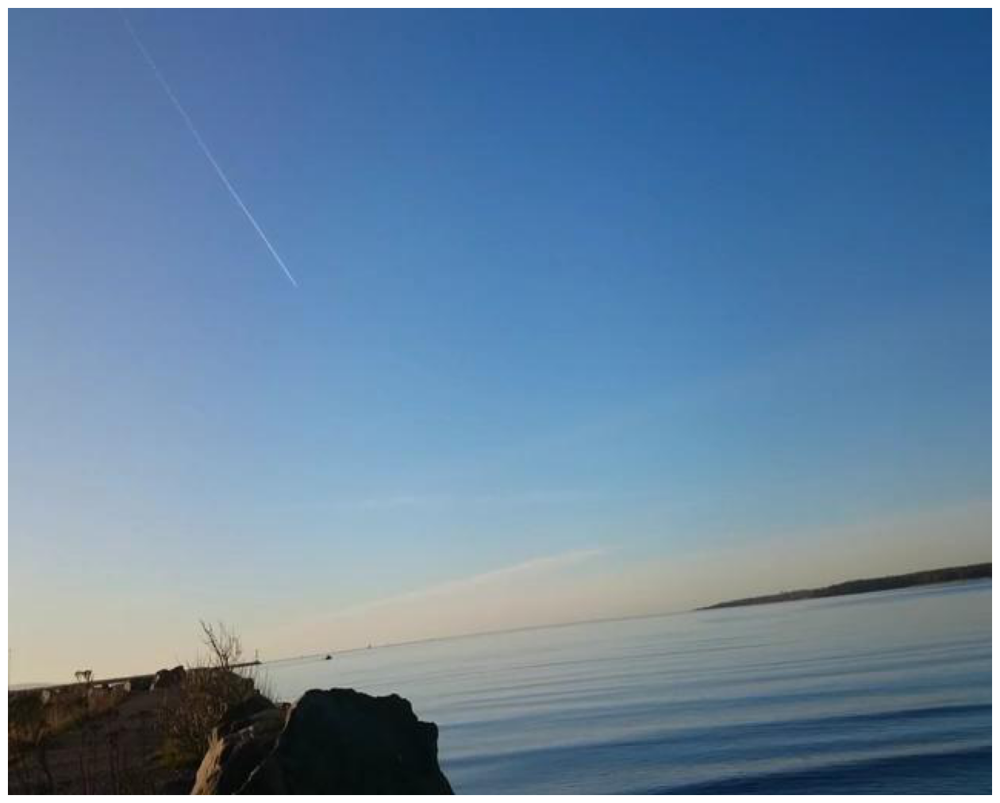

5.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


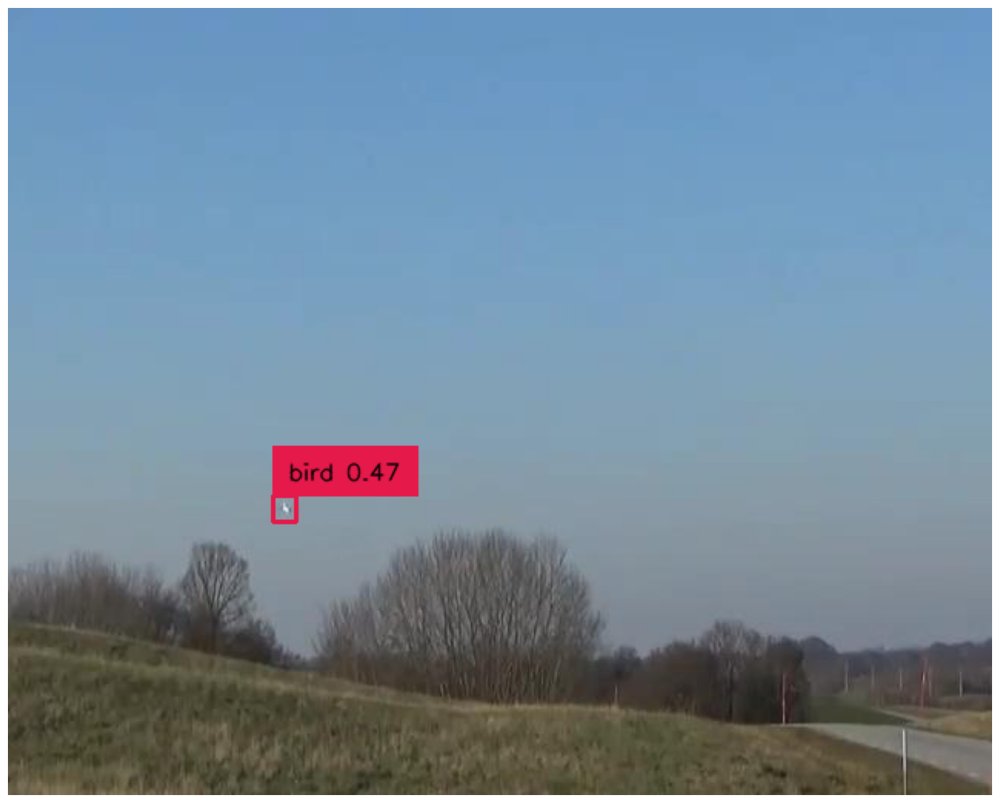

6.jpeg
180.0896453857422 326.1466064453125 14.581241607666016 16.58745765686035


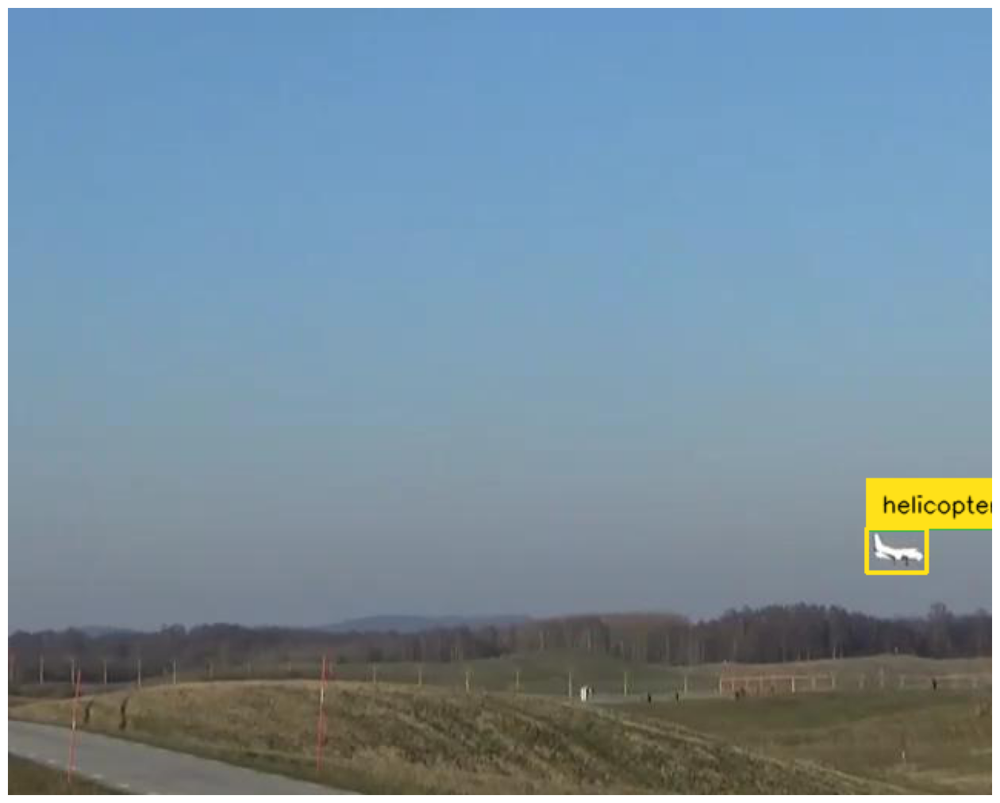

7.jpeg
578.0054092407227 353.1187744140625 39.81823444366455 28.835641860961914


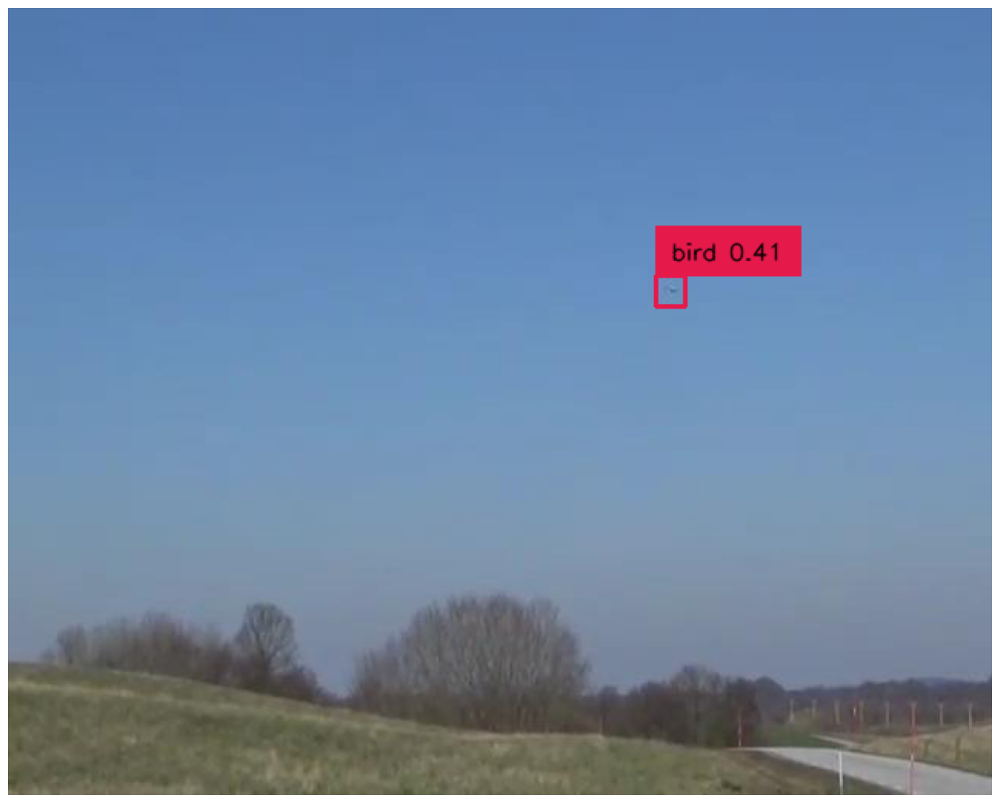

8.jpeg
430.93040466308594 184.2404327392578 19.482446908950806 19.739742279052734


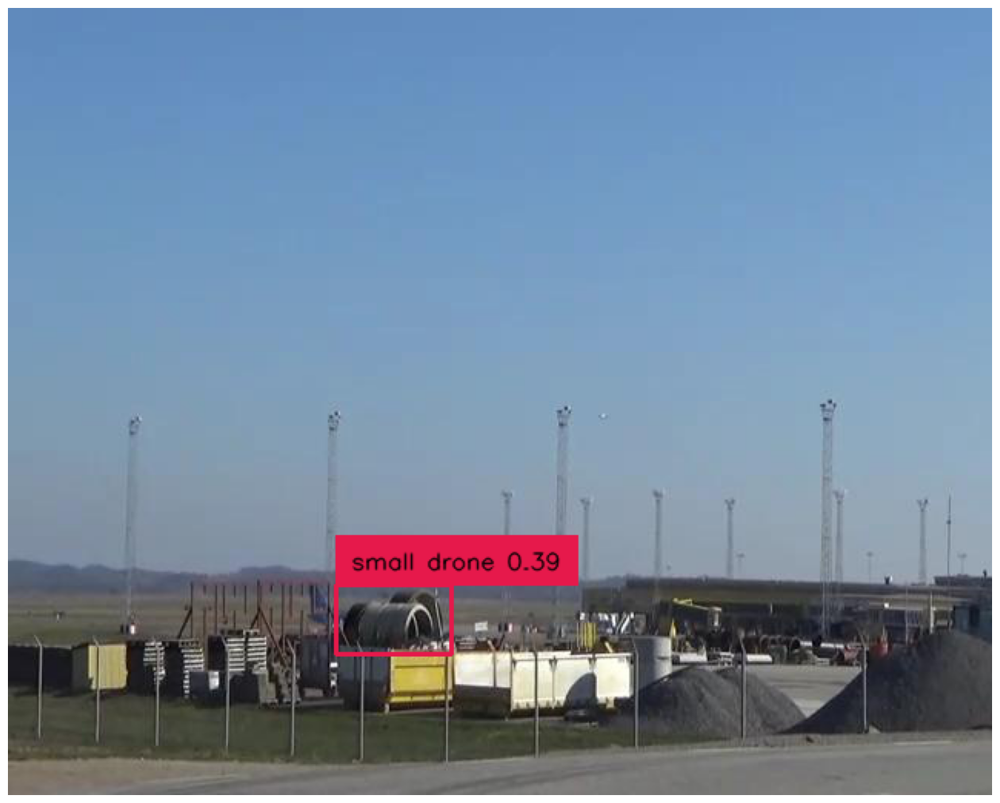

9.jpeg
250.67876815795898 398.079833984375 74.97188568115234 44.71011734008789


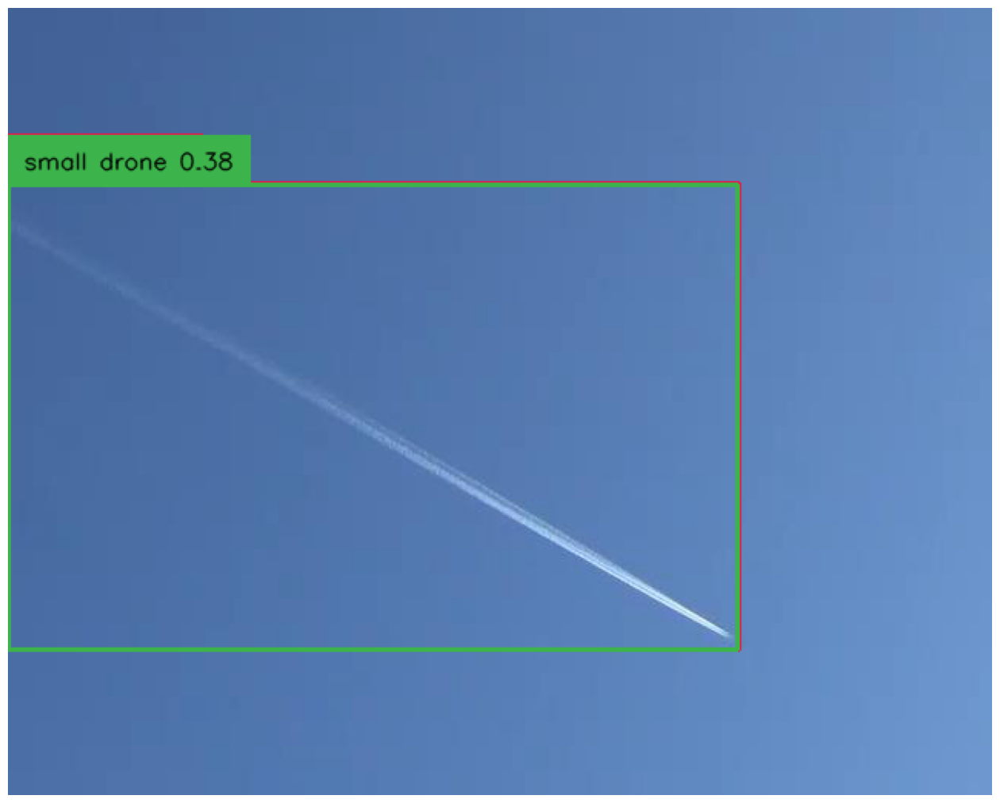

10.jpeg
237.61507034301758 266.0361022949219 475.0907897949219 302.55694580078125


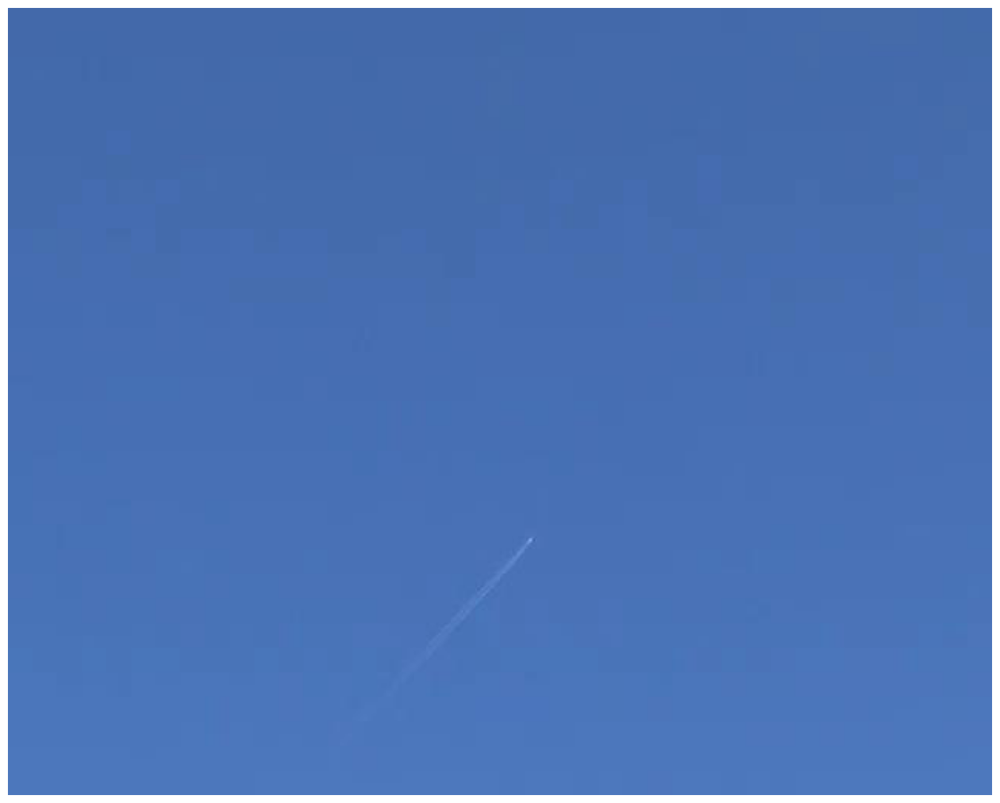

11.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


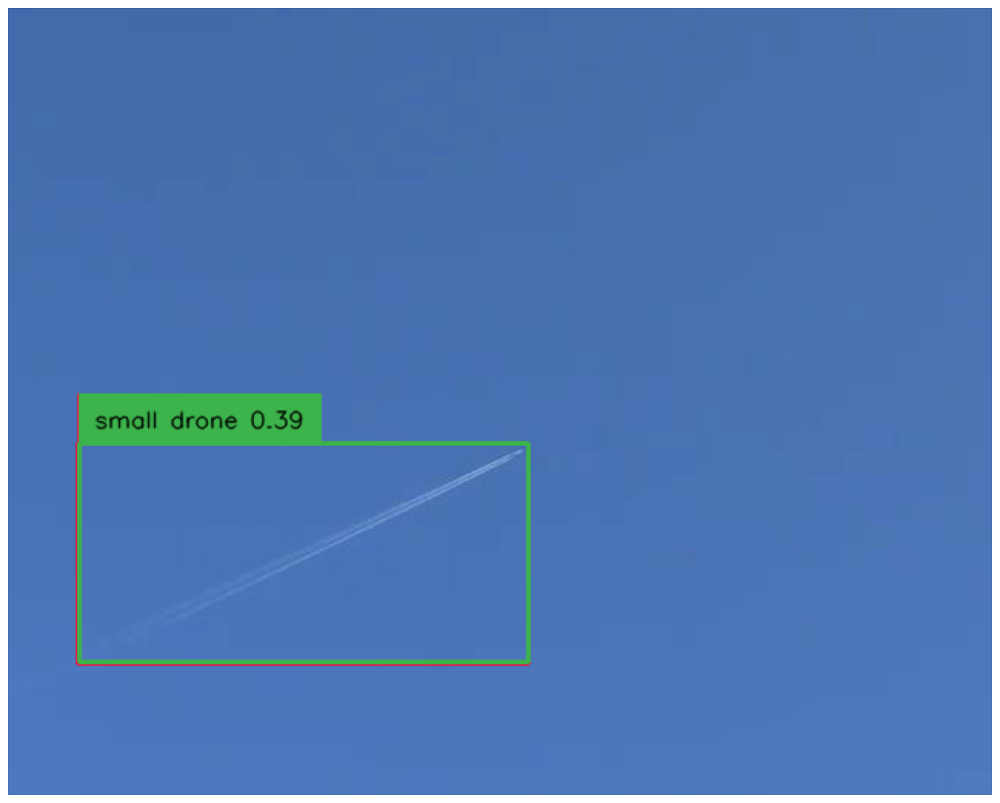

12.jpeg
192.56908416748047 354.5335693359375 291.8778610229492 142.55982971191406


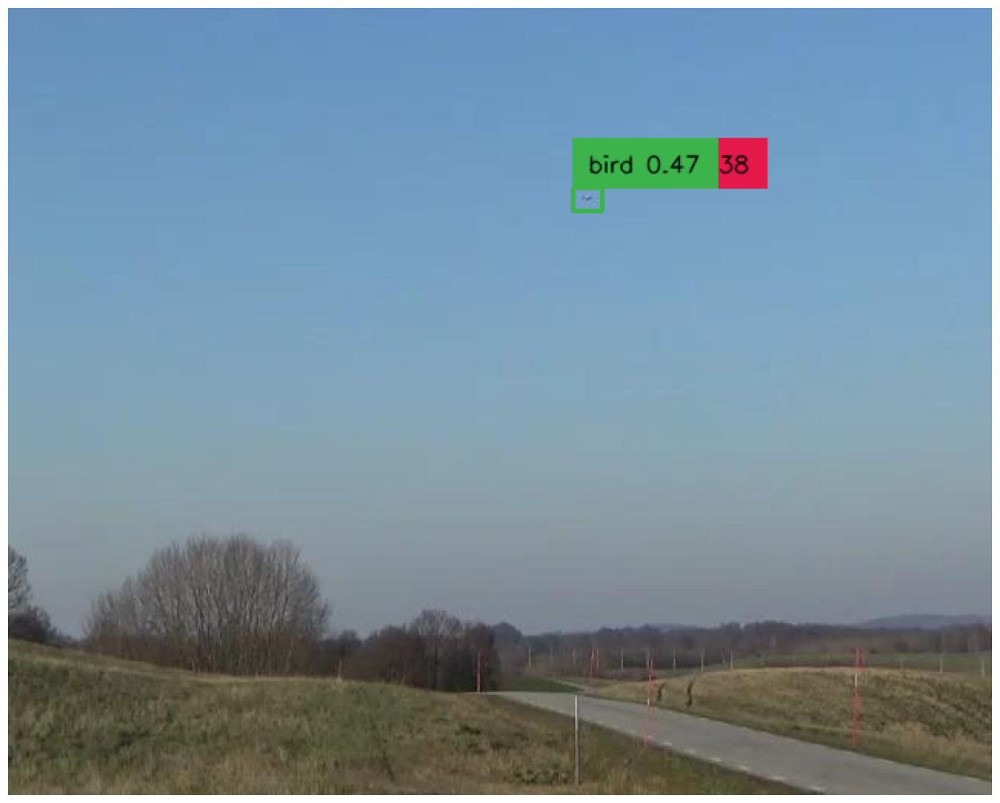

13.jpeg
377.0806884765625 124.85404968261719 18.303301334381104 14.478901863098145


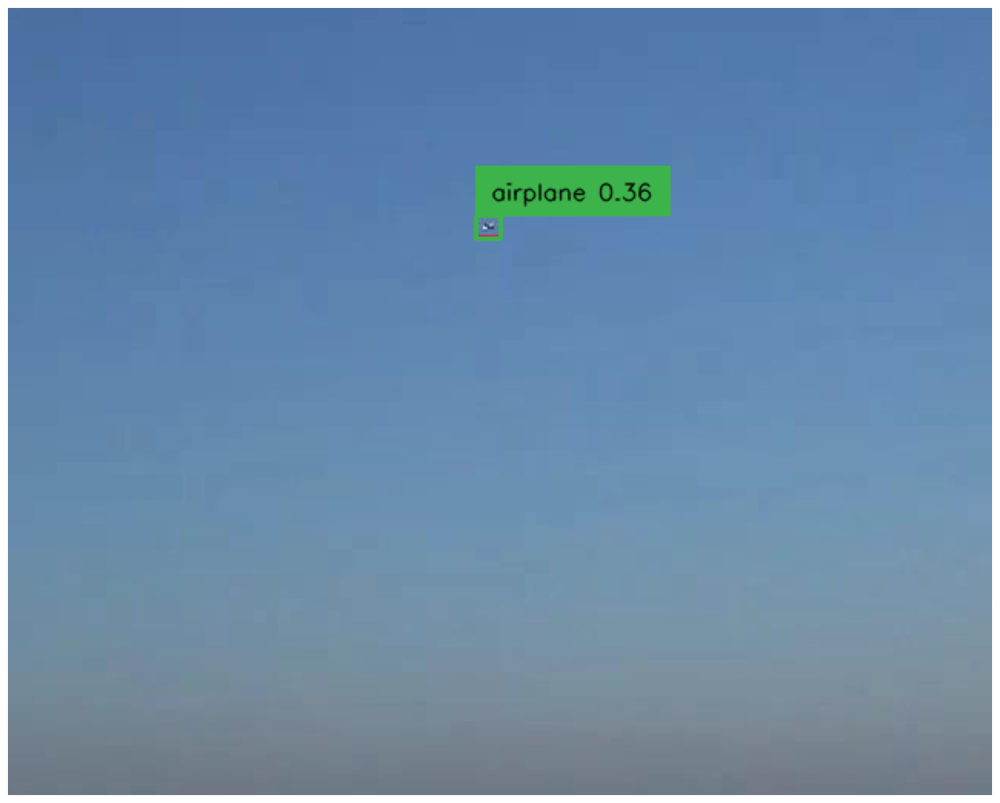

14.jpeg
312.383975982666 142.55690002441406 16.026171445846558 14.605792999267578


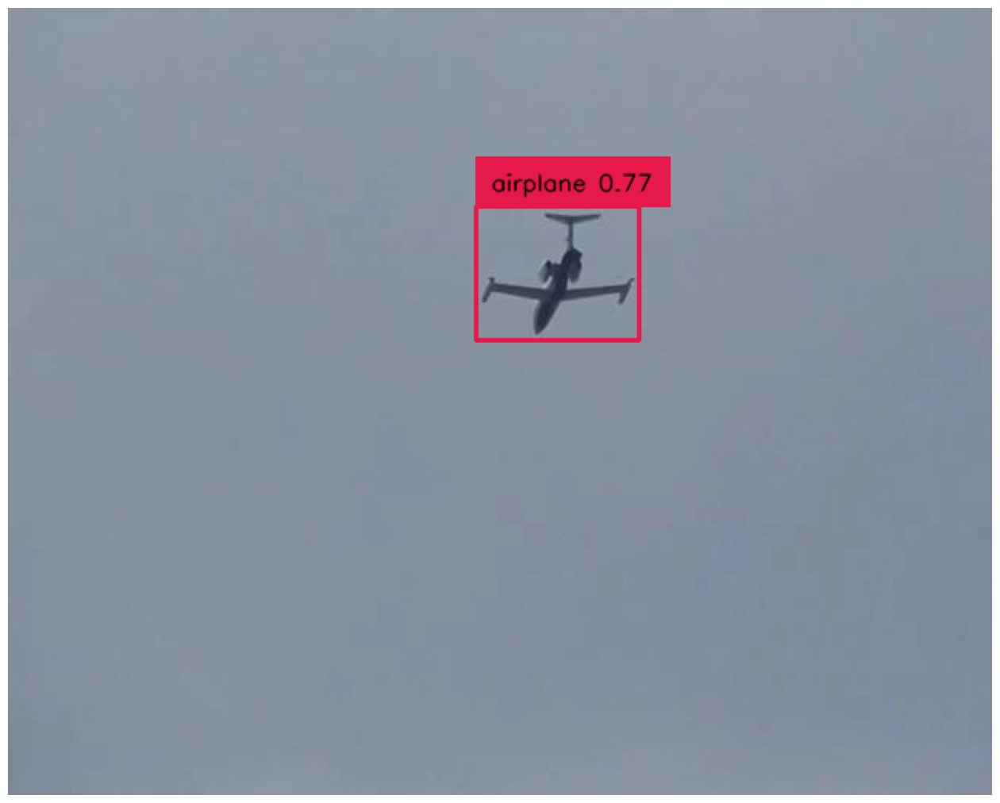

15.jpeg
357.32215881347656 172.96340942382812 105.55683135986328 86.58563995361328


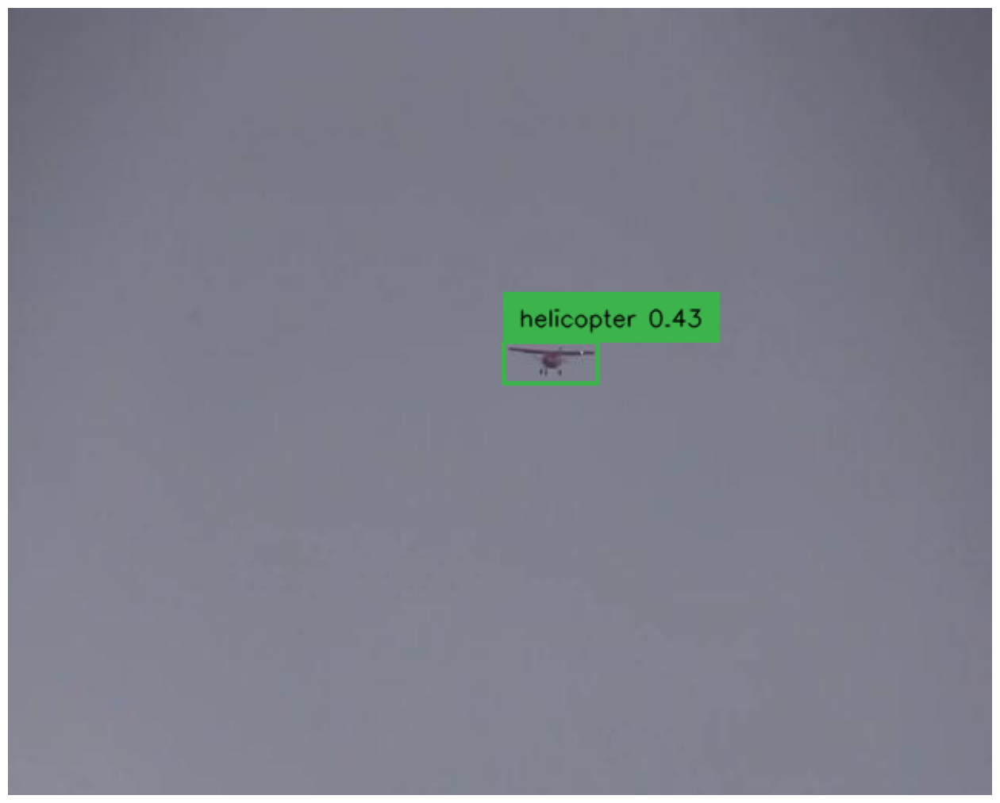

16.jpeg
352.91378021240234 230.75274658203125 61.62363529205322 26.728103637695312


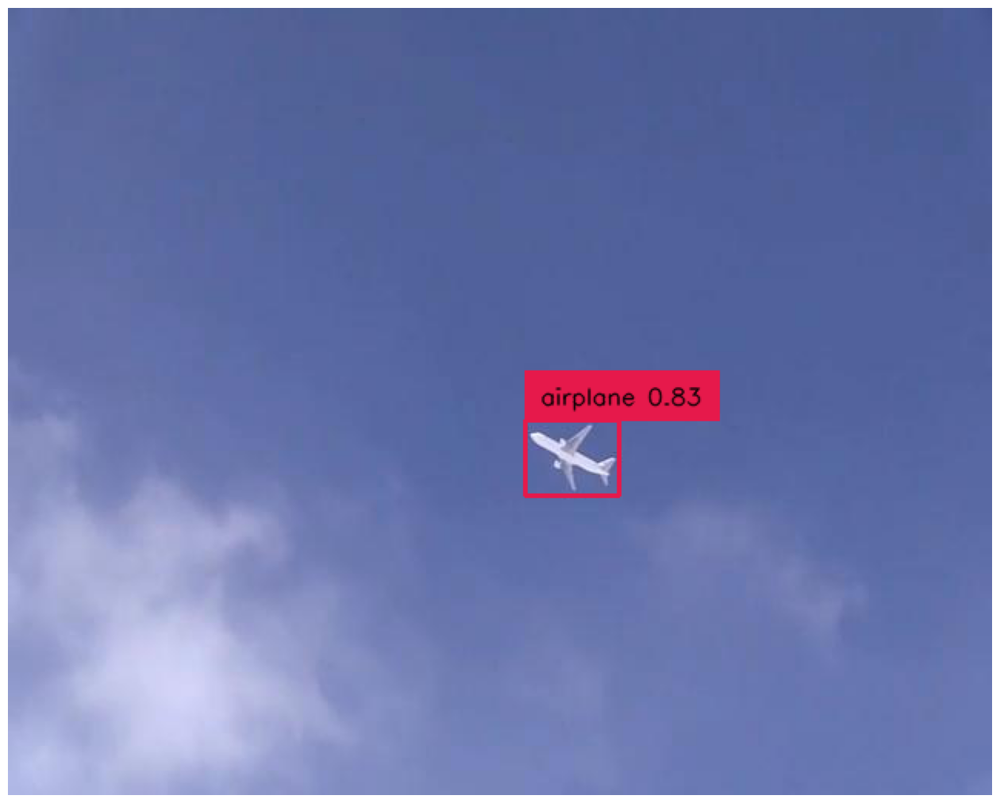

17.jpeg
367.0830535888672 293.35296630859375 61.79567337036133 49.1173095703125


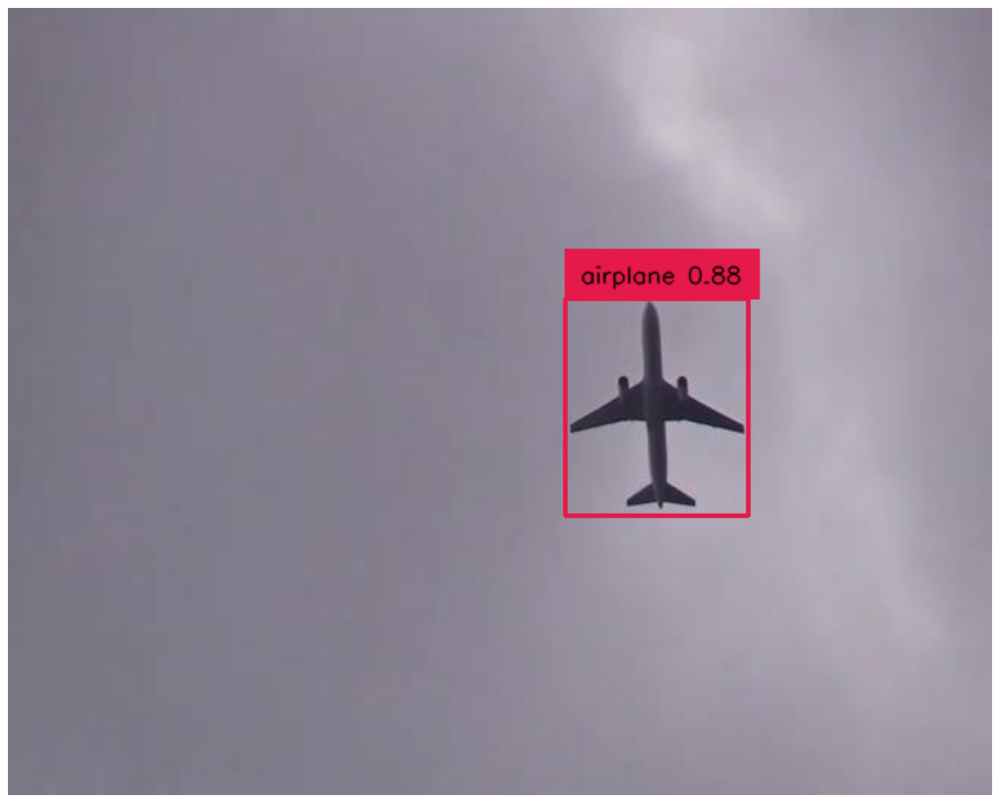

18.jpeg
421.8525695800781 259.68402099609375 118.72005462646484 141.30079650878906


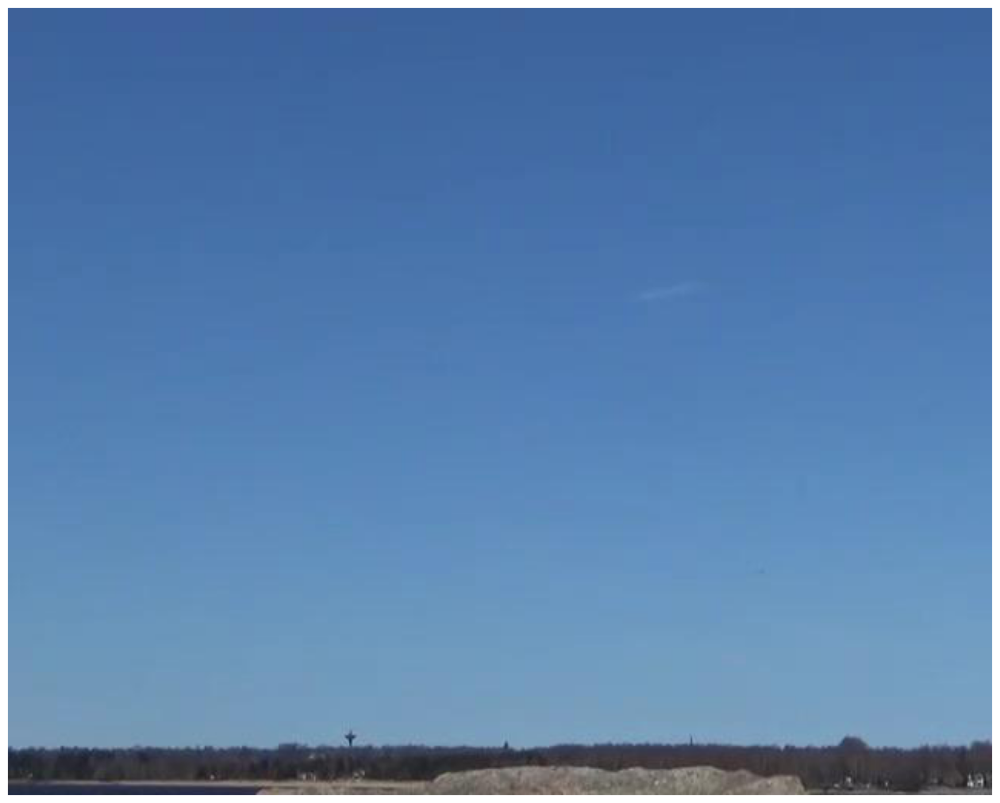

19.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


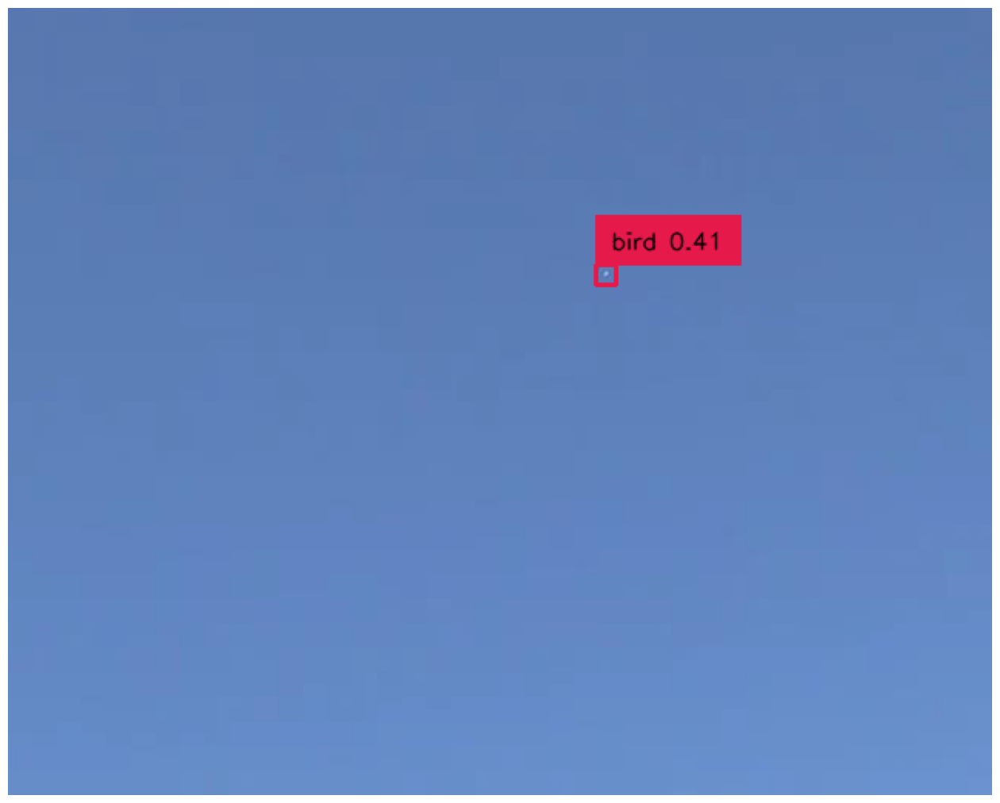

20.jpeg
388.6955261230469 173.75537109375 12.704167366027832 13.02704906463623


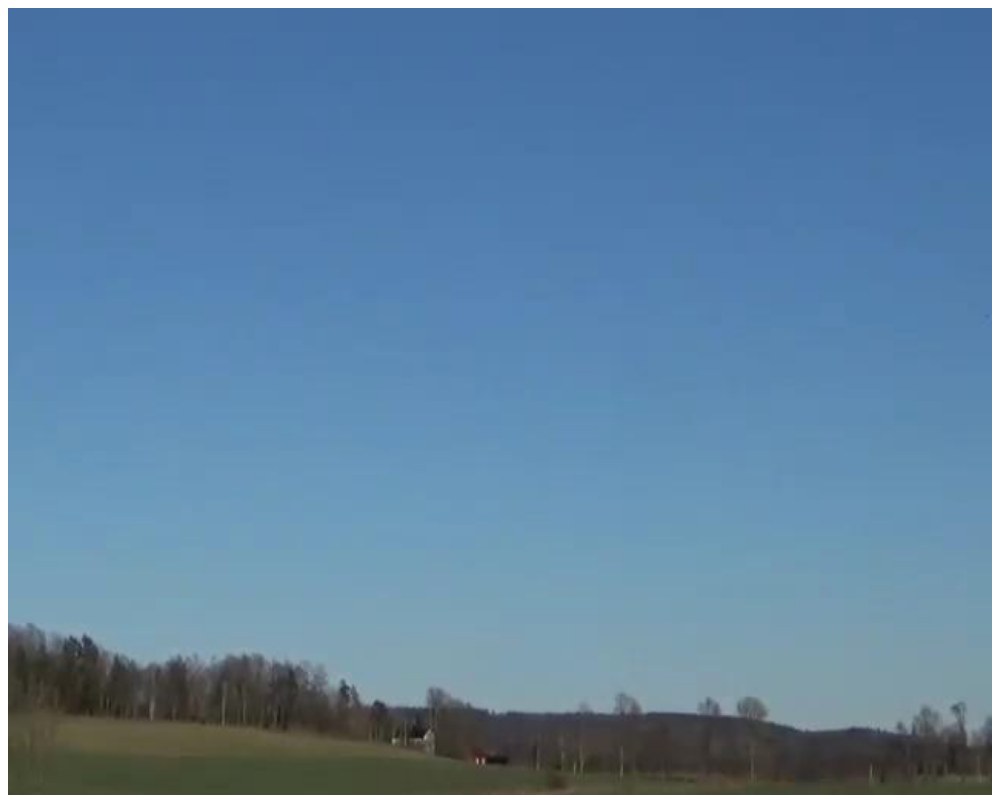

21.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


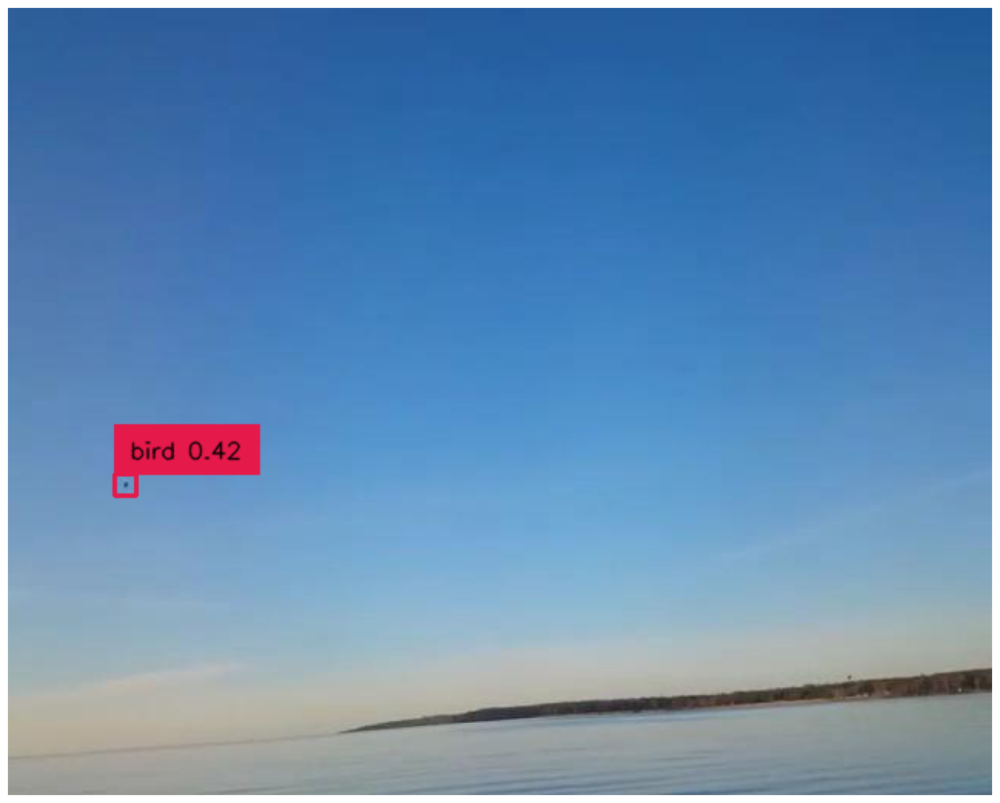

22.jpeg
76.41244411468506 310.8014221191406 13.471635580062866 13.734450340270996


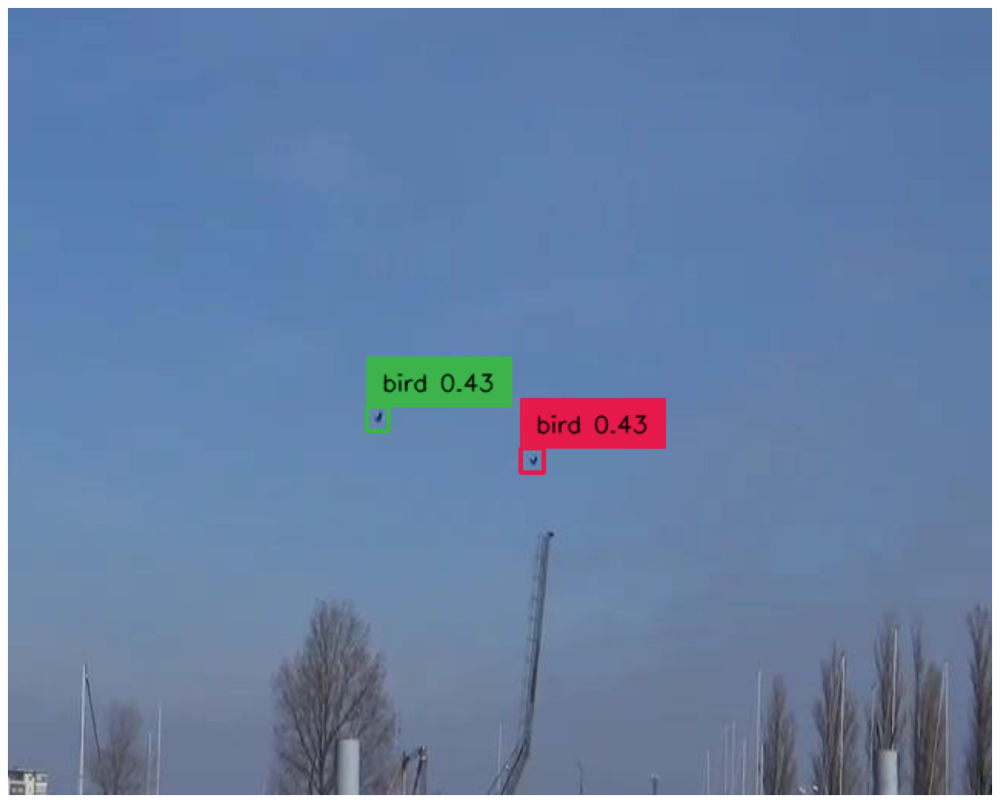

23.jpeg
240.8070945739746 267.1794738769531 13.983947038650513 15.852680206298828


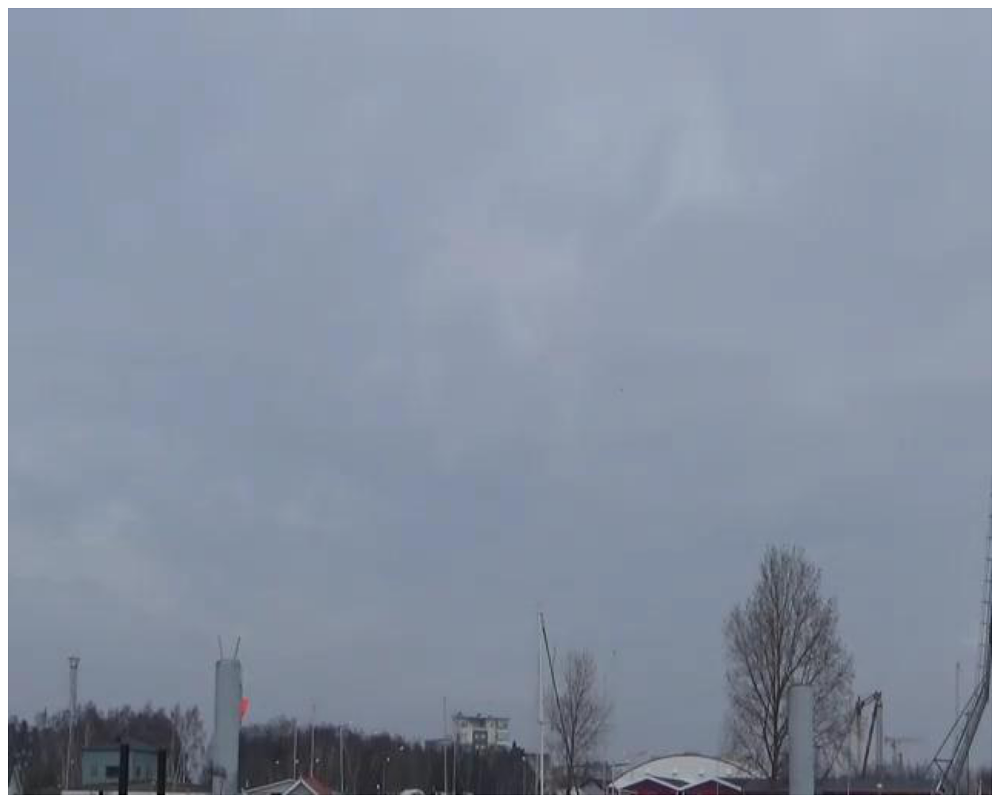

24.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


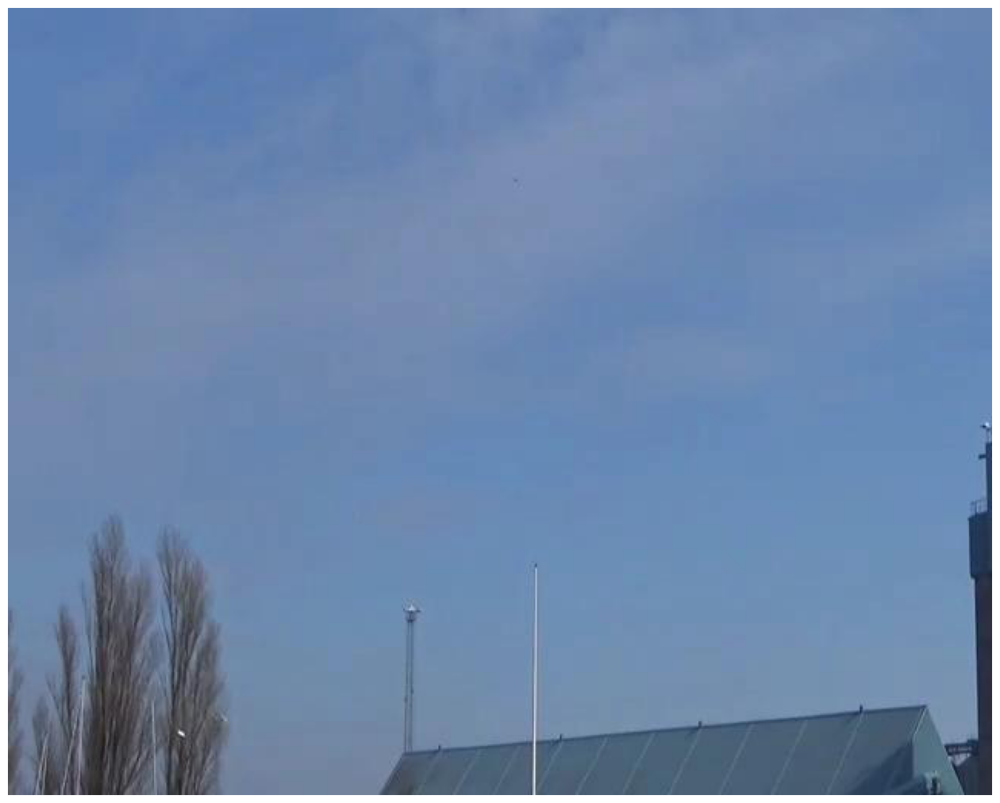

25.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


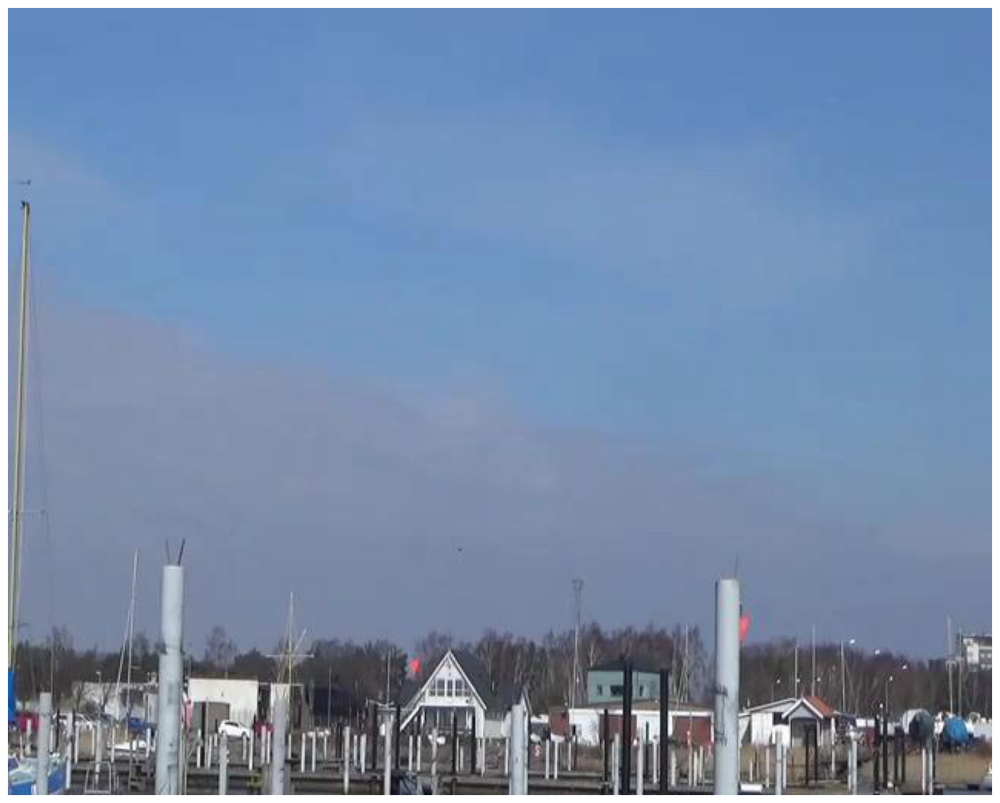

26.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


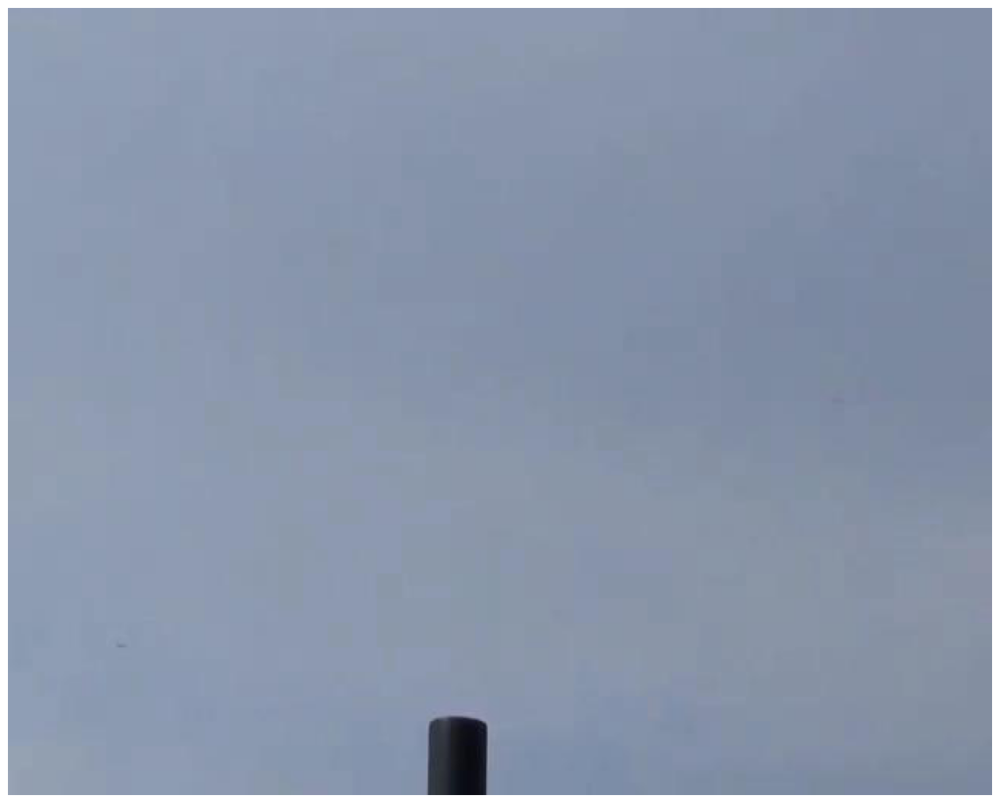

27.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


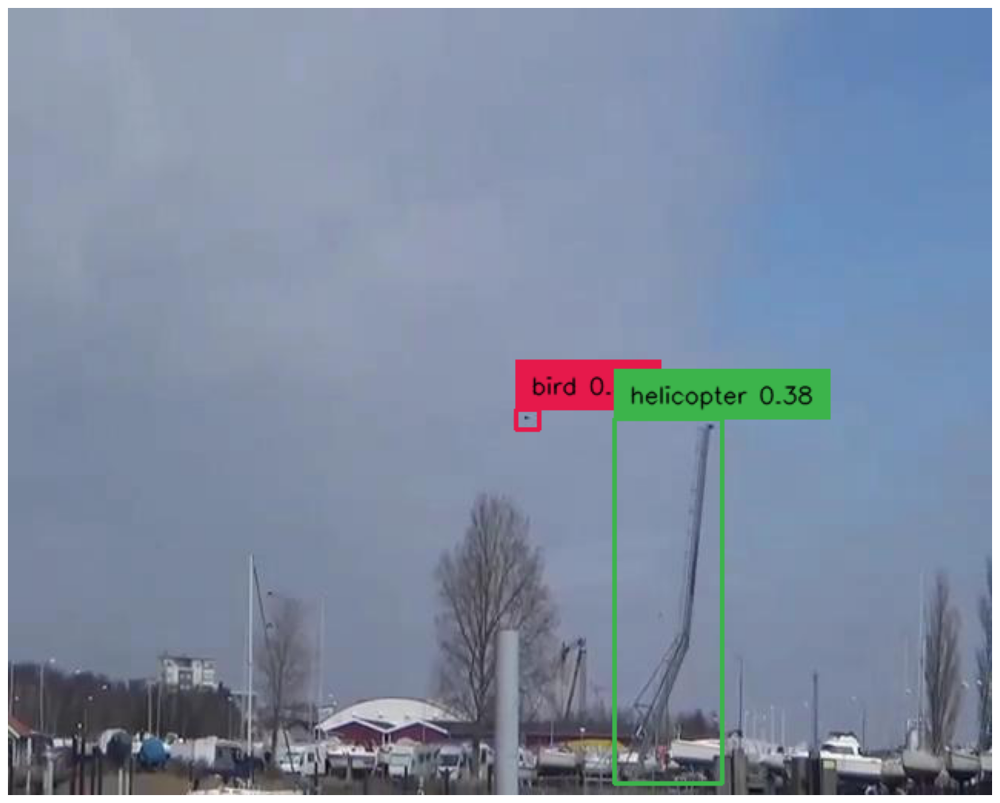

28.jpeg
429.4099426269531 385.79437255859375 69.9681568145752 236.87196350097656


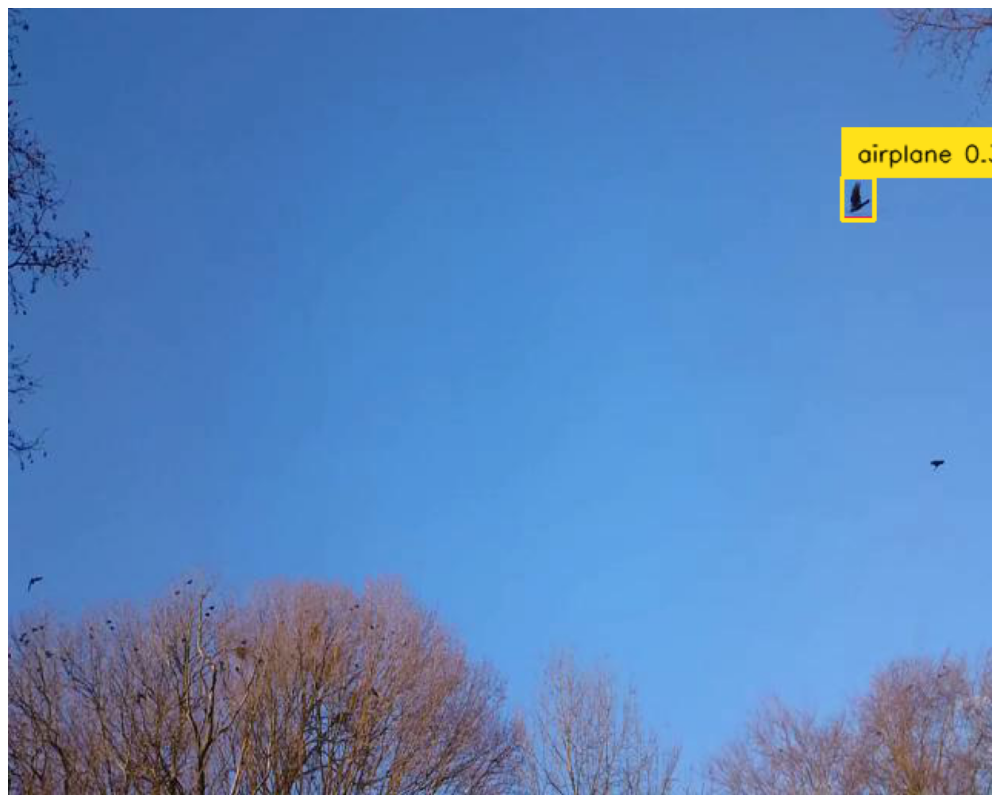

29.jpeg
552.9077911376953 124.43072509765625 20.35572052001953 27.050613403320312


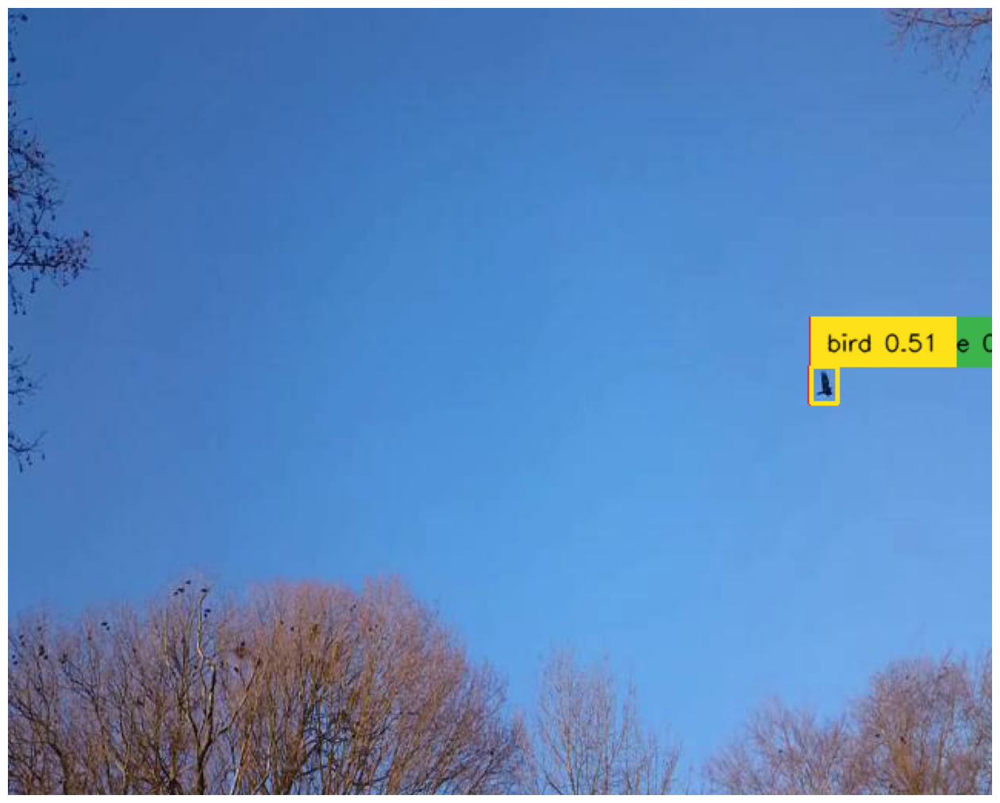

30.jpeg
530.8897018432617 245.80453491210938 17.56839871406555 24.00417137145996


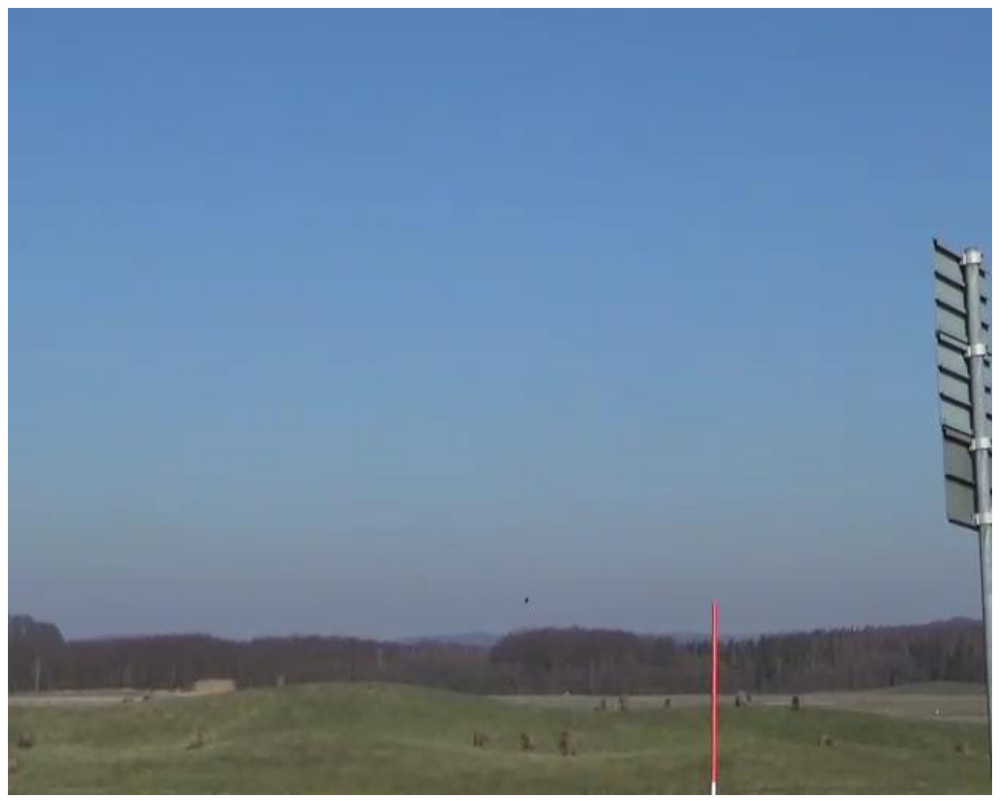

31.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


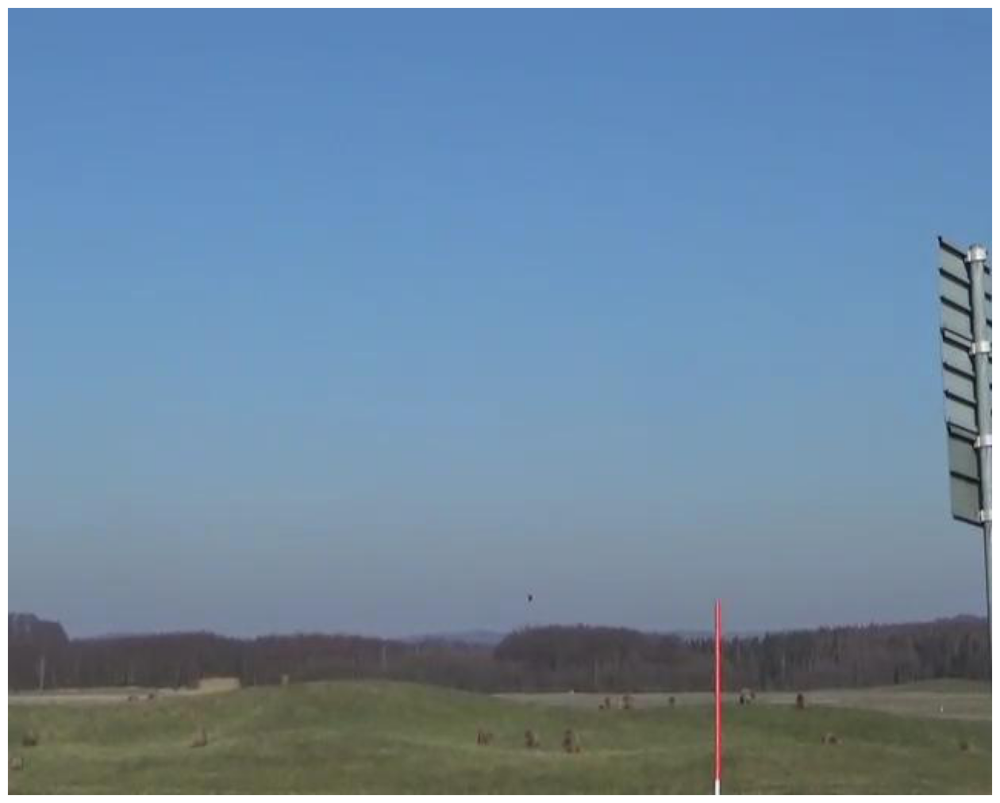

32.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


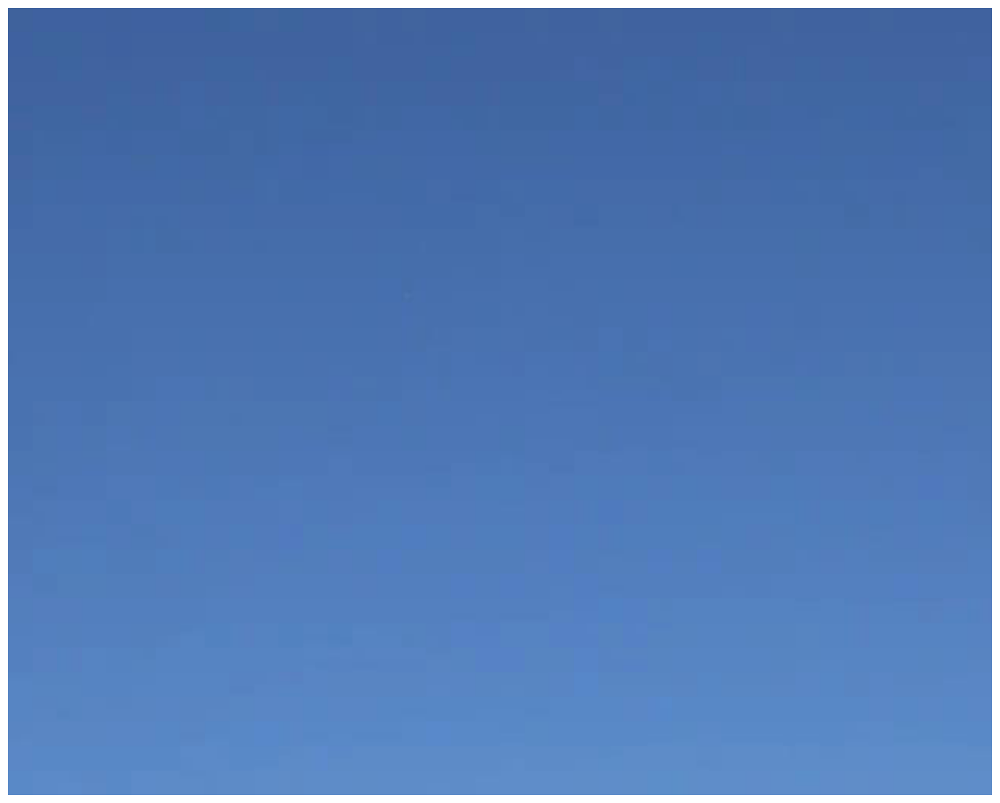

33.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


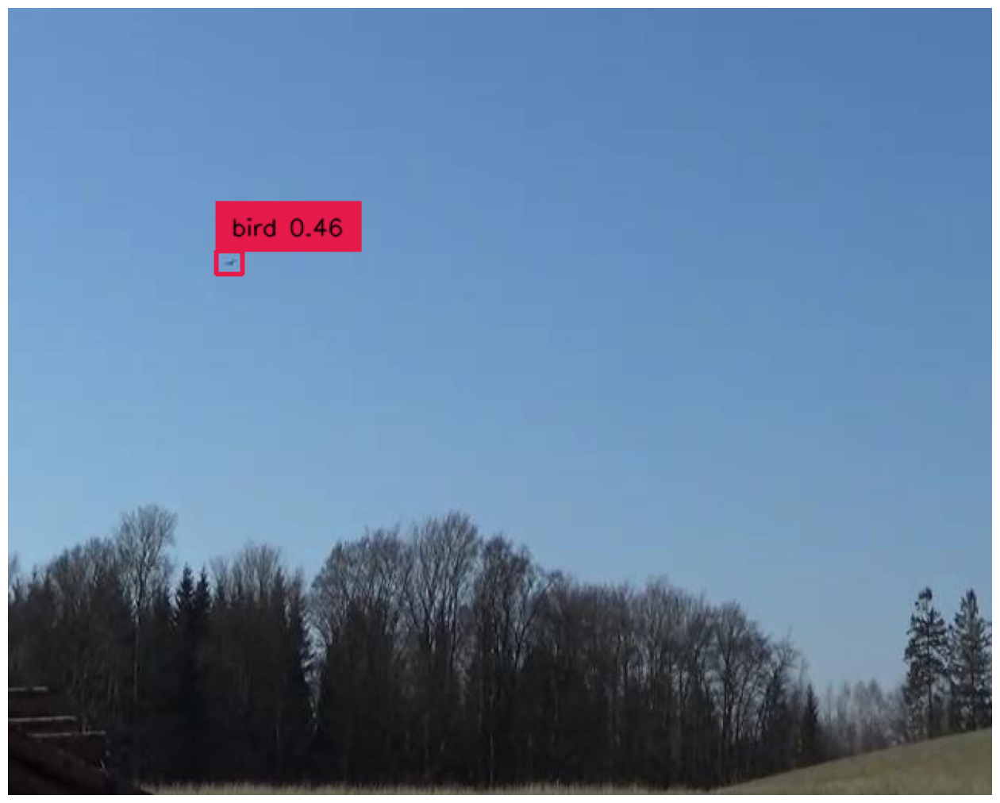

34.jpeg
144.3174648284912 166.3133544921875 16.962692737579346 14.976052284240723


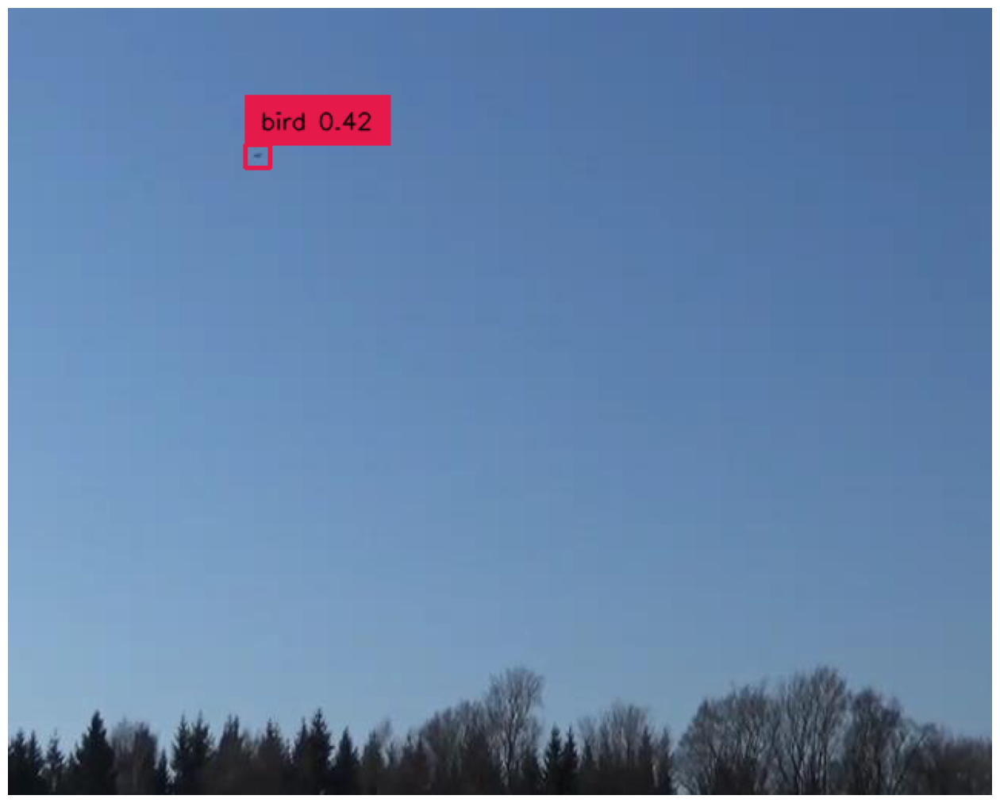

35.jpeg
162.1586799621582 97.19345092773438 16.097838878631592 14.451896667480469


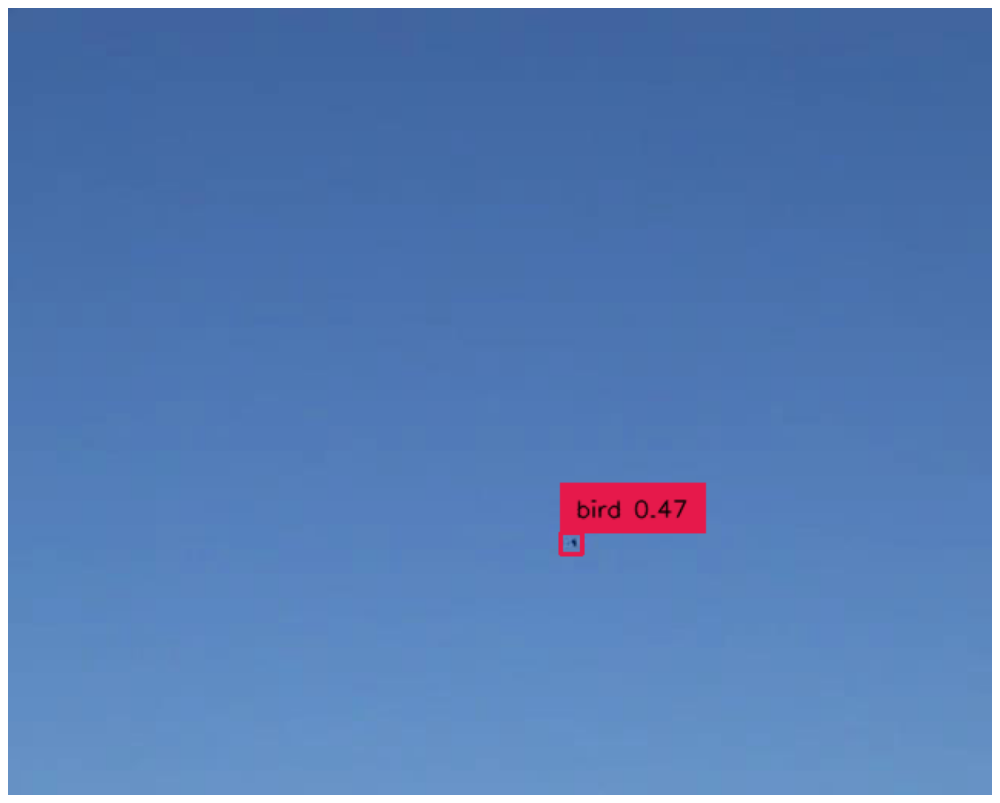

36.jpeg
366.9013214111328 348.6817626953125 14.003034830093384 13.811625480651855


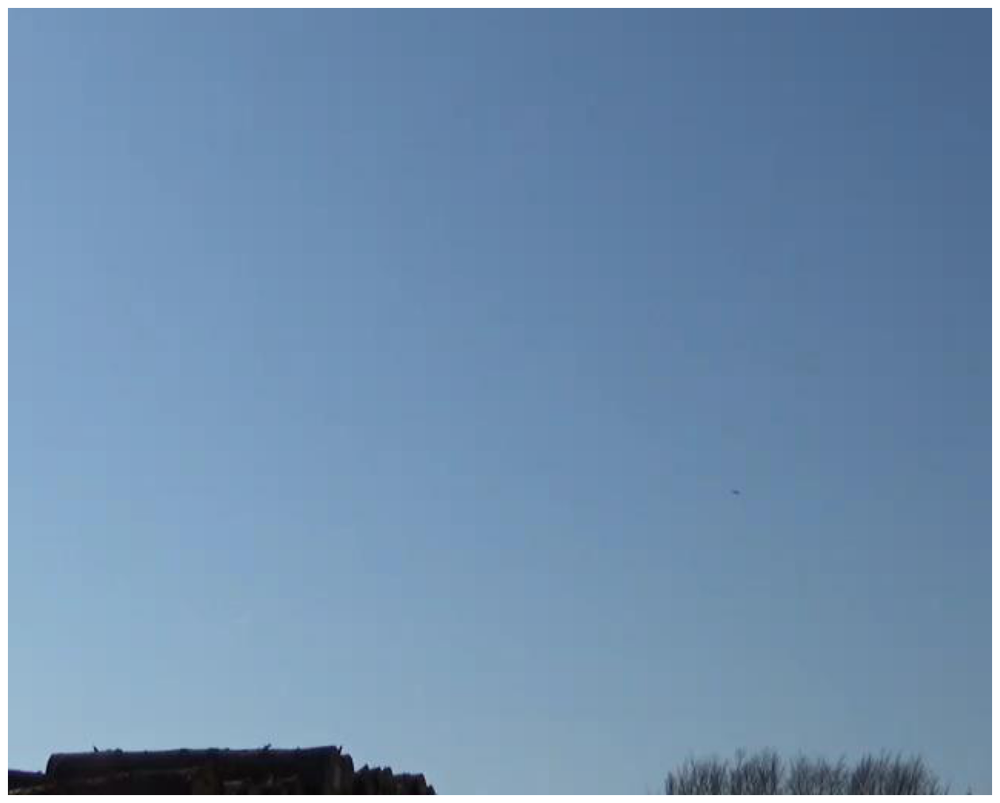

37.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


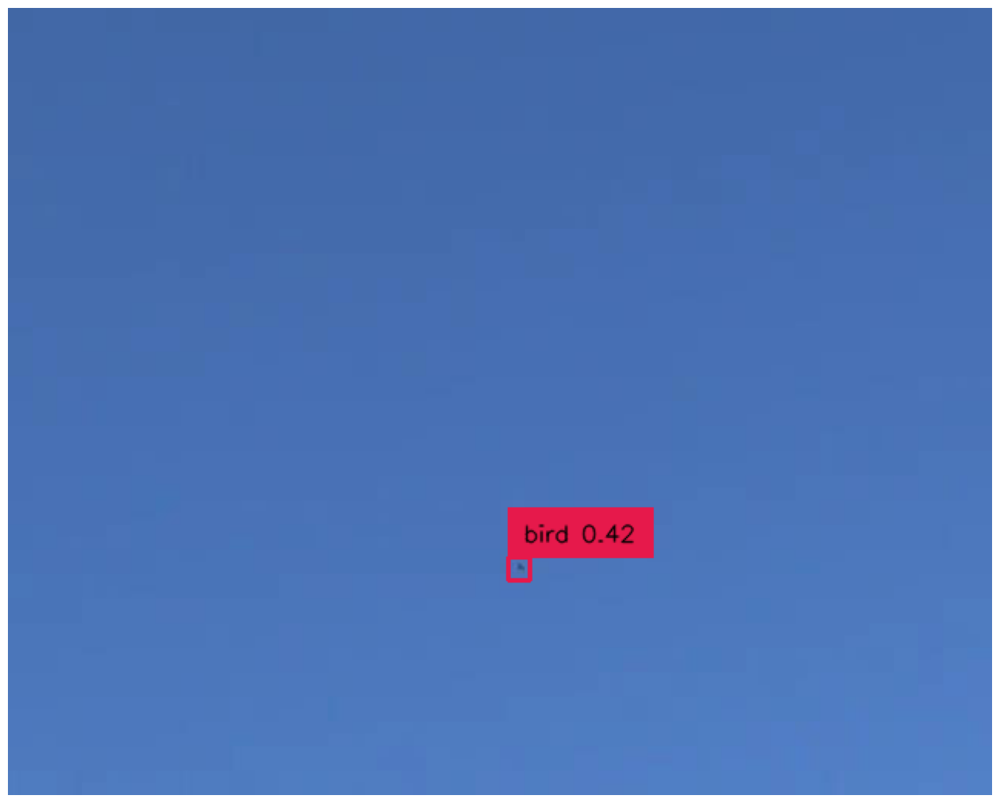

38.jpeg
332.91149139404297 364.89434814453125 13.860970735549927 14.700348854064941


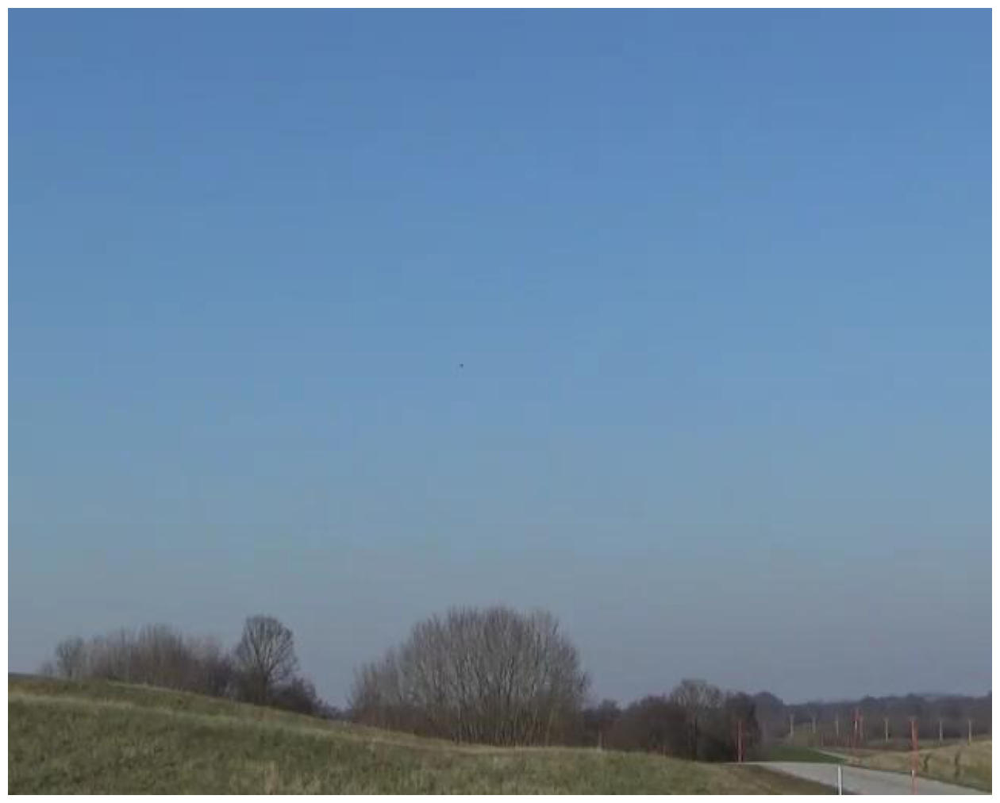

39.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


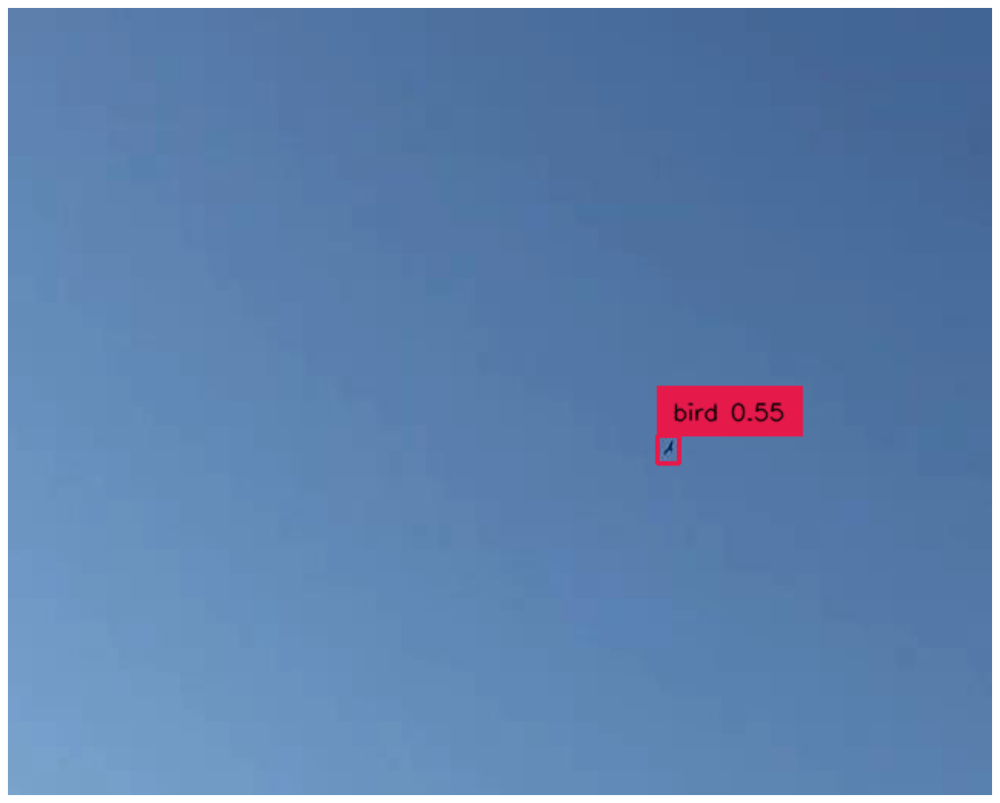

40.jpeg
429.33624267578125 287.6343688964844 14.316943883895874 17.789350509643555


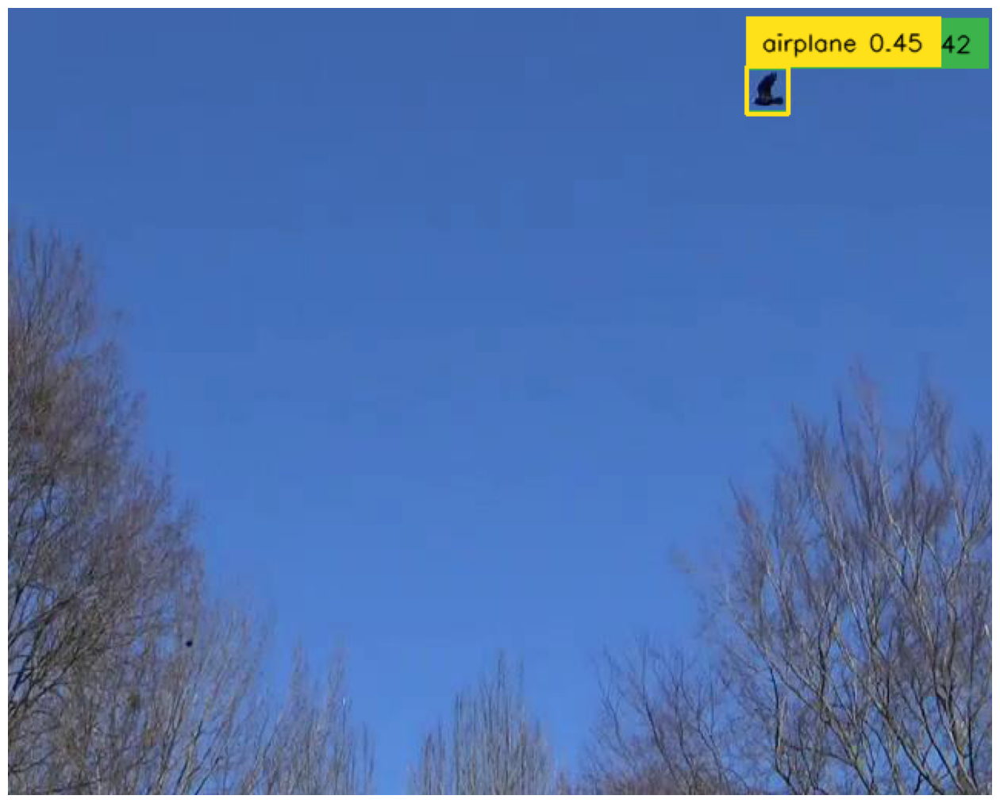

41.jpeg
494.0559768676758 53.891048431396484 26.177256107330322 29.713422775268555


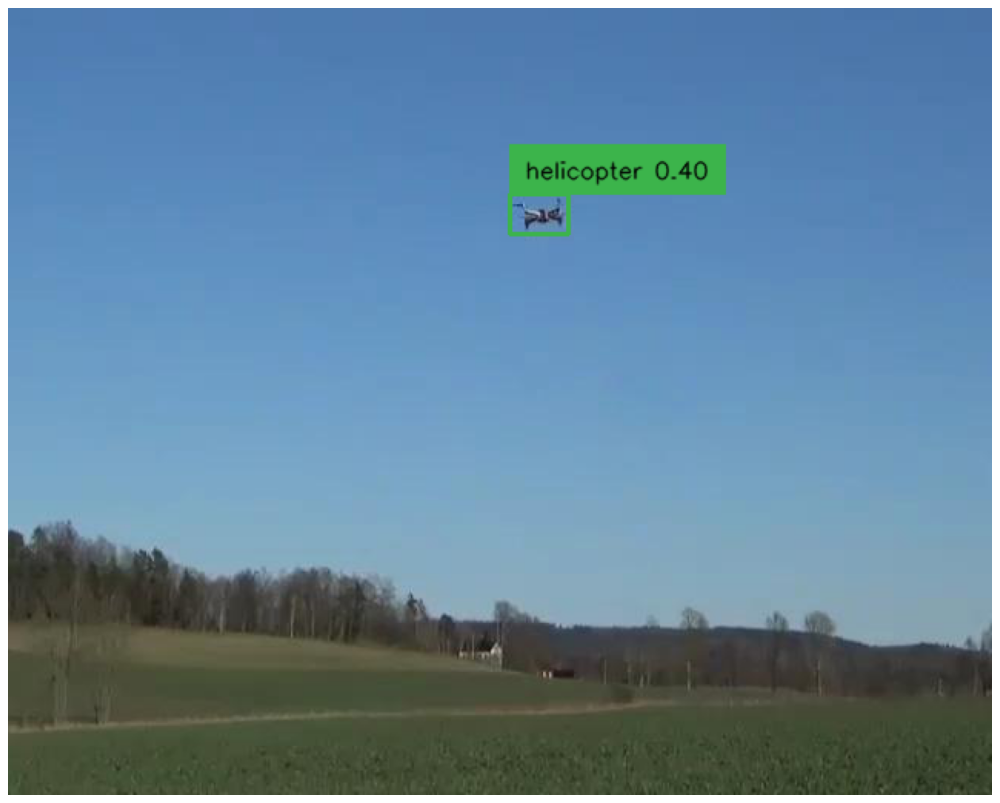

42.jpeg
345.22300720214844 134.47320556640625 38.411192893981934 25.80385971069336


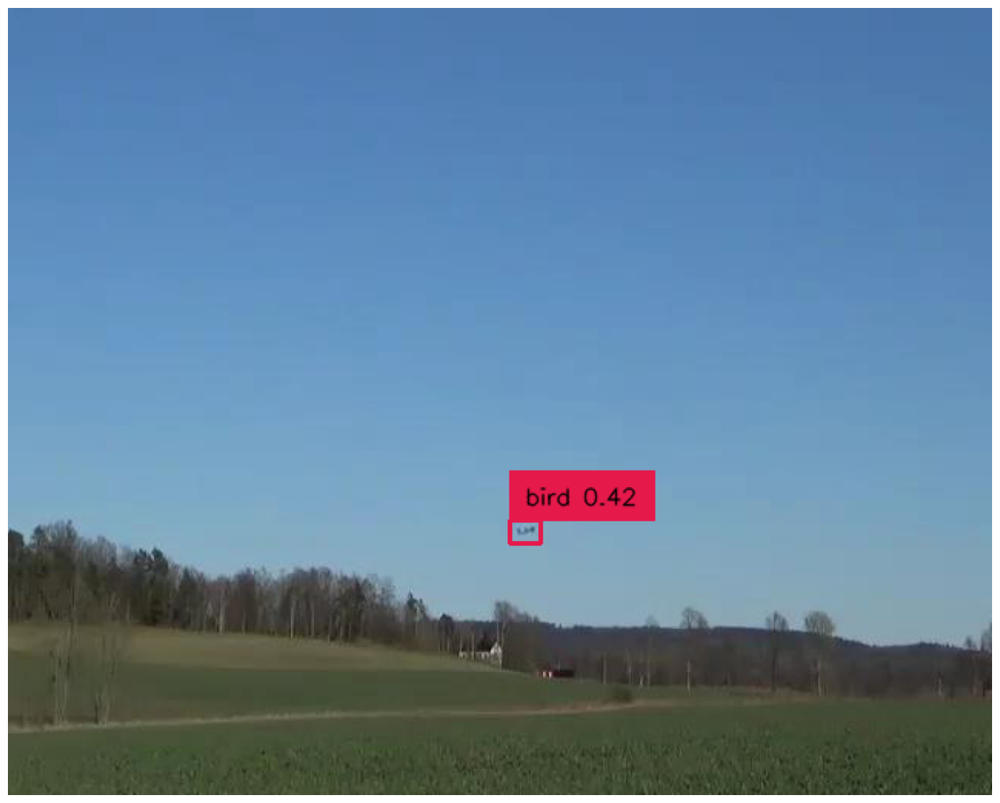

43.jpeg
336.2712097167969 340.6457824707031 19.884207248687744 14.827588081359863


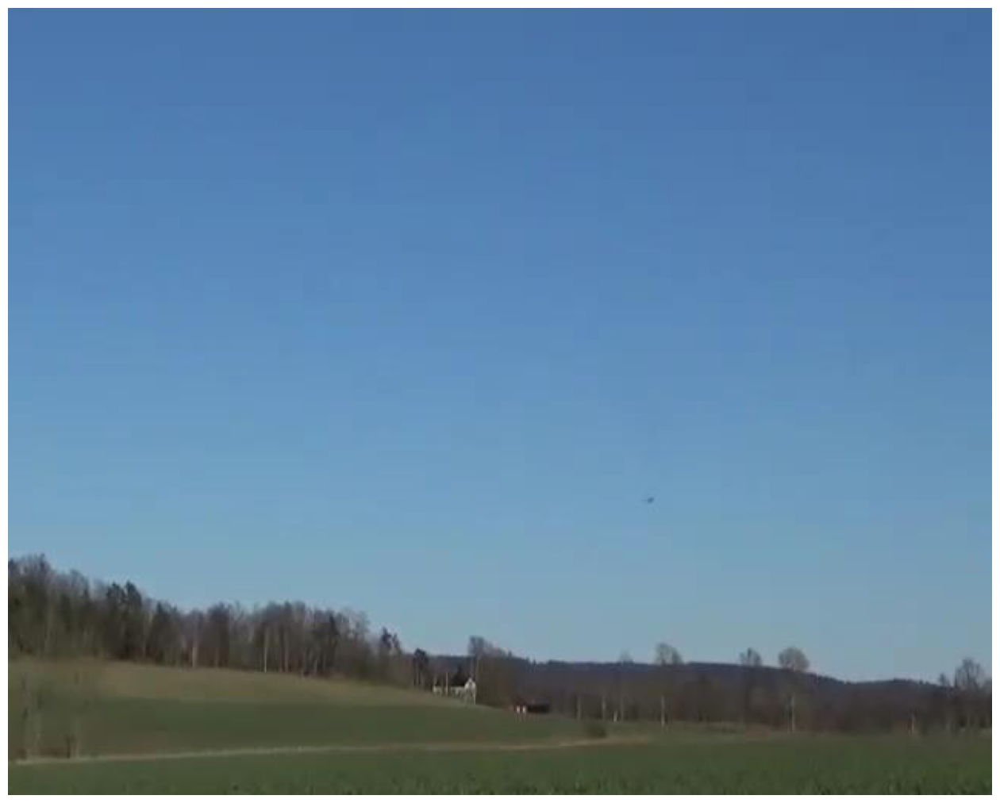

44.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


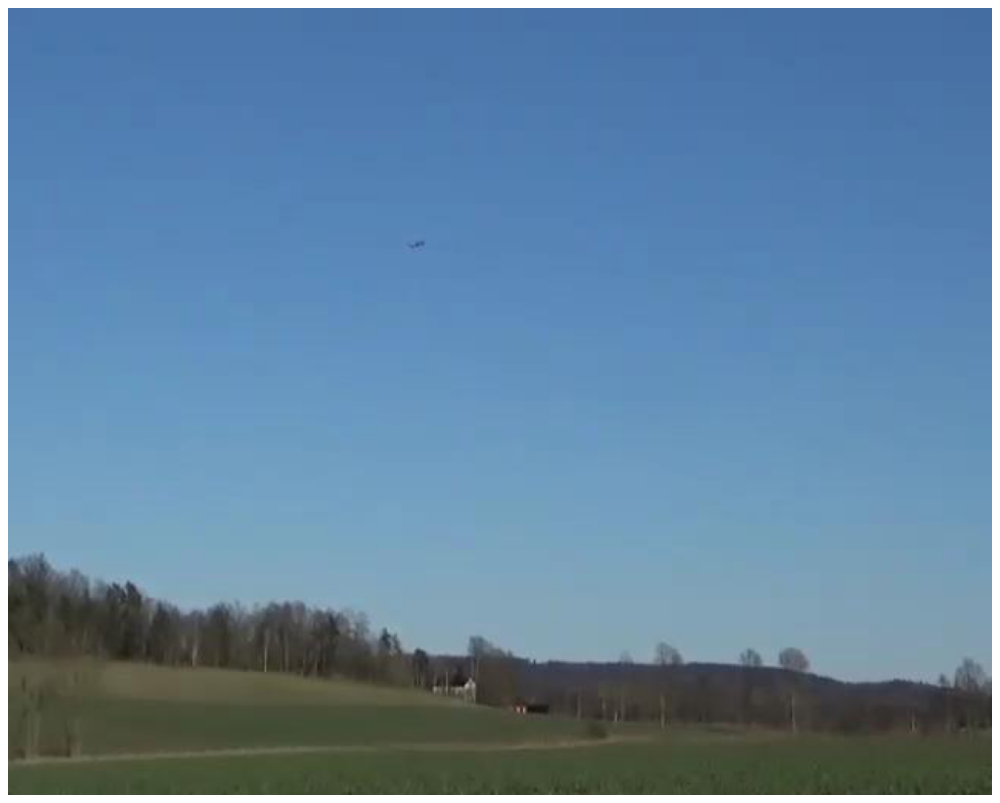

45.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


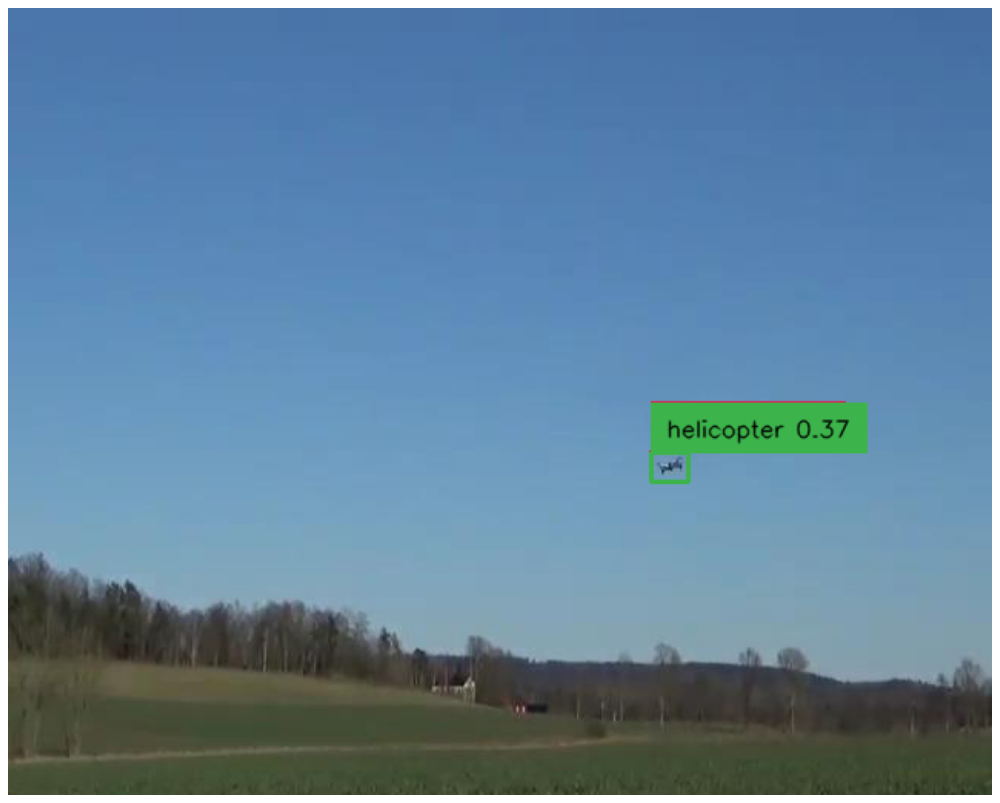

46.jpeg
430.34435272216797 298.5860290527344 24.05428171157837 19.440372467041016


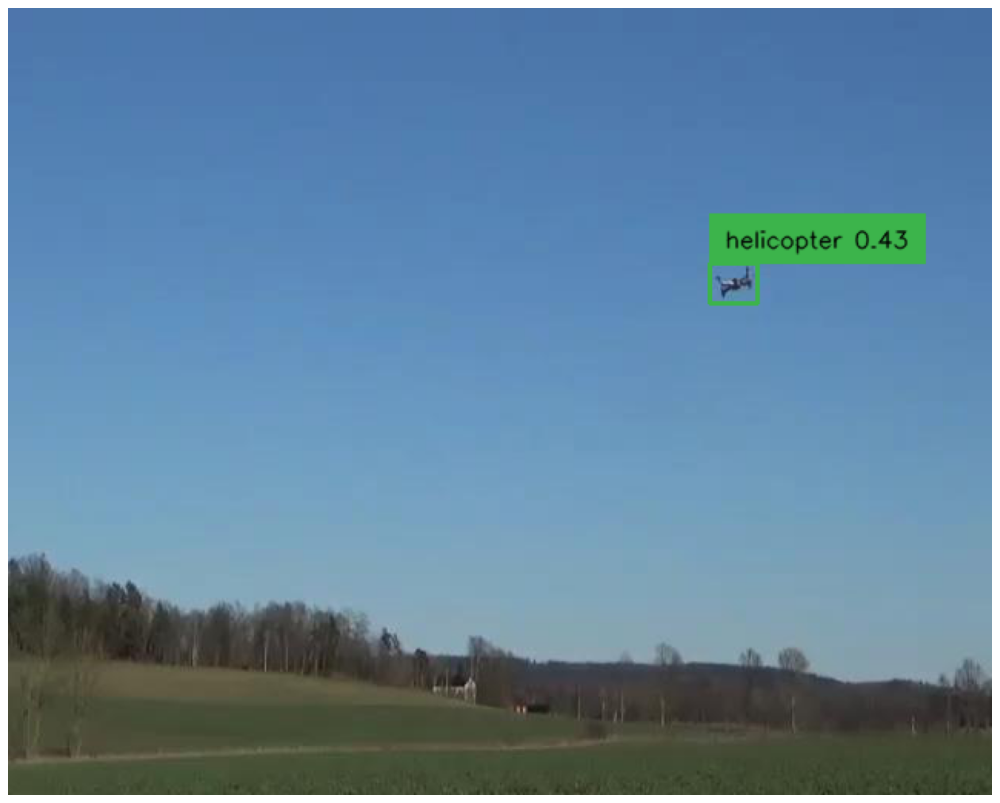

47.jpeg
472.04959869384766 179.48399353027344 31.15150213241577 26.86215591430664


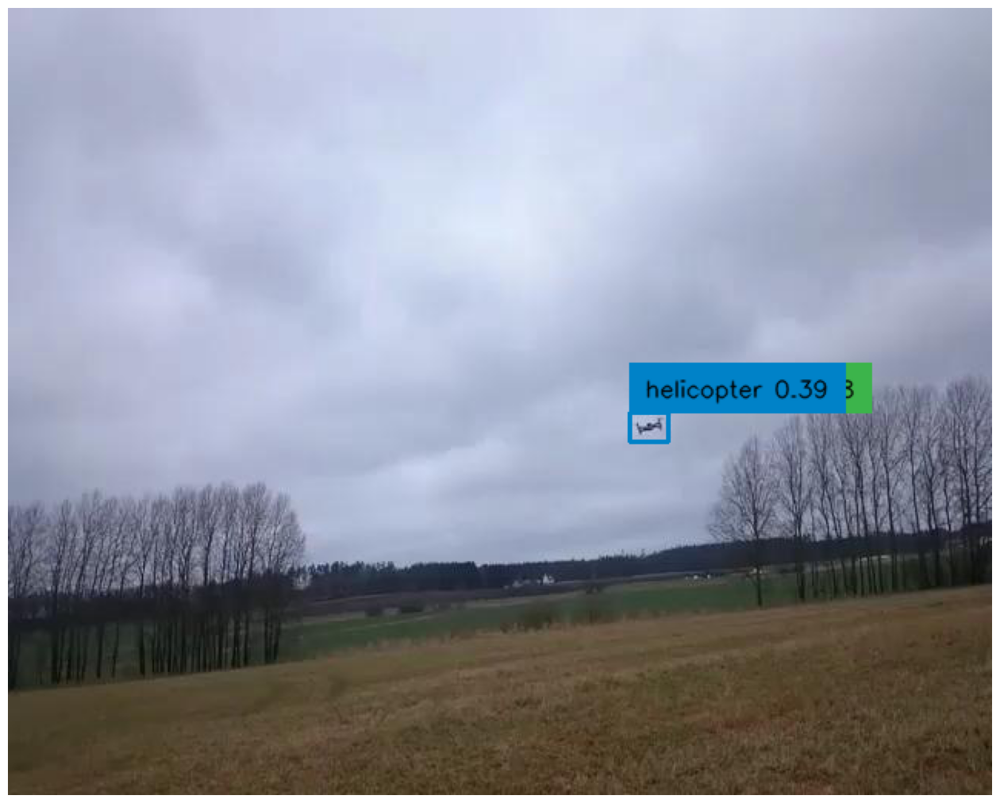

48.jpeg
416.6093063354492 273.1583557128906 25.165832042694092 19.392072677612305


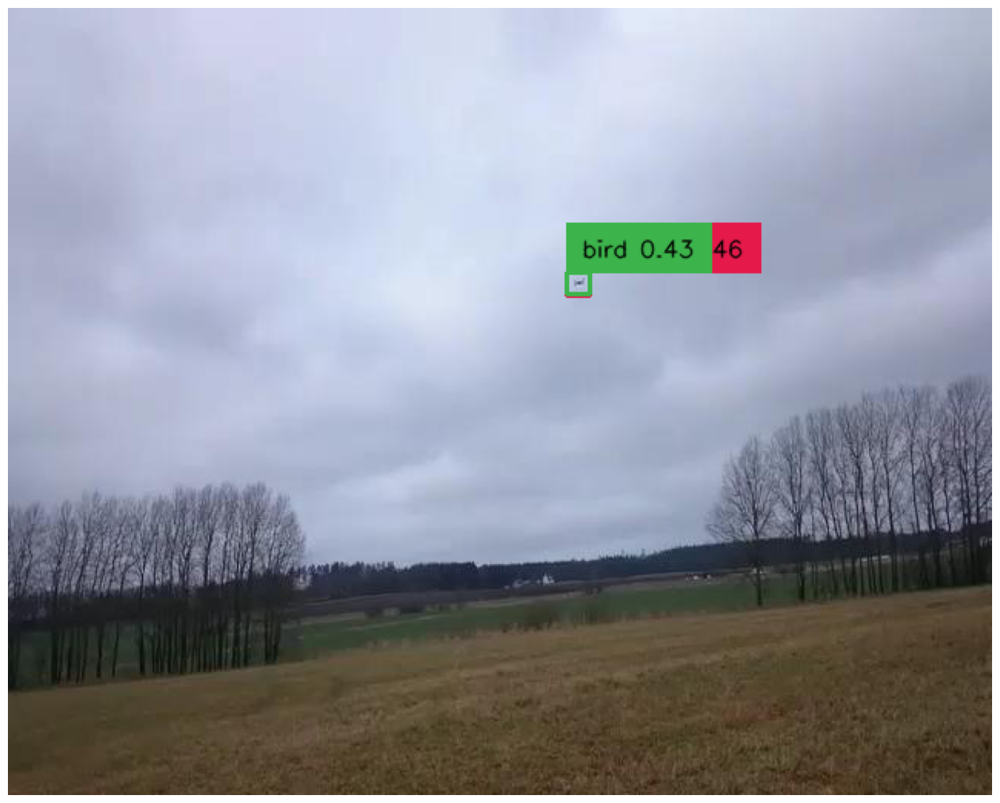

49.jpeg
370.9252166748047 179.6510009765625 15.400400161743164 14.78300666809082


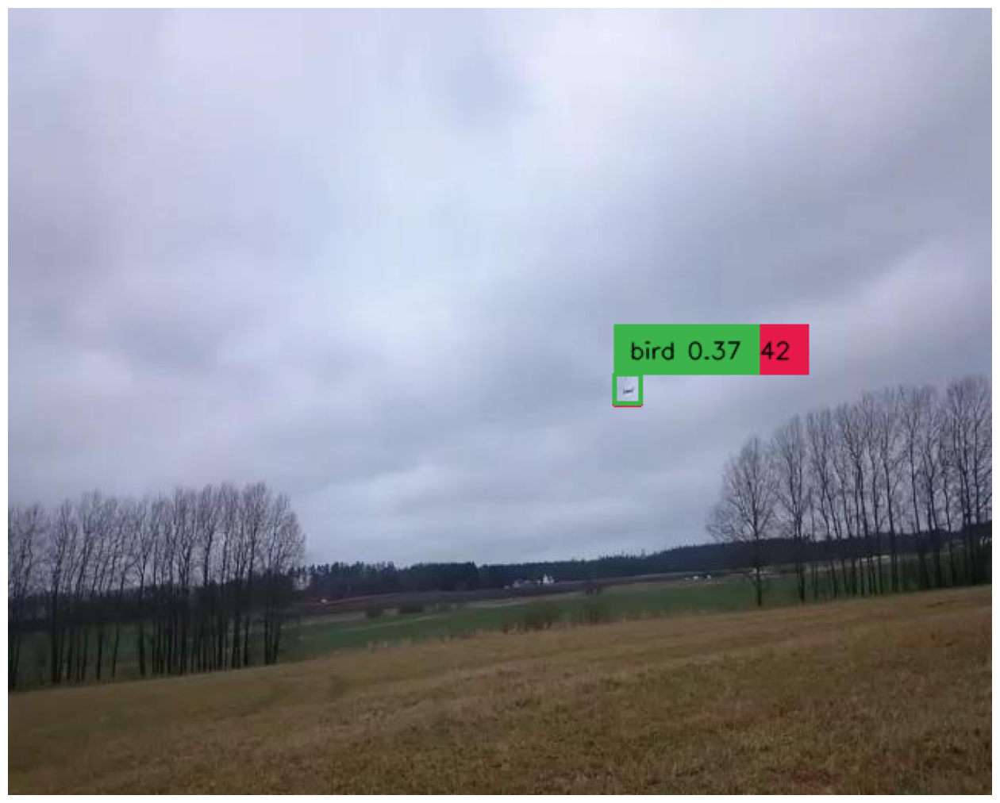

50.jpeg
402.9216766357422 248.5438690185547 16.36892557144165 19.128881454467773


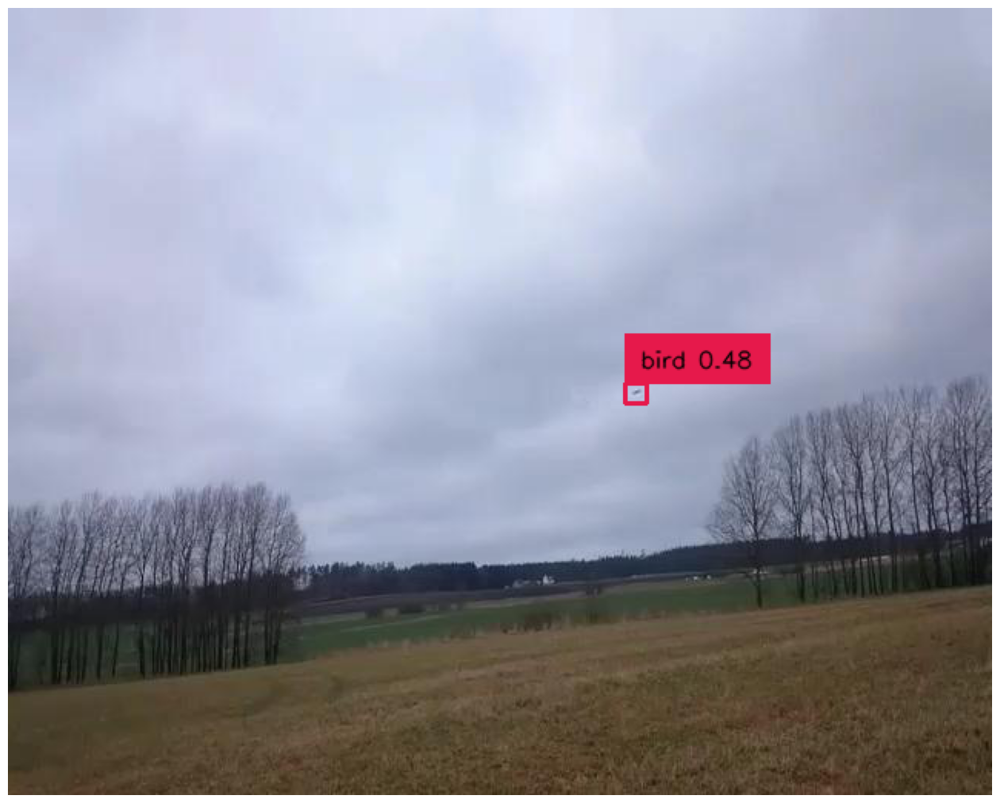

51.jpeg
408.4286117553711 250.9945068359375 14.830280542373657 13.154321670532227


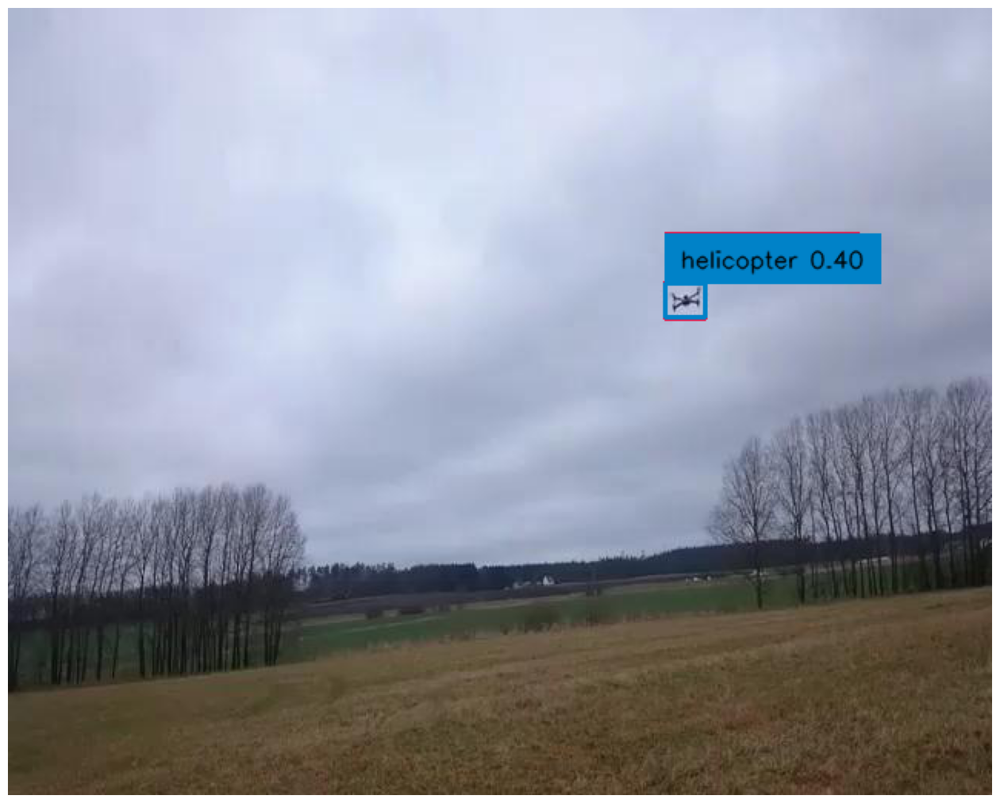

52.jpeg
440.4803466796875 190.50747680664062 26.548354625701904 23.040605545043945


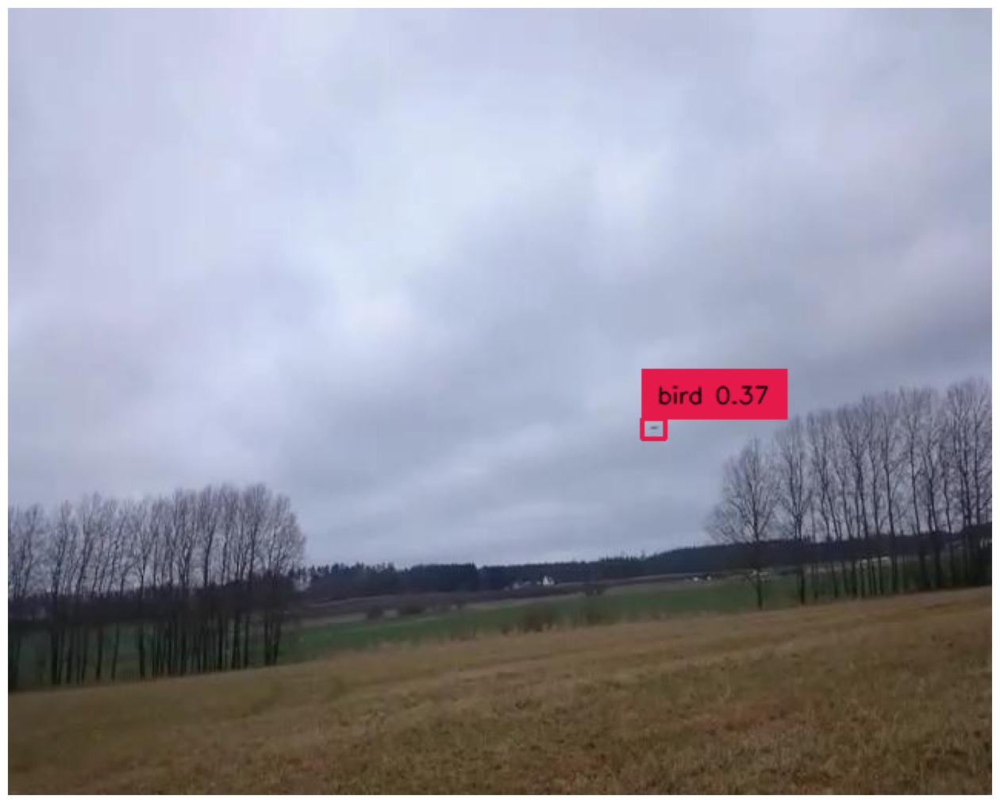

53.jpeg
419.9882507324219 274.03961181640625 15.411241054534912 13.049518585205078


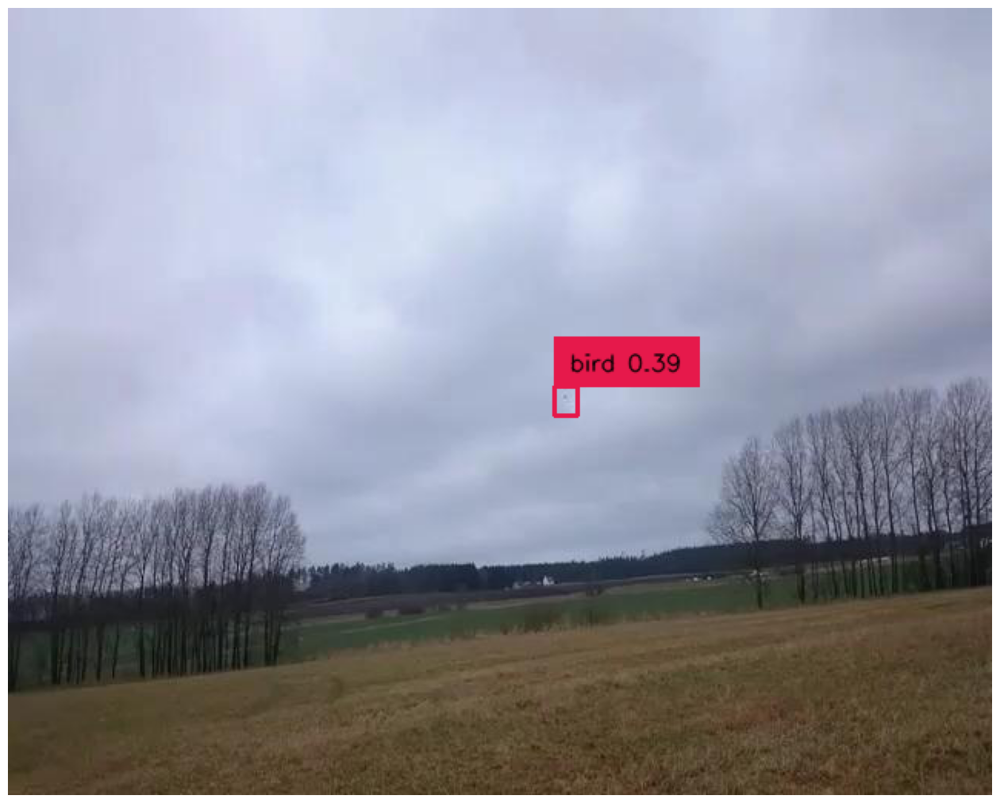

54.jpeg
363.03916931152344 255.98977661132812 15.780376195907593 18.688032150268555


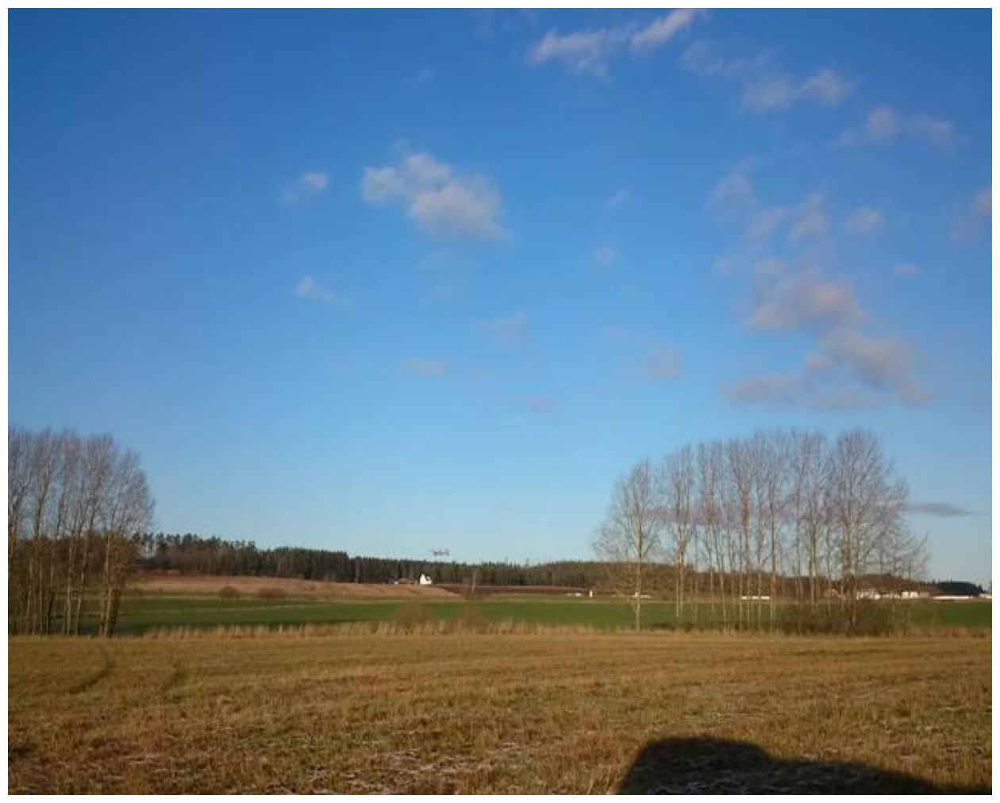

55.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


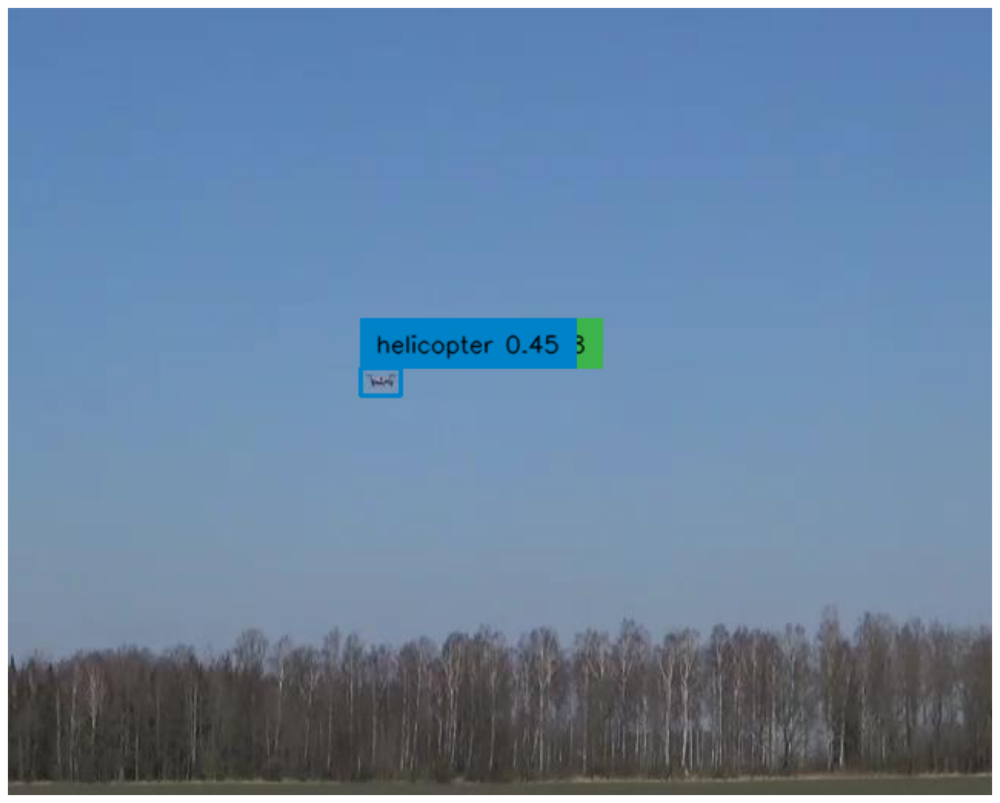

56.jpeg
242.29965209960938 243.4878692626953 26.118299961090088 18.16025161743164


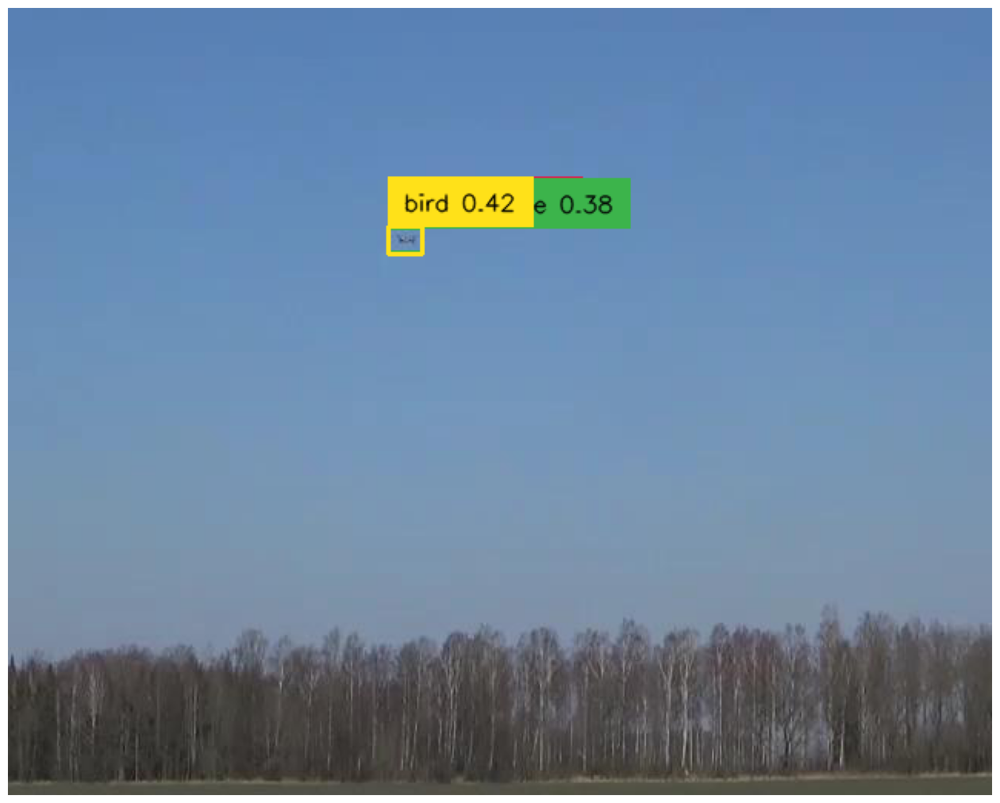

57.jpeg
258.4707450866699 151.45787048339844 21.525907516479492 17.203142166137695


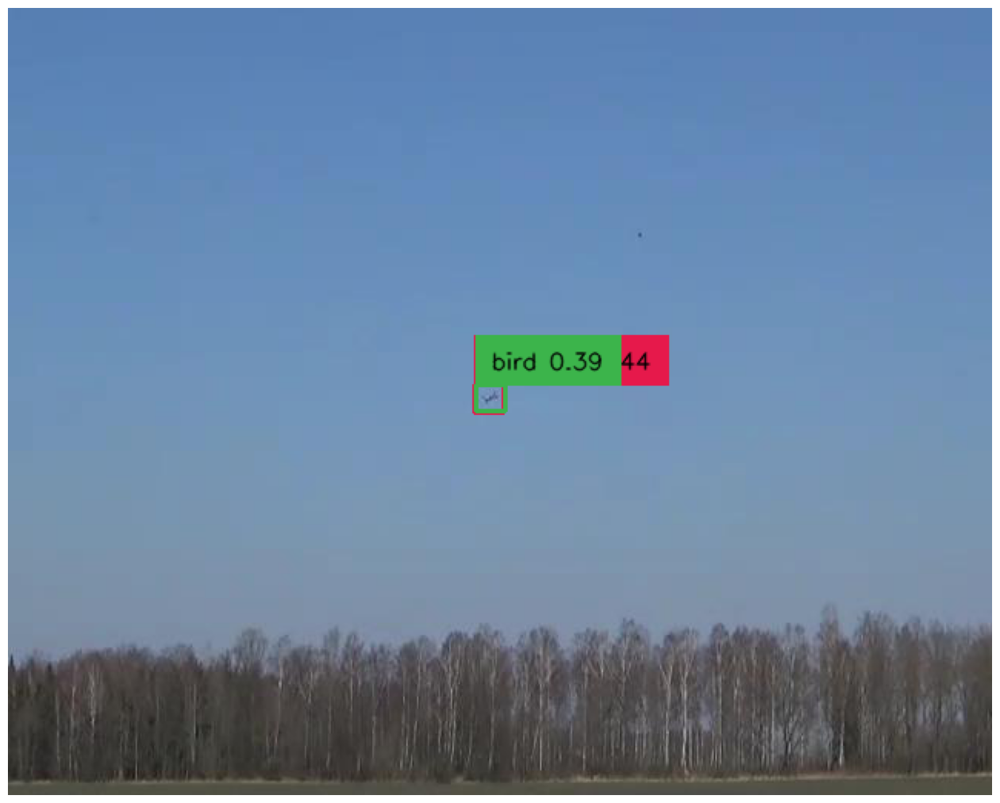

58.jpeg
313.4355926513672 254.1219482421875 19.038360118865967 18.123661041259766


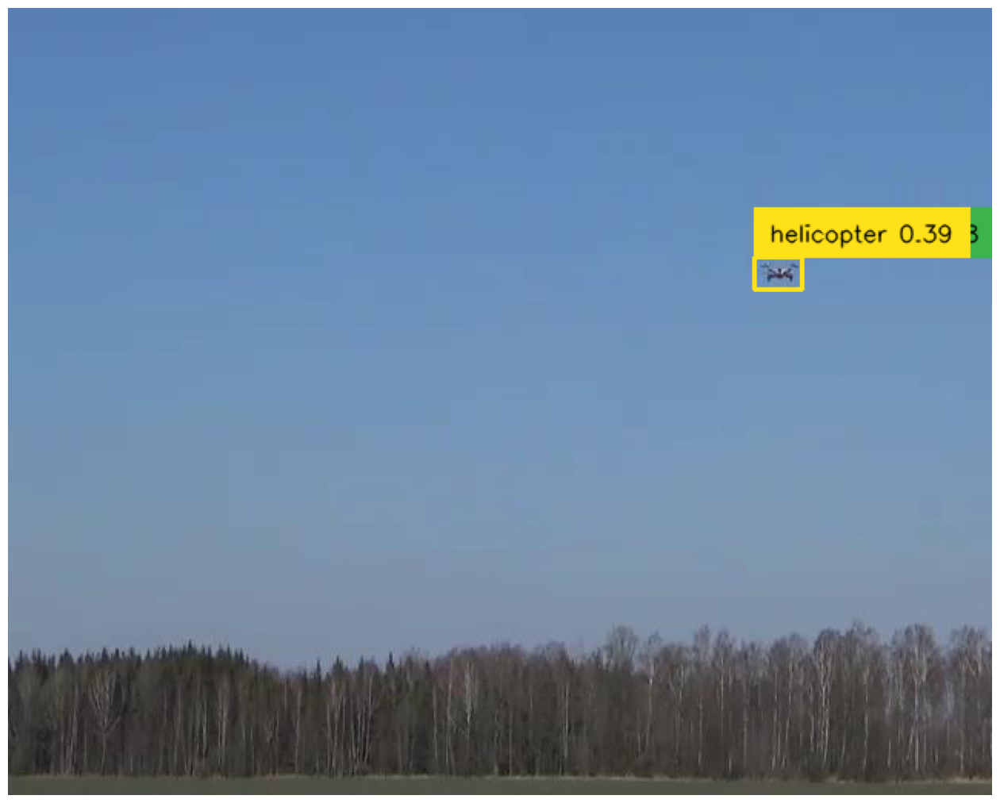

59.jpeg
501.0572052001953 173.23379516601562 30.824029445648193 21.470478057861328


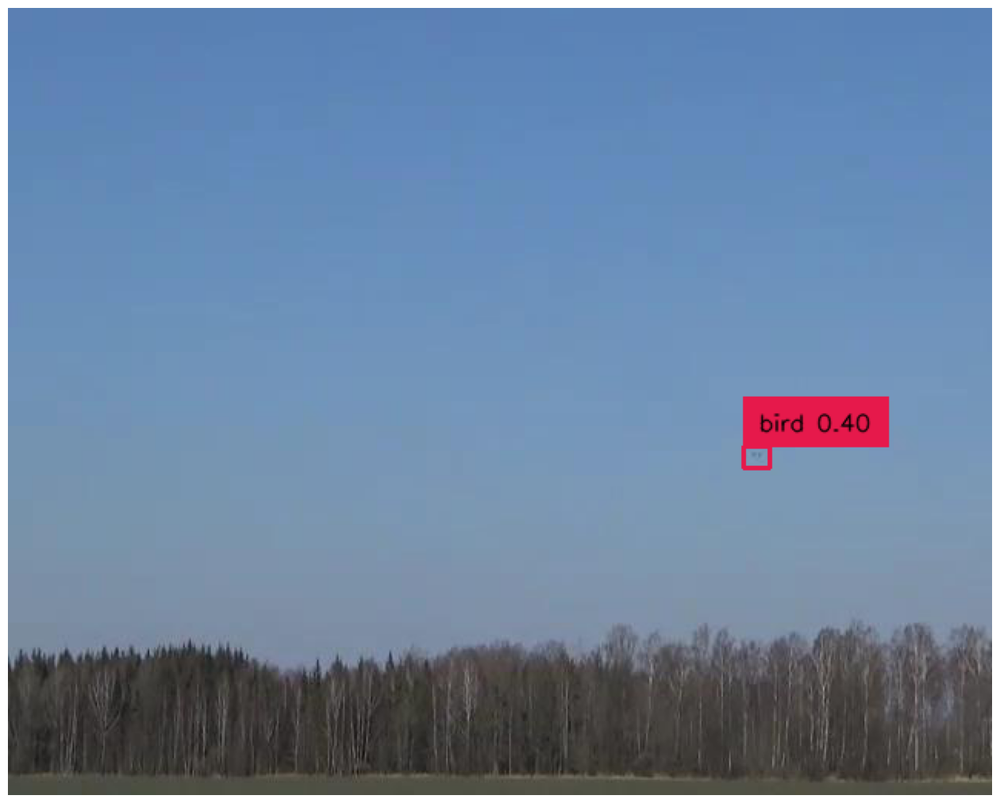

60.jpeg
486.8340301513672 292.0837707519531 16.72702670097351 14.017806053161621


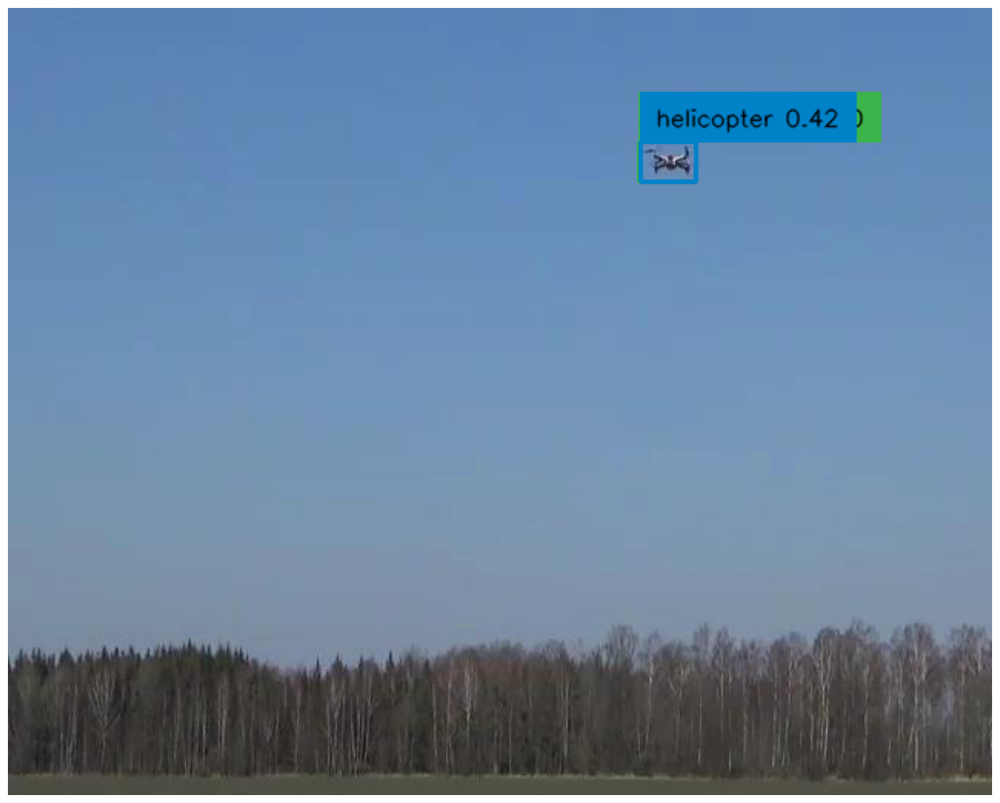

61.jpeg
429.2655563354492 100.35446166992188 36.7250394821167 26.21369171142578


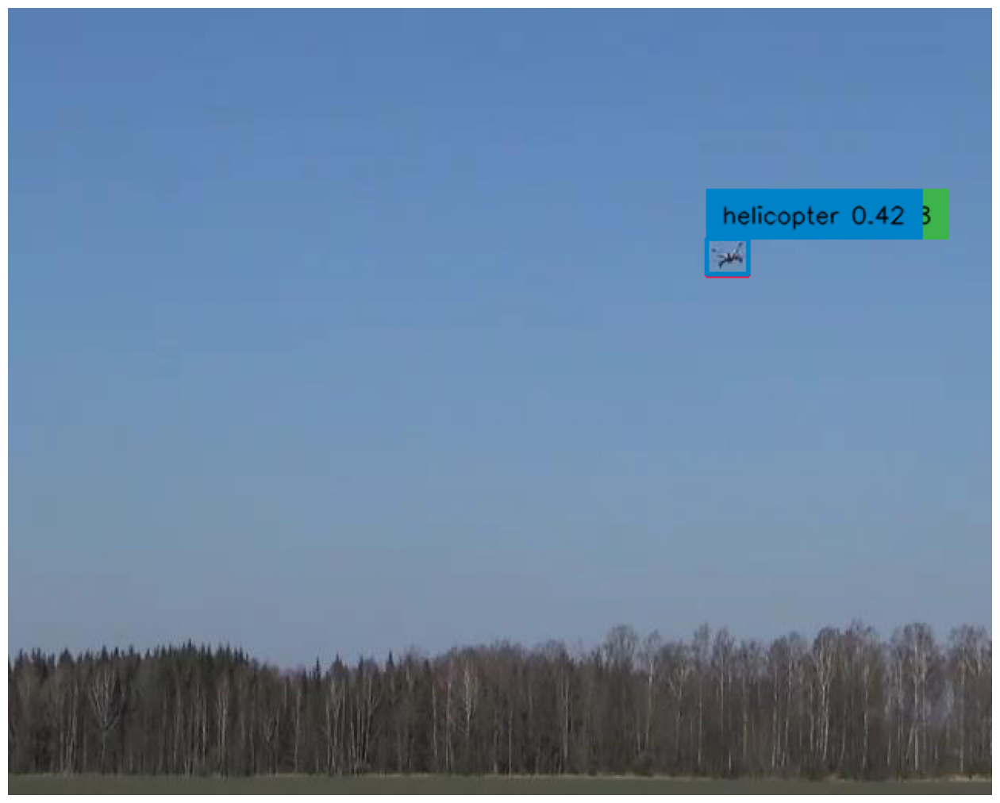

62.jpeg
468.0577850341797 162.08624267578125 27.321200370788574 23.896398544311523


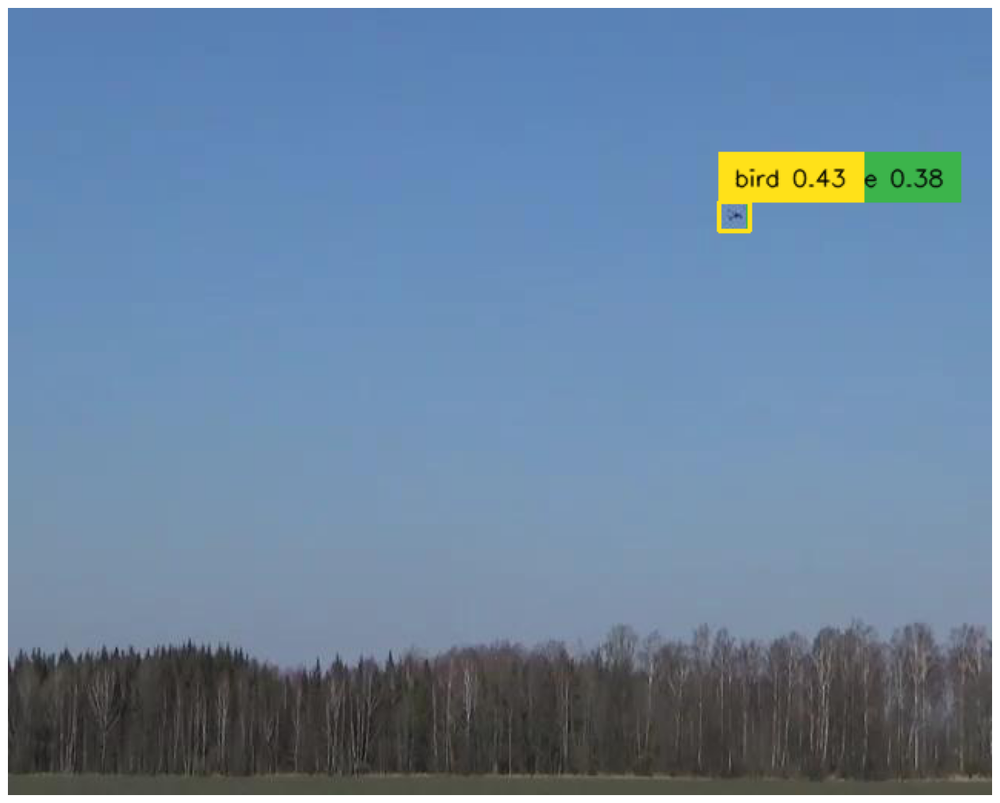

63.jpeg
472.19749450683594 135.81617736816406 19.464499950408936 19.413408279418945


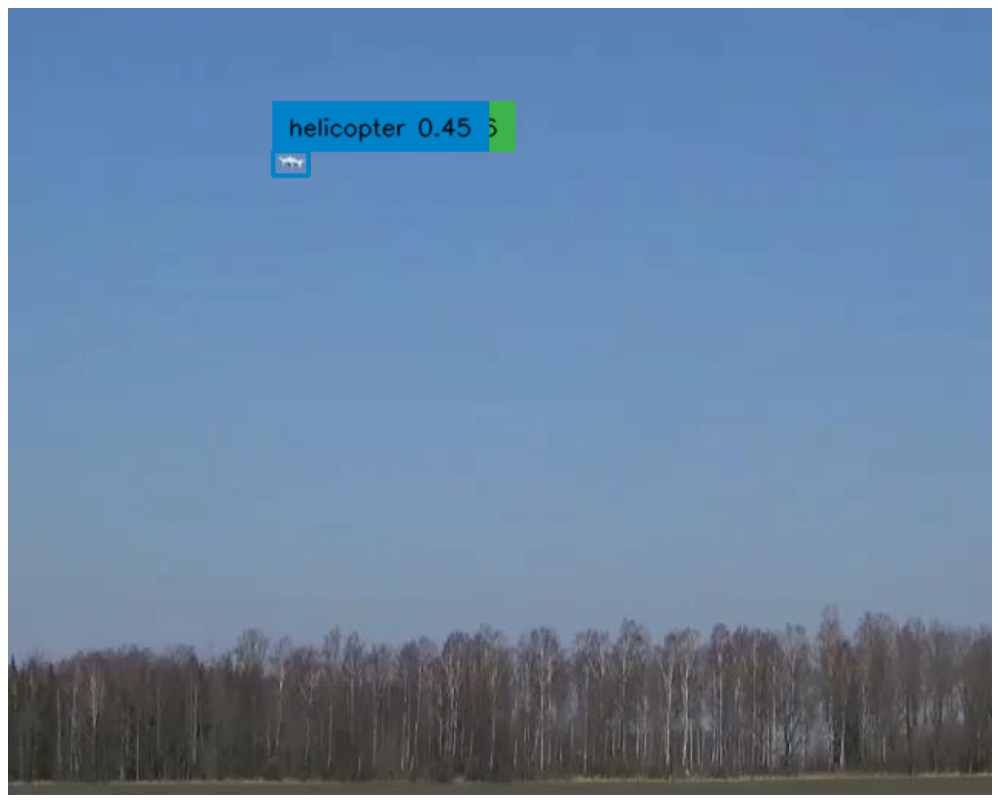

64.jpeg
184.0349578857422 101.38363647460938 22.831311225891113 16.37466049194336


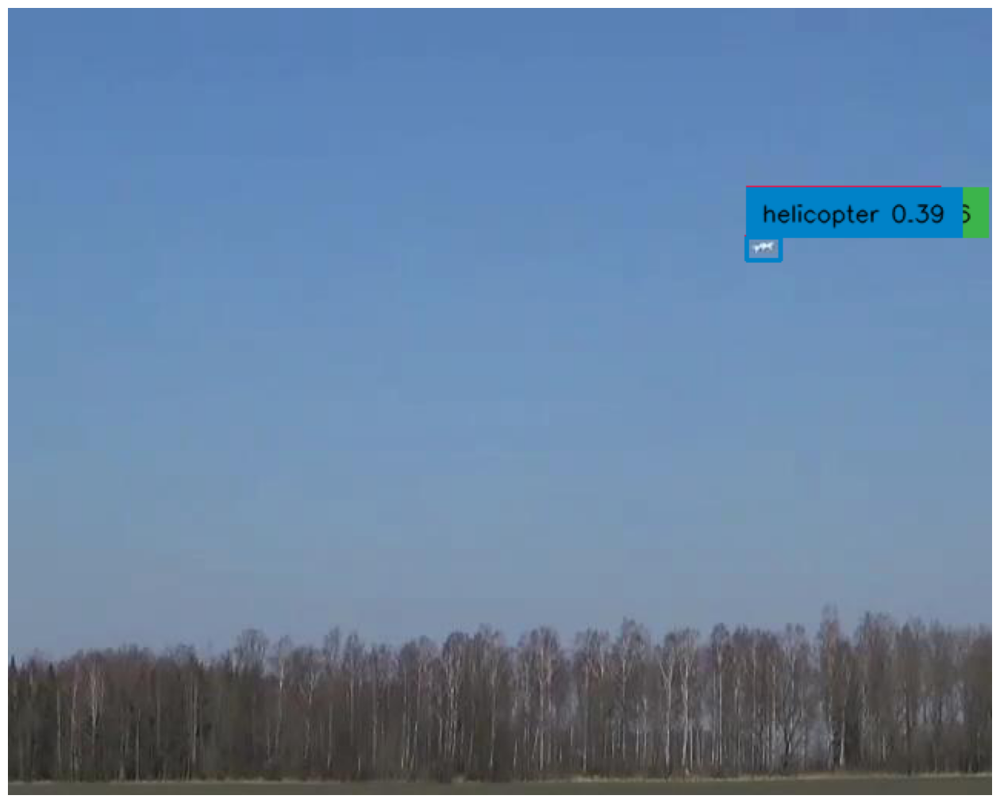

65.jpeg
491.2880325317383 156.796142578125 22.36063241958618 15.713093757629395


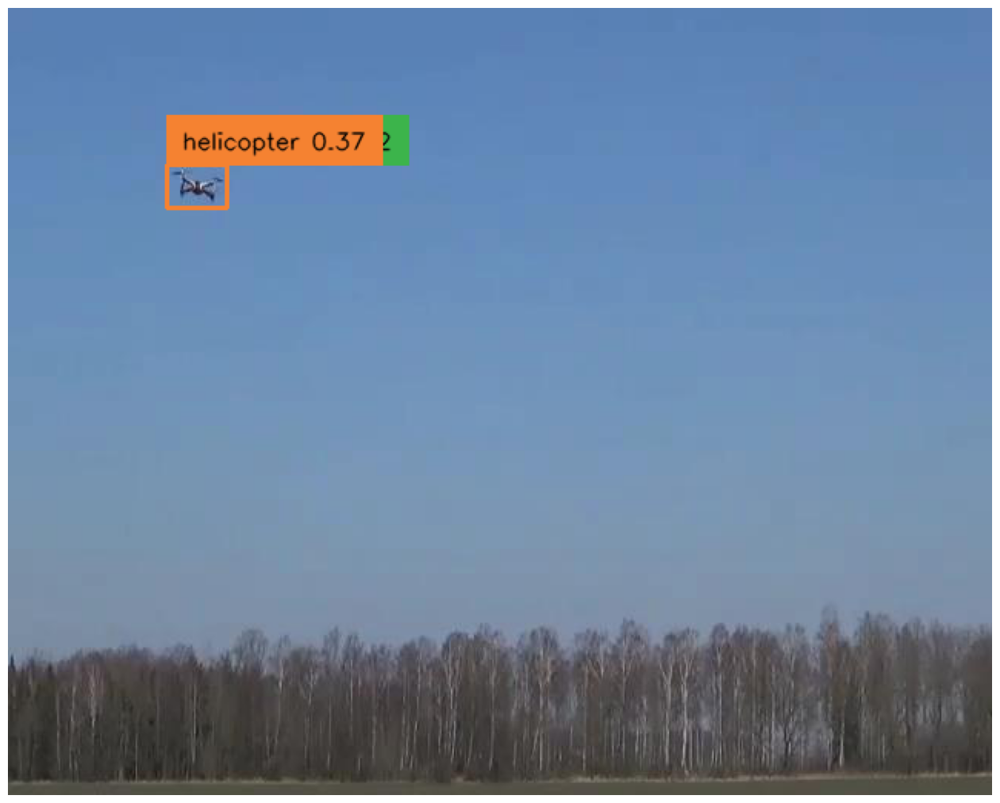

66.jpeg
123.04719924926758 116.39442443847656 38.99399280548096 28.076879501342773


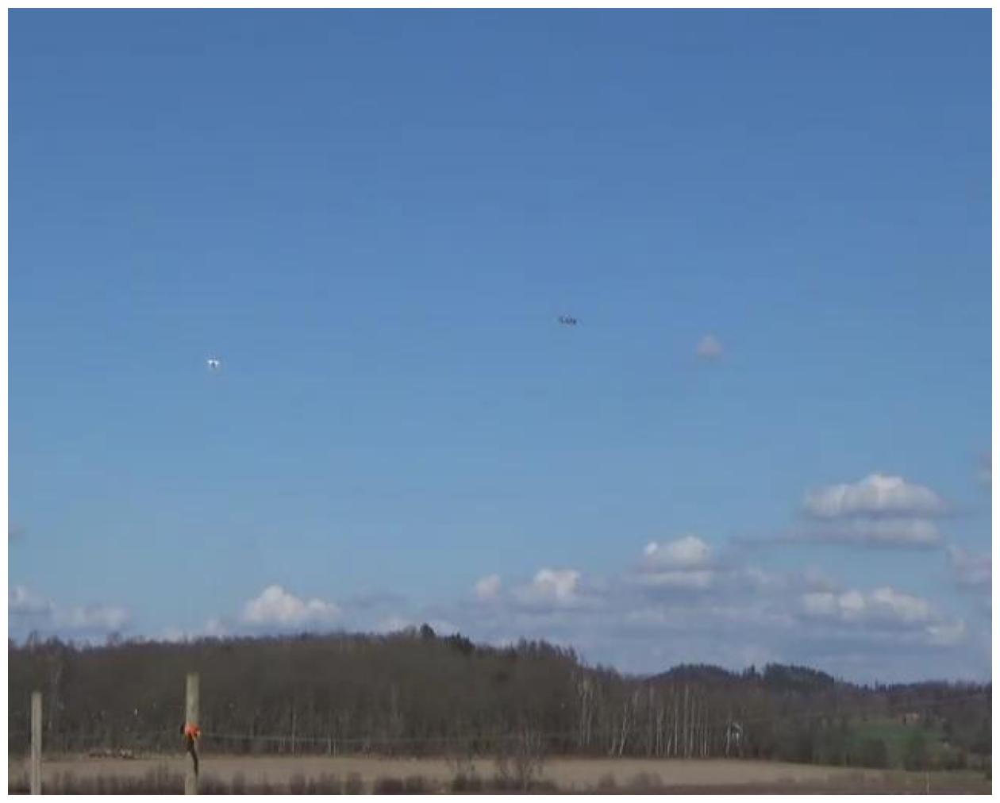

67.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


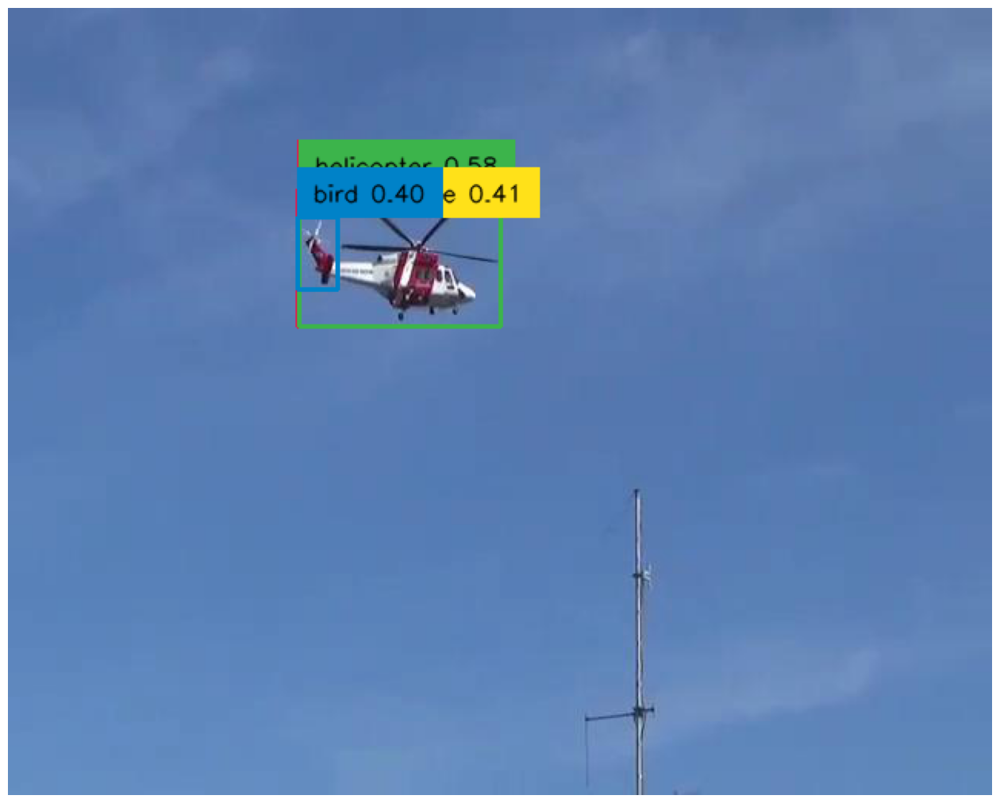

68.jpeg
254.76530075073242 162.6570587158203 131.9871425628662 89.17613983154297


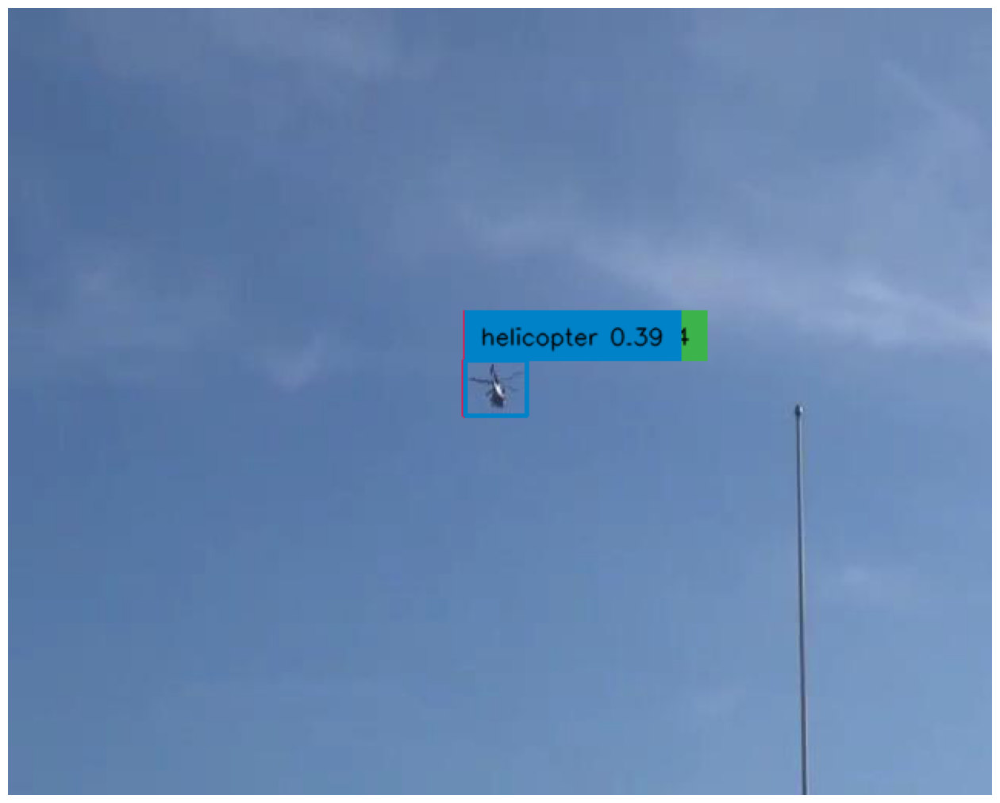

69.jpeg
317.12080001831055 247.59512329101562 39.808716773986816 35.61367416381836


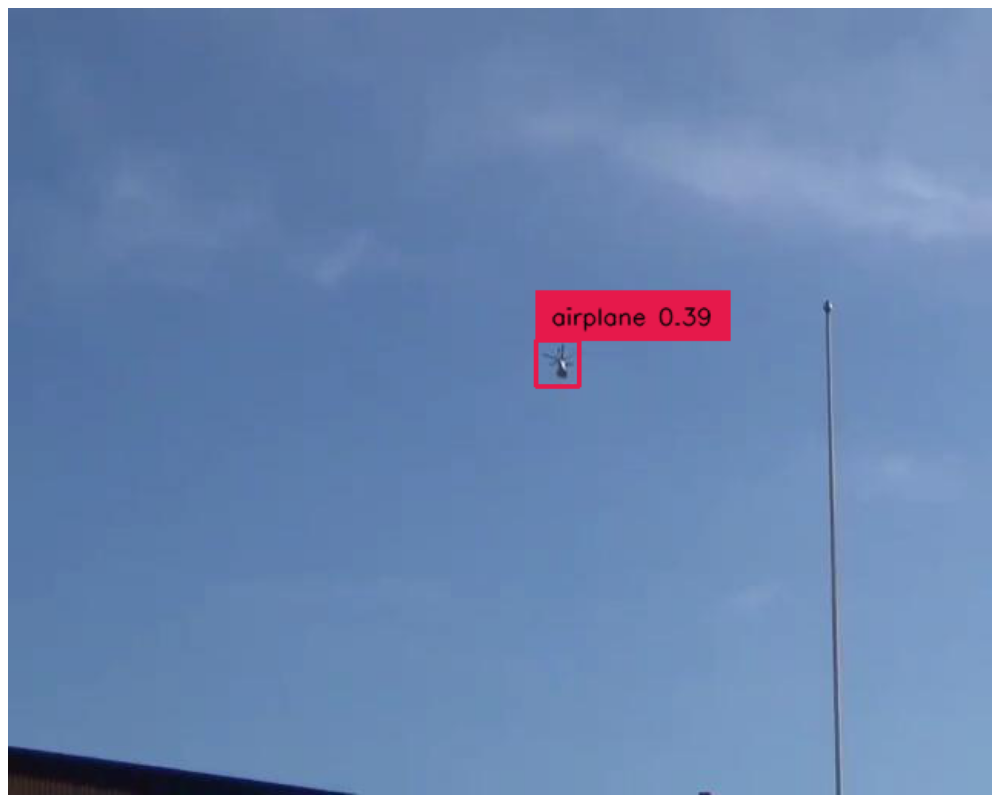

70.jpeg
357.5514221191406 231.15234375 27.609083652496338 30.0057430267334


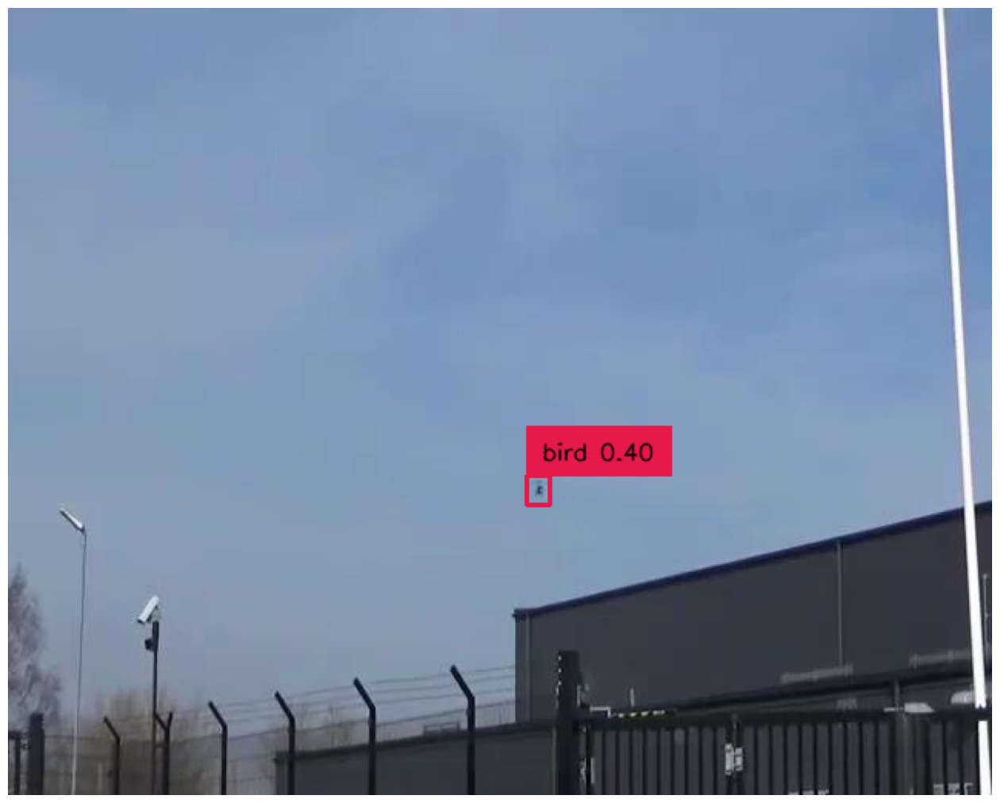

71.jpeg
345.2138137817383 314.09844970703125 15.05077600479126 18.491344451904297


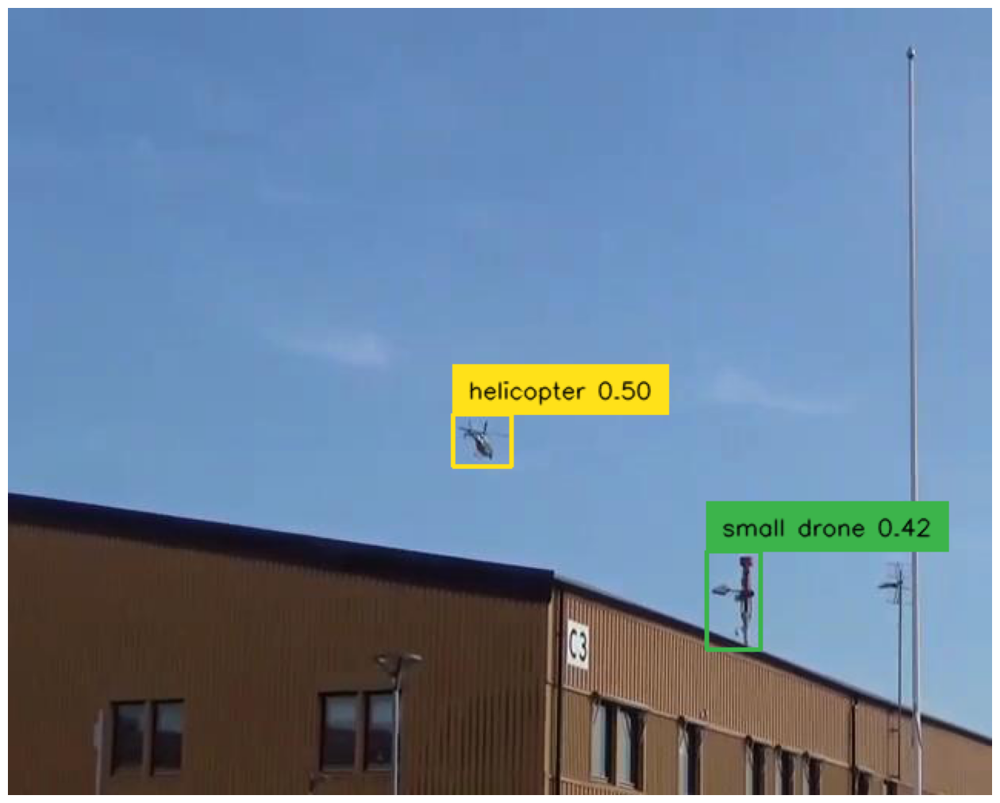

72.jpeg
308.3026313781738 281.2164001464844 37.851970195770264 34.14503479003906


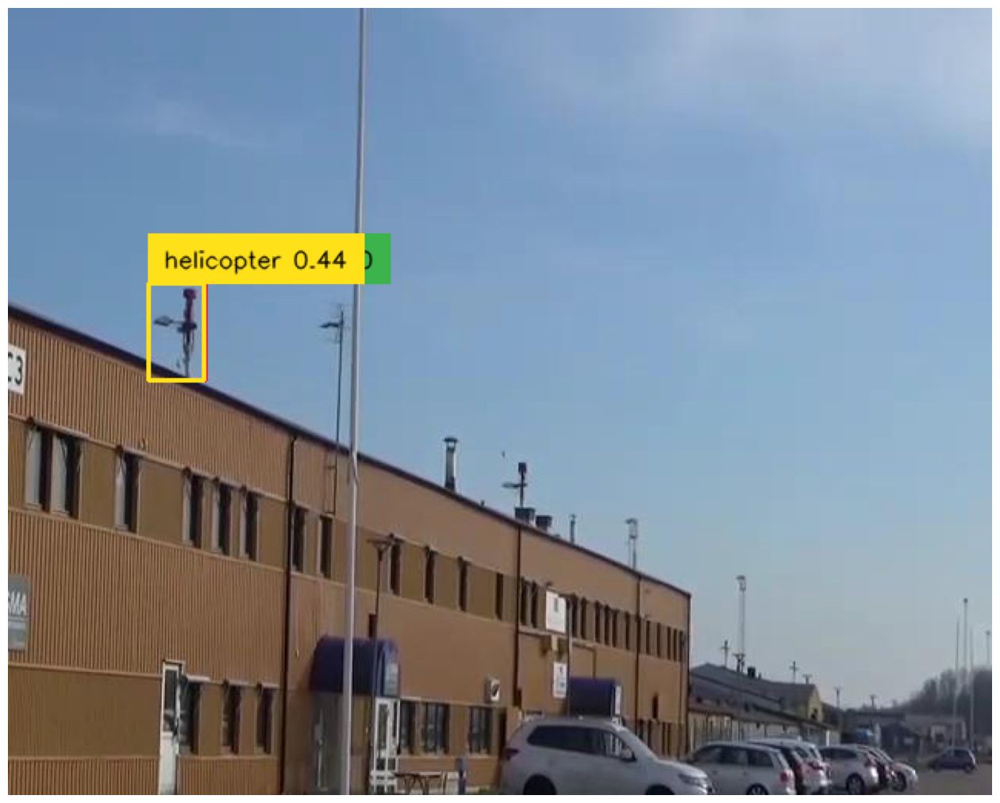

73.jpeg
109.56175804138184 211.09117126464844 36.935484409332275 63.182640075683594


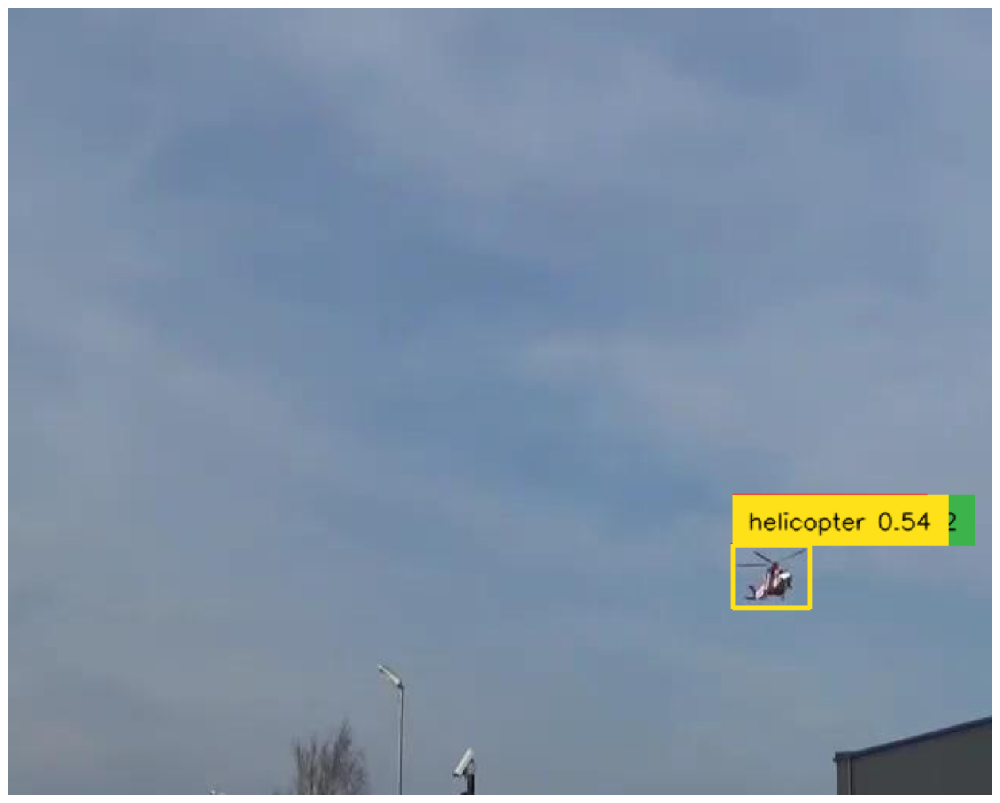

74.jpeg
496.0237121582031 369.8585205078125 50.021562576293945 41.905967712402344


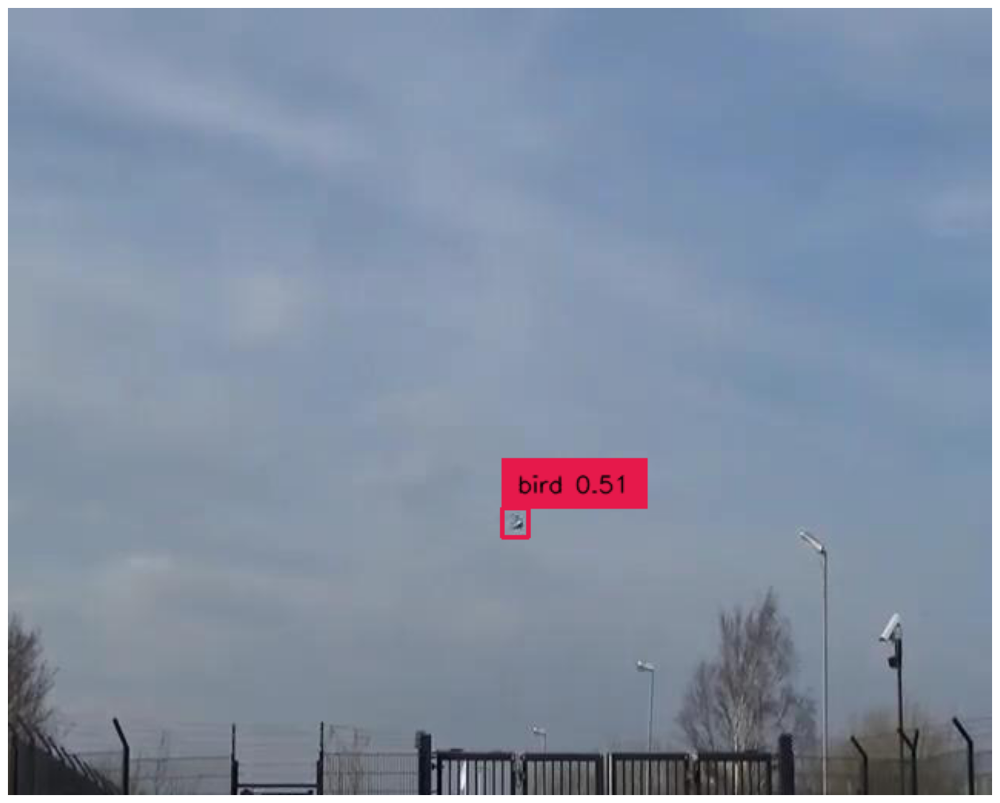

75.jpeg
330.2077102661133 335.4041442871094 17.346043586730957 18.977651596069336


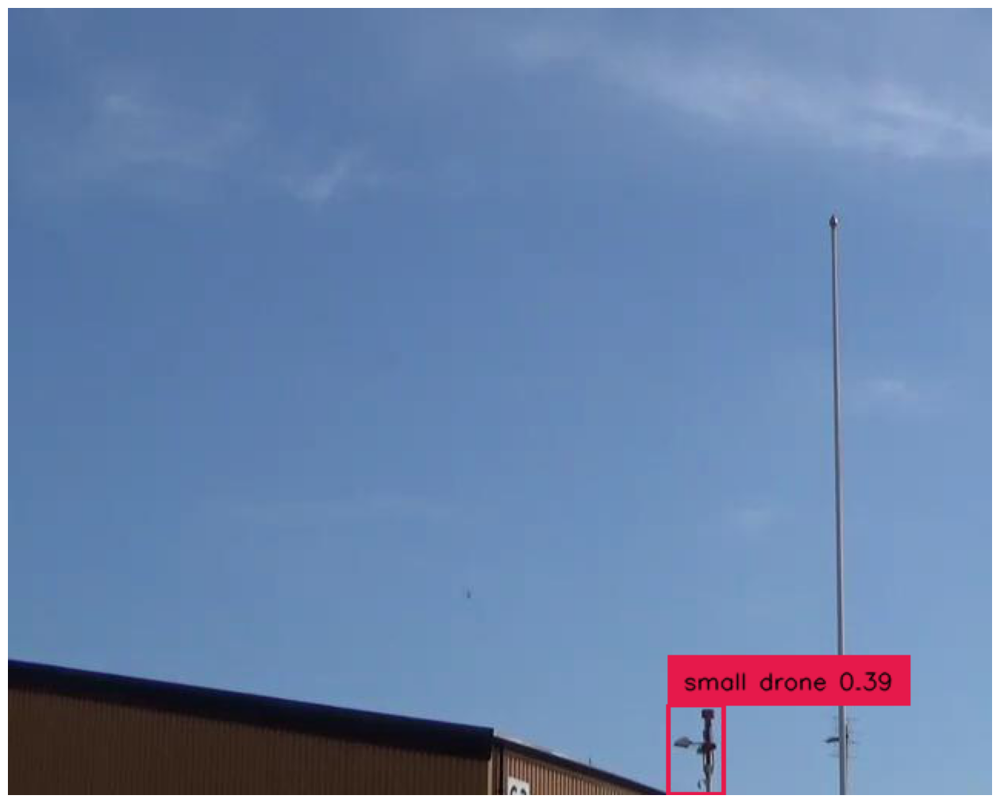

76.jpeg
447.6625061035156 482.611572265625 36.19476079940796 58.61791229248047


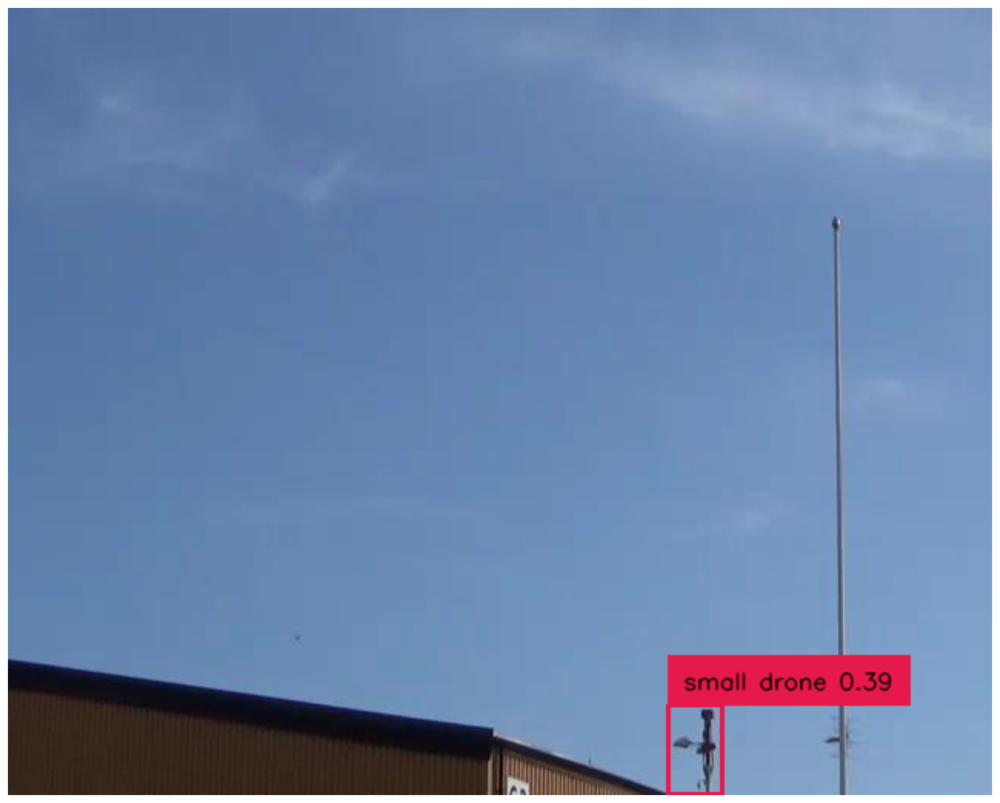

77.jpeg
447.01061248779297 482.7832946777344 35.41290044784546 58.268497467041016


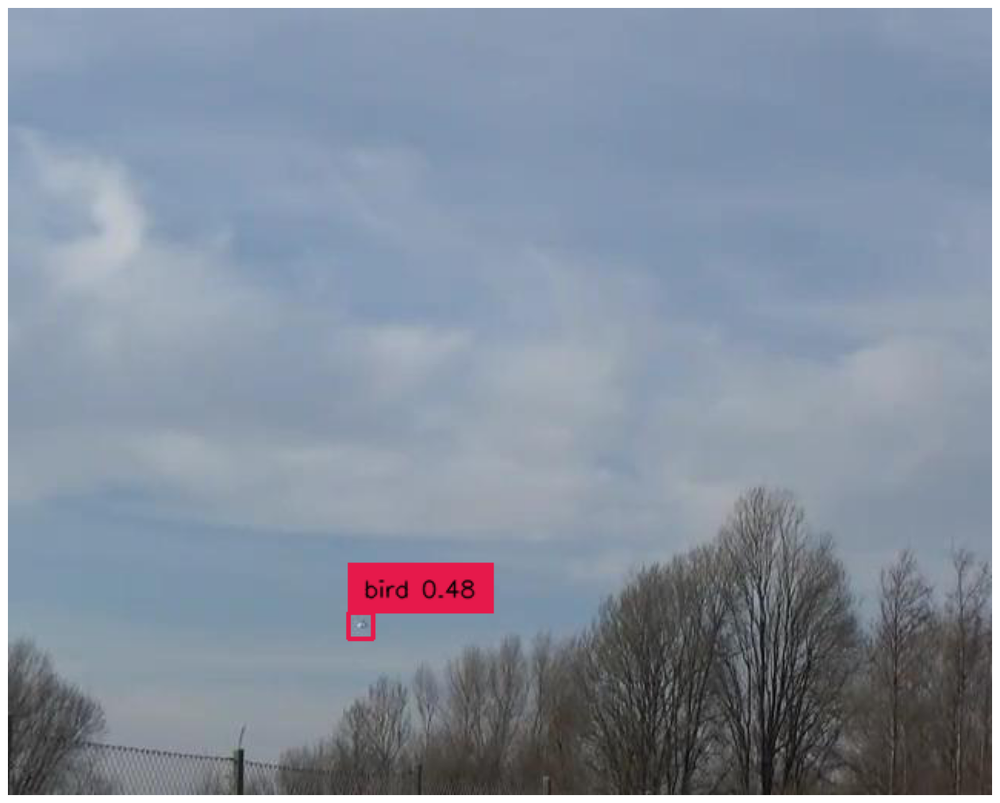

78.jpeg
229.58093643188477 401.8417053222656 16.837857961654663 16.86980438232422


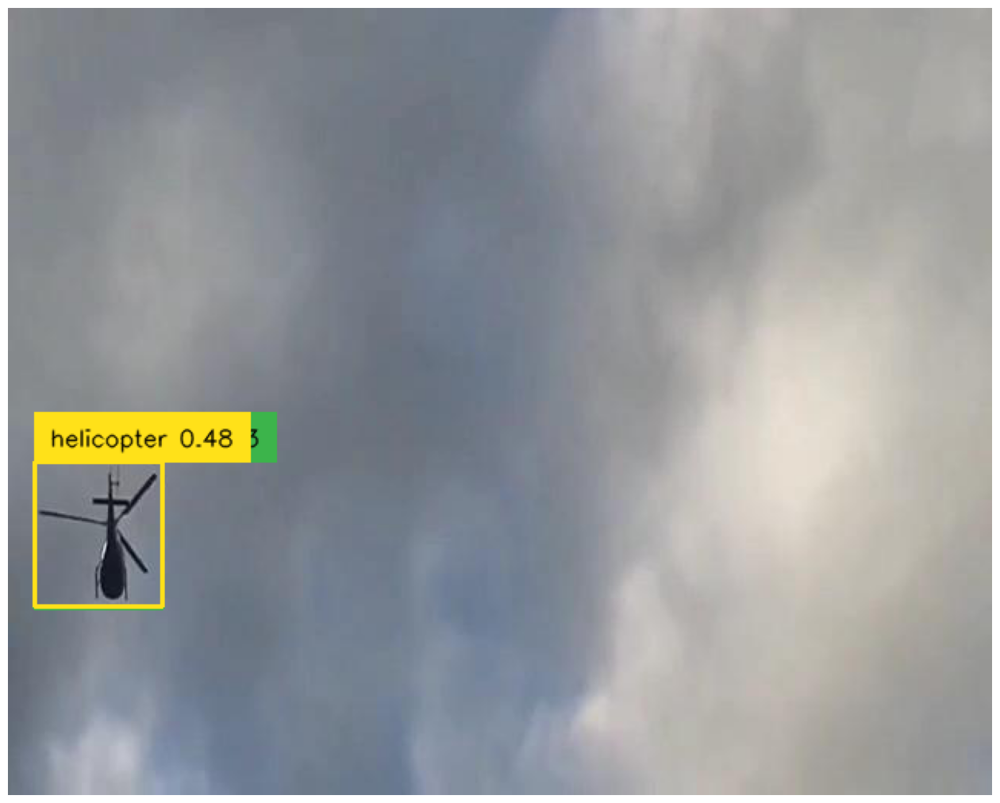

79.jpeg
58.64062786102295 342.70684814453125 83.23027610778809 94.56353759765625


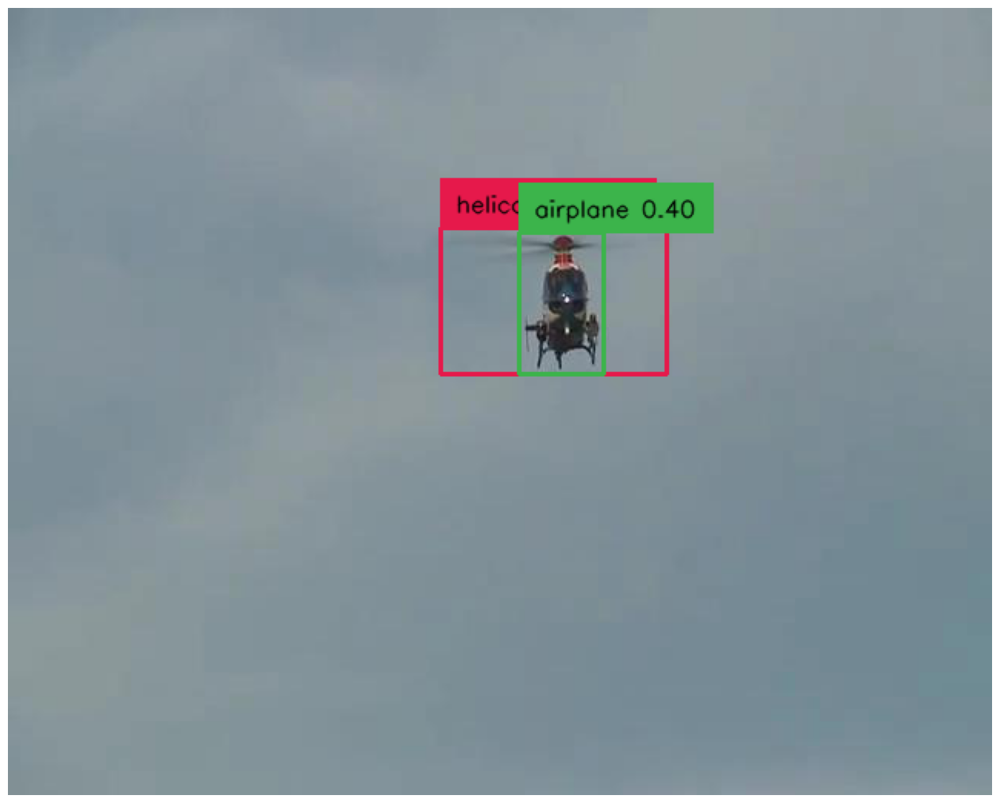

80.jpeg
354.93080139160156 191.2118377685547 146.46380424499512 94.6280288696289


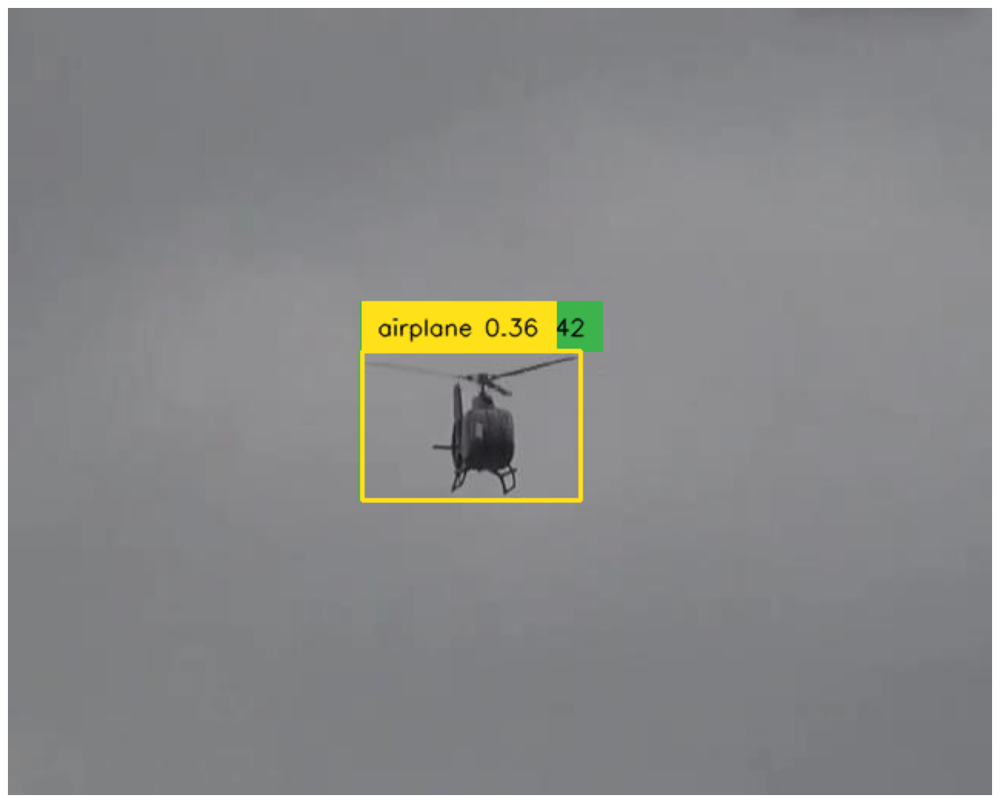

81.jpeg
301.4249801635742 271.9192810058594 143.1031322479248 97.29505920410156


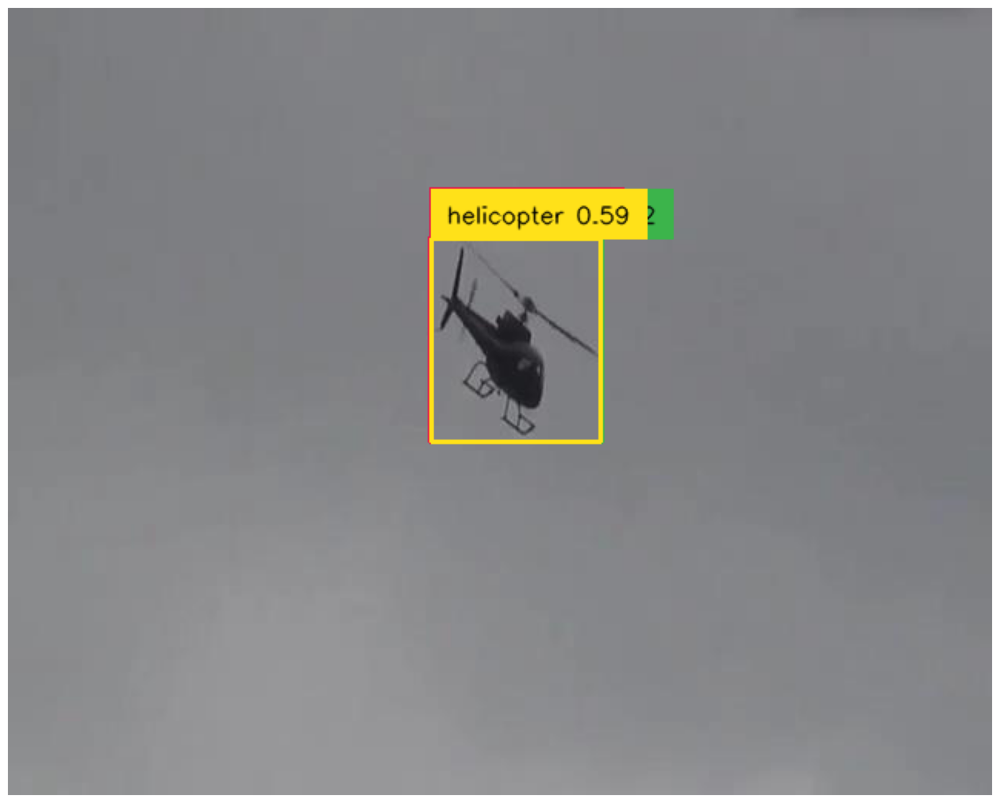

82.jpeg
330.5996322631836 216.18255615234375 110.74386596679688 131.7024688720703


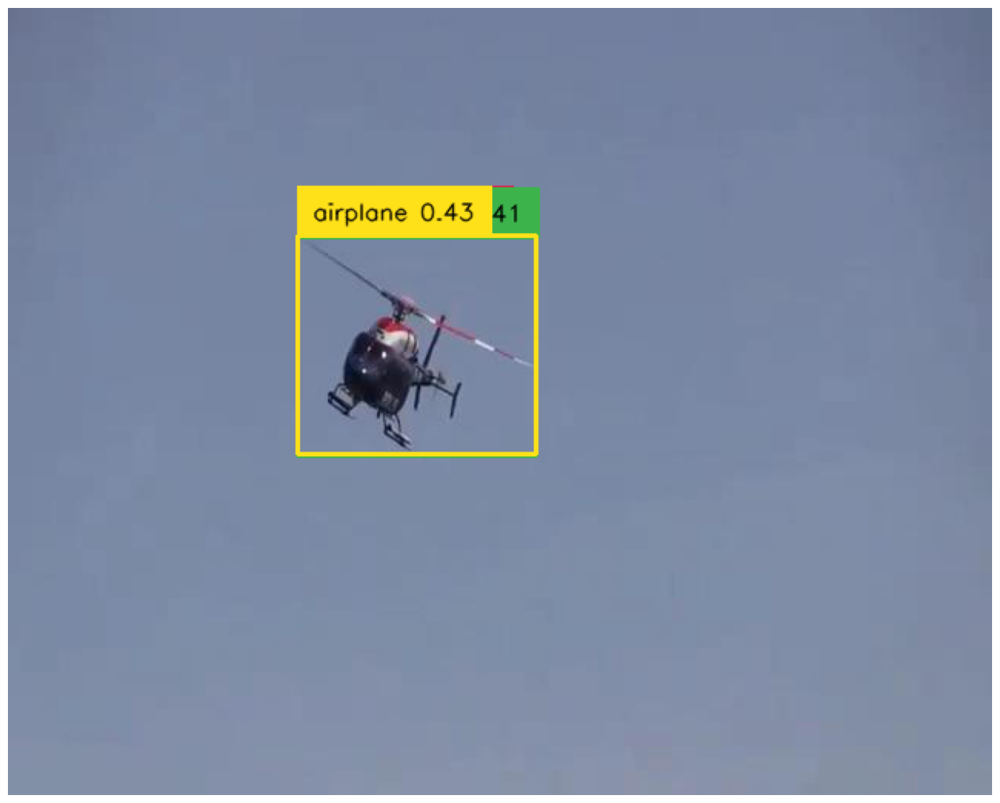

83.jpeg
265.7606887817383 219.9741973876953 155.43338775634766 142.18386840820312


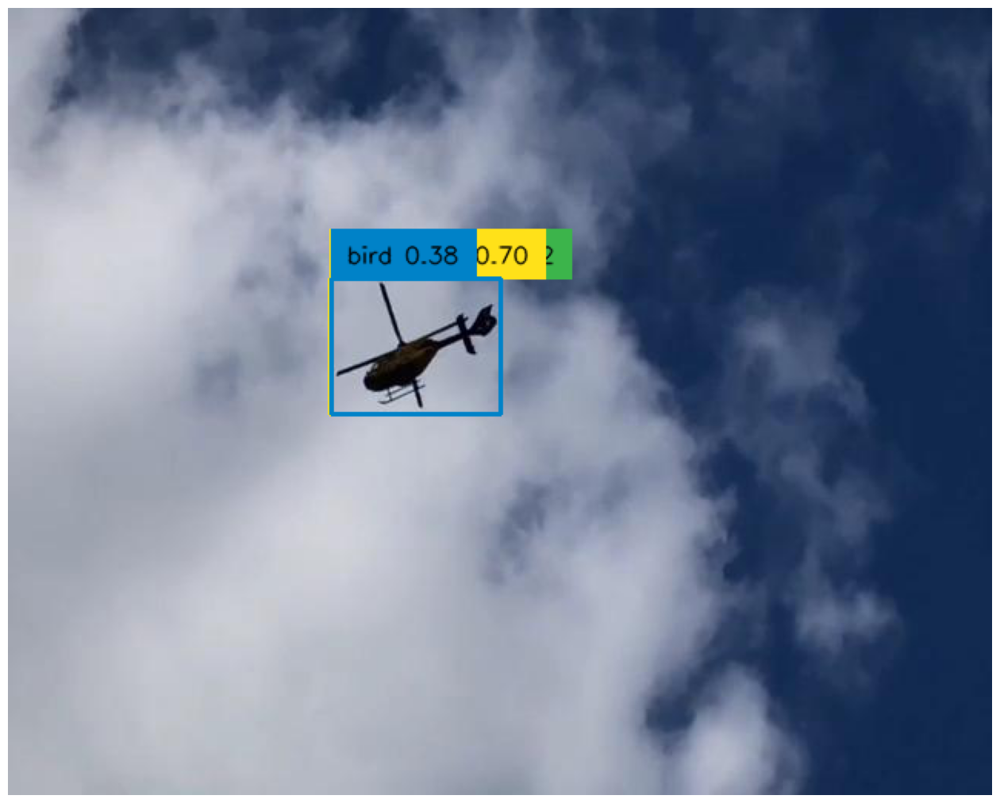

84.jpeg
265.279483795166 220.520263671875 110.58996200561523 88.10812377929688


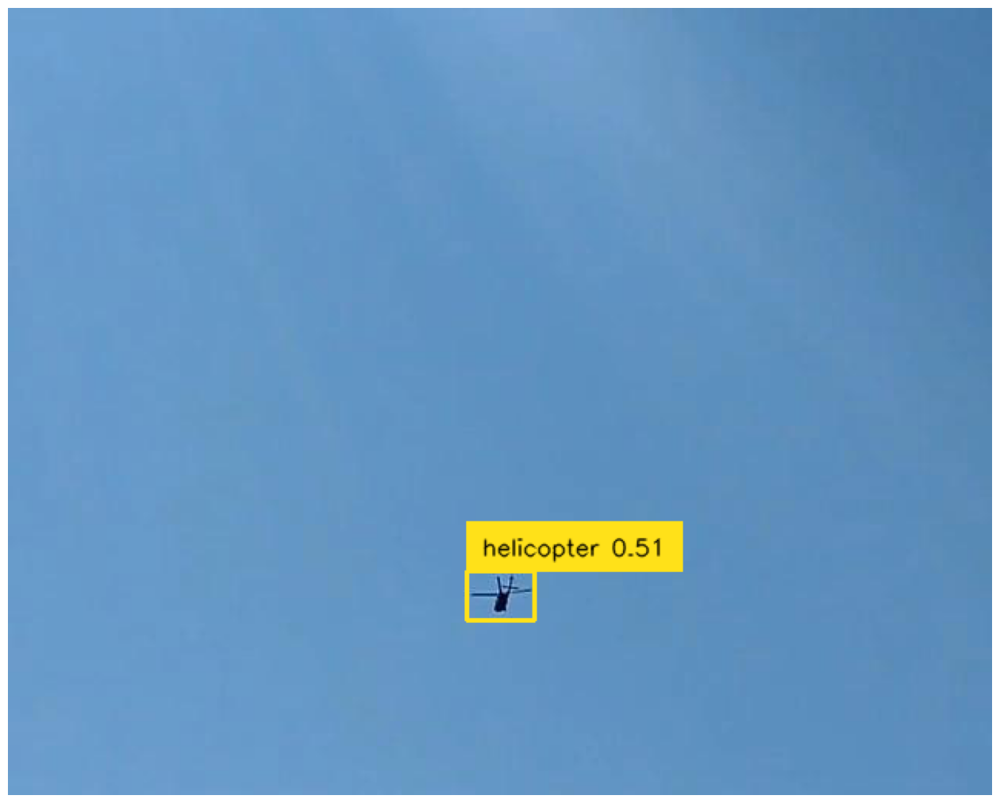

85.jpeg
320.3845977783203 382.43414306640625 44.4325065612793 31.488801956176758


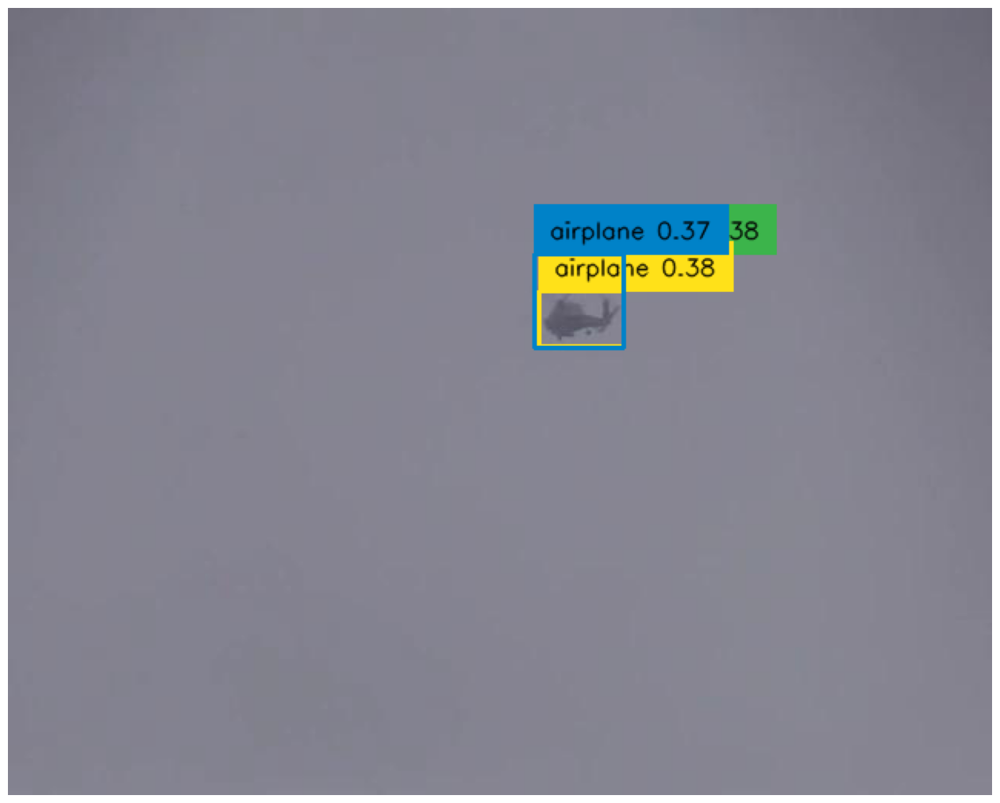

86.jpeg
371.30321502685547 190.68504333496094 58.379220962524414 61.1017951965332


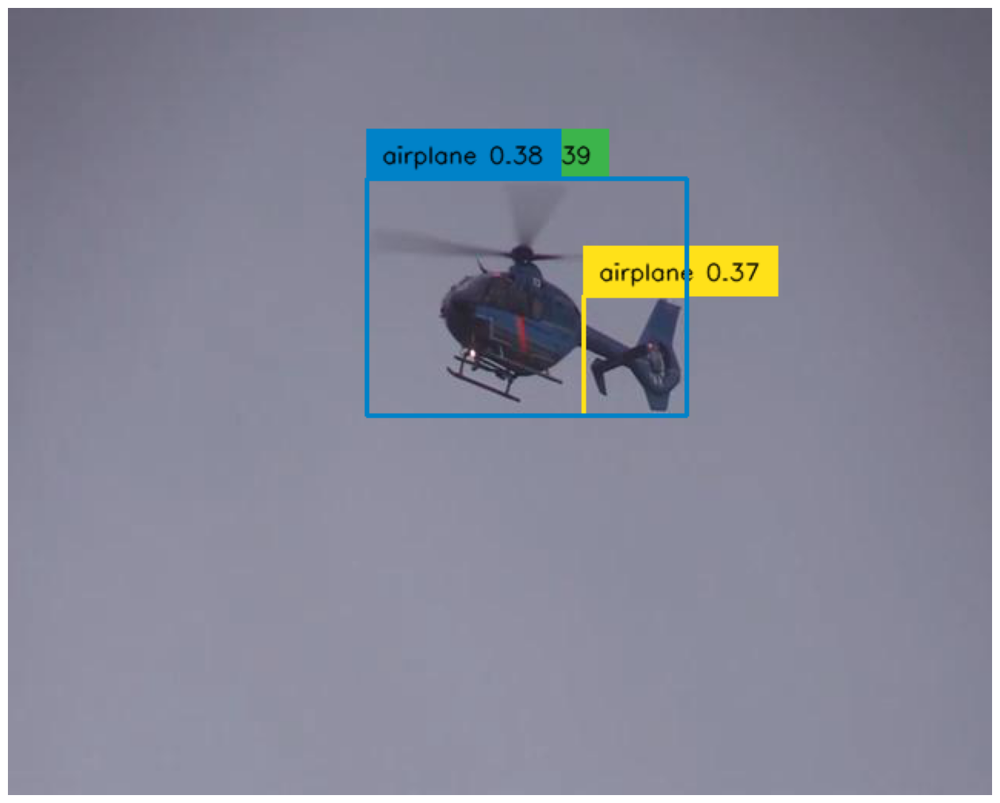

87.jpeg
337.28843688964844 188.5816650390625 208.49462509155273 154.4199981689453


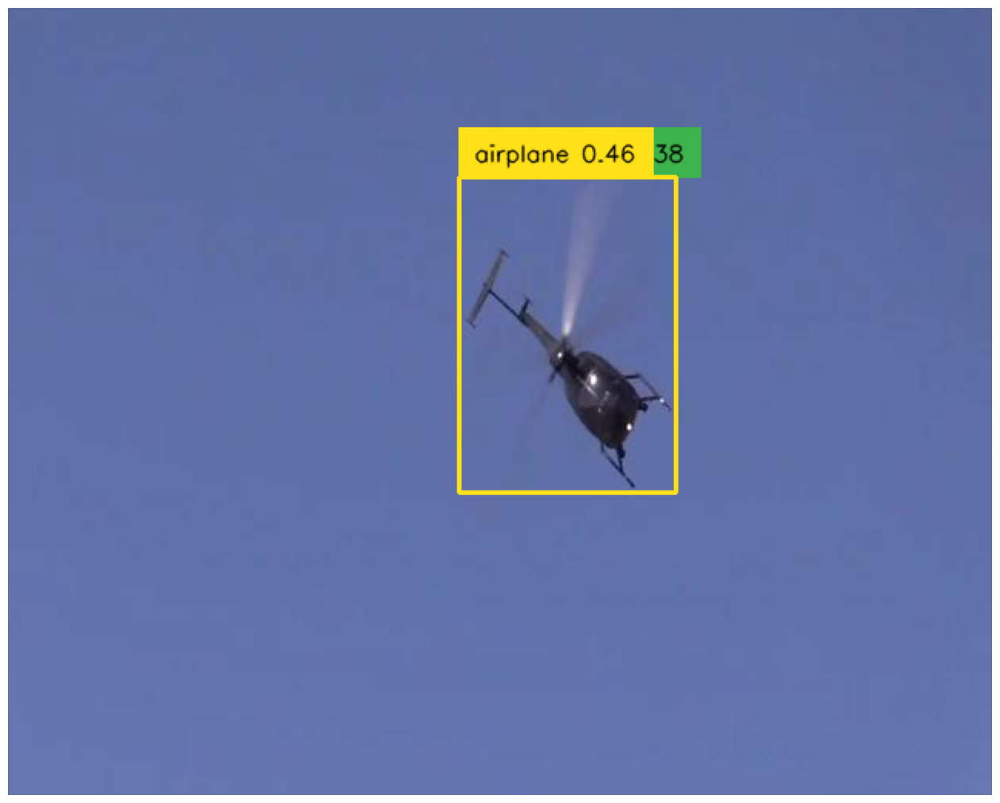

88.jpeg
364.22584533691406 212.9454803466797 140.64730644226074 205.3225860595703


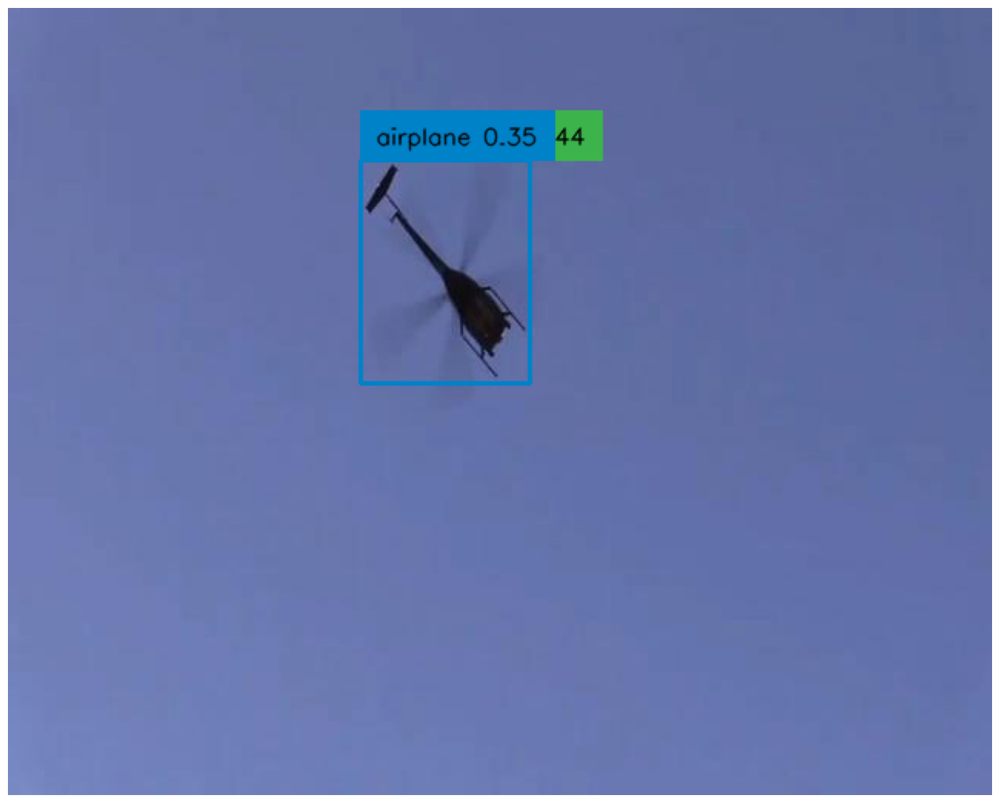

89.jpeg
284.40256118774414 171.8582305908203 110.69612503051758 145.17239379882812


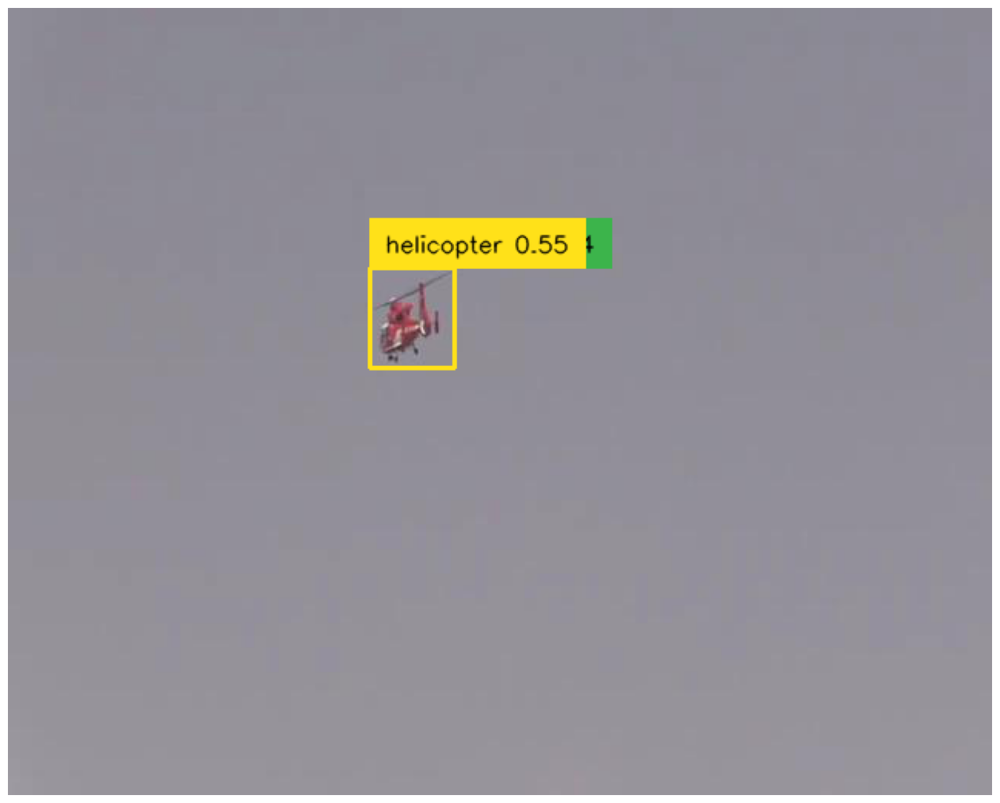

90.jpeg
263.15561294555664 201.8116912841797 55.674710273742676 65.49725341796875


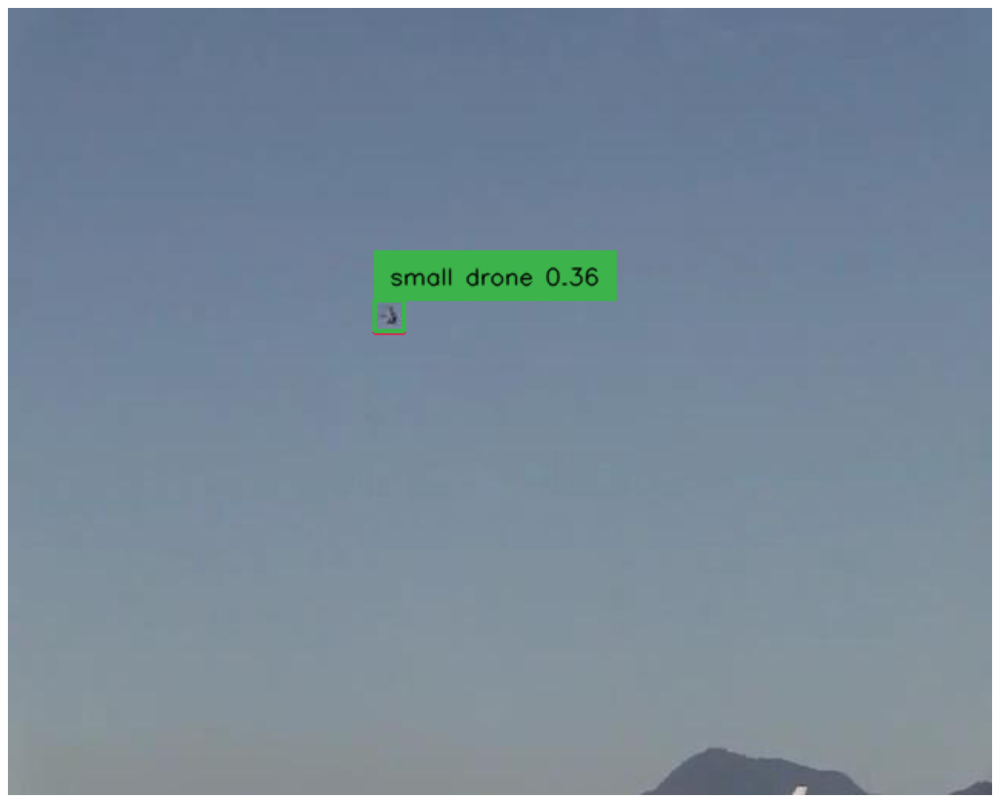

91.jpeg
247.65748977661133 200.96435546875 18.745193481445312 20.148418426513672


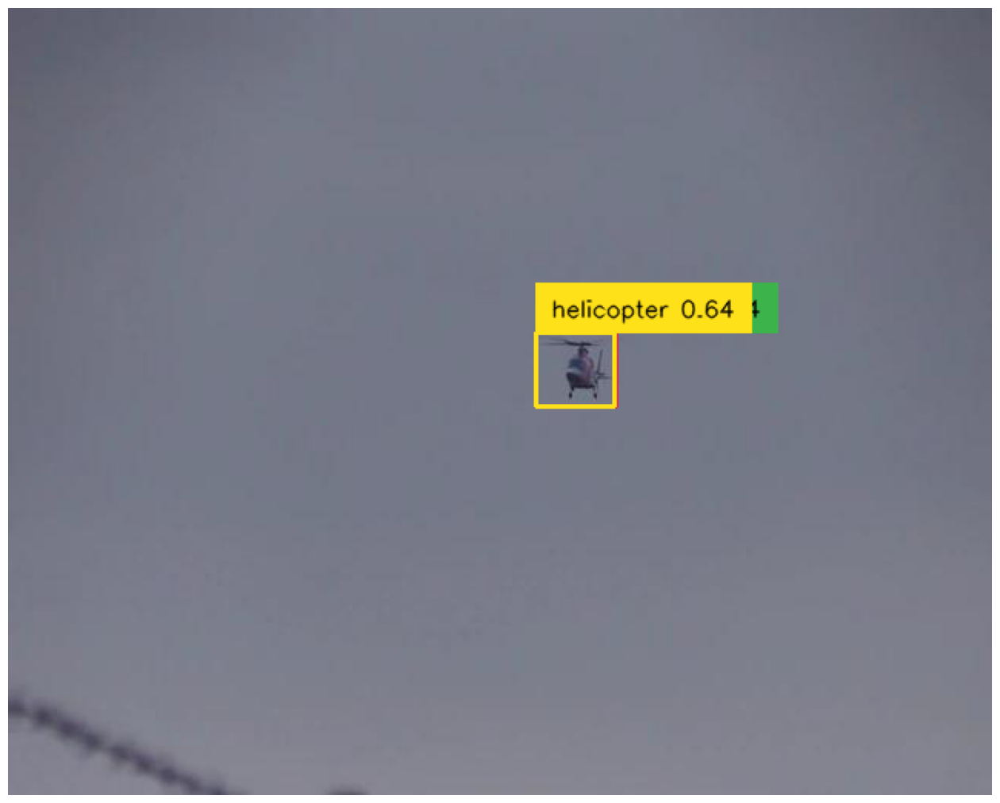

92.jpeg
369.0968704223633 235.54705810546875 51.234169006347656 47.57268524169922


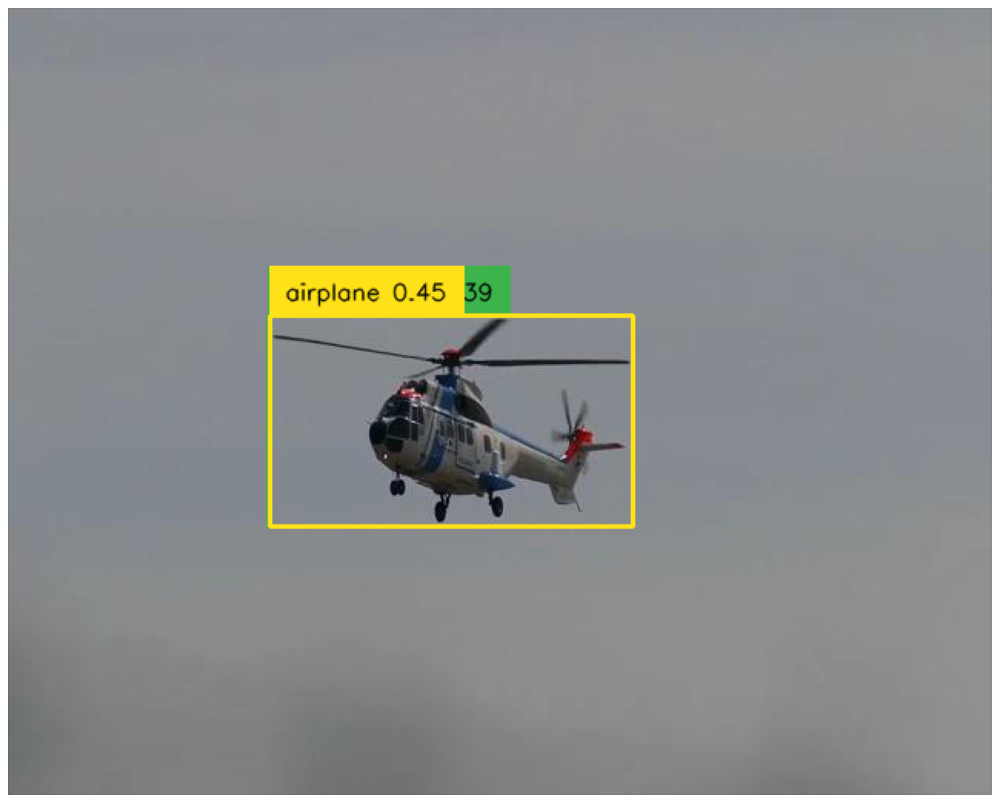

93.jpeg
288.22866439819336 268.9045715332031 237.11481094360352 136.9919891357422


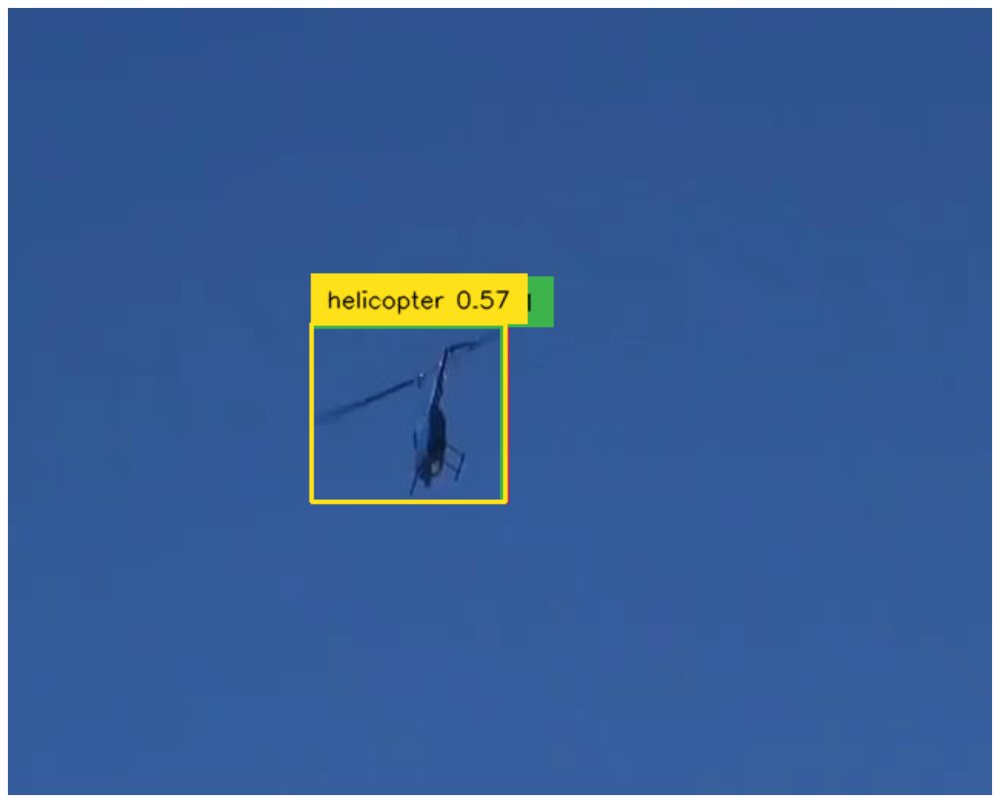

94.jpeg
260.68023681640625 263.2747802734375 126.4607048034668 115.8988037109375


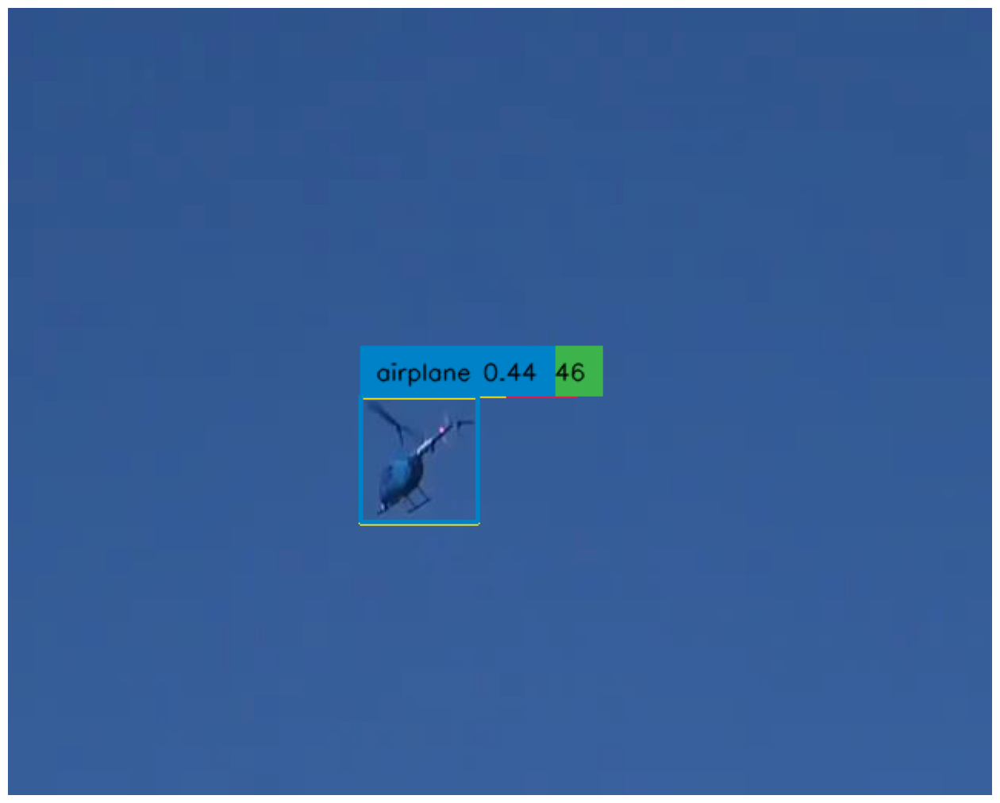

95.jpeg
267.46625900268555 294.2135314941406 76.35283946990967 82.24212646484375


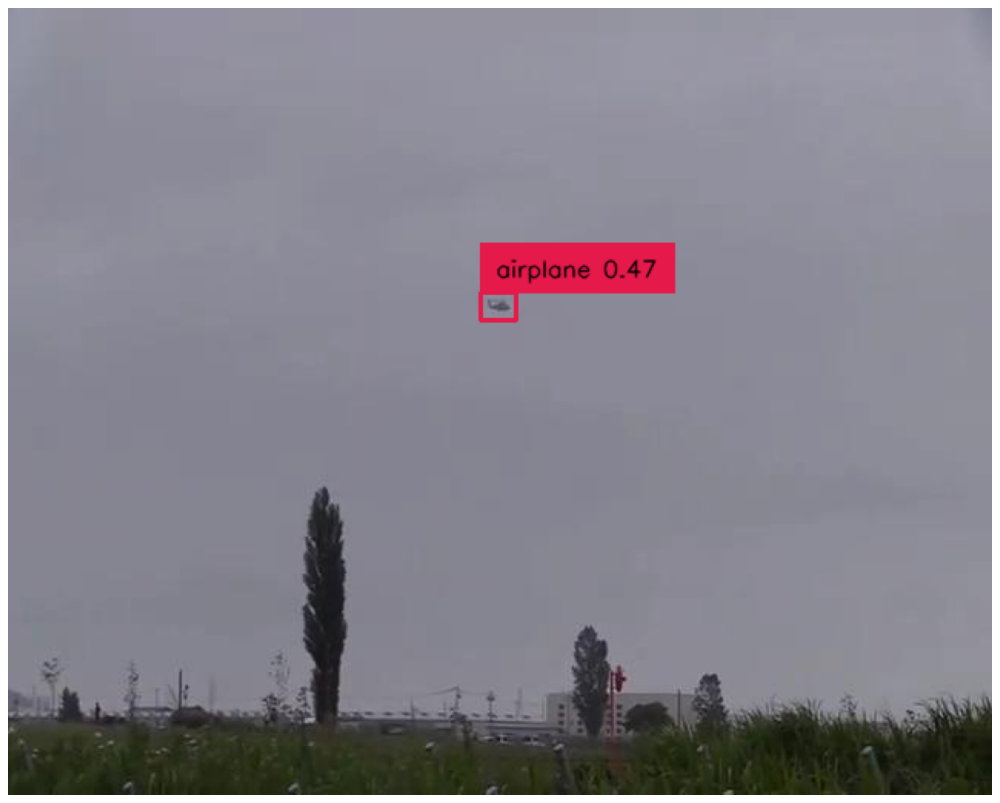

96.jpeg
318.91687393188477 194.23451232910156 23.184878826141357 18.417137145996094


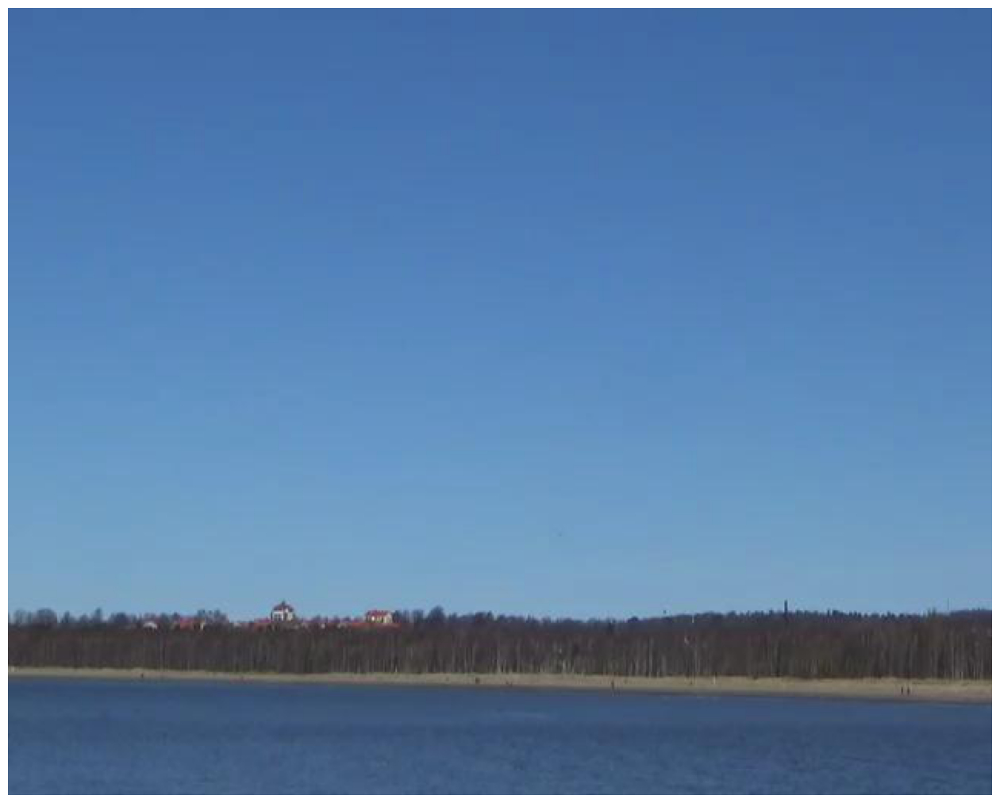

97.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


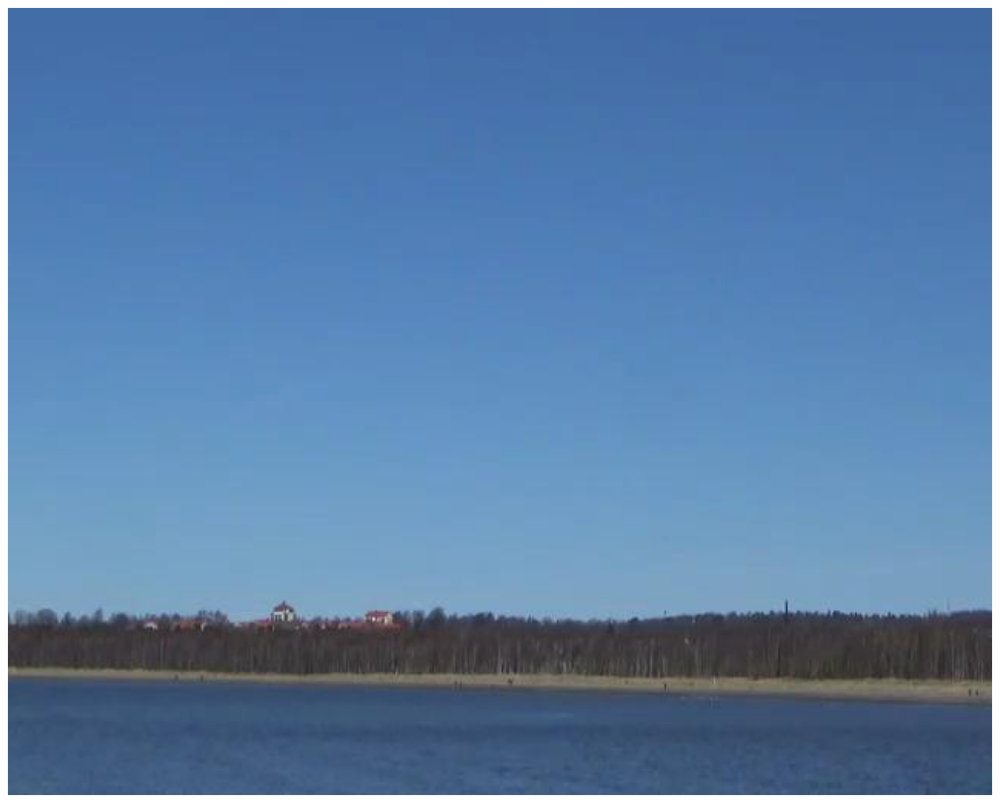

98.jpeg
377.08799999999997 124.8768 18.304000000000002 14.4896


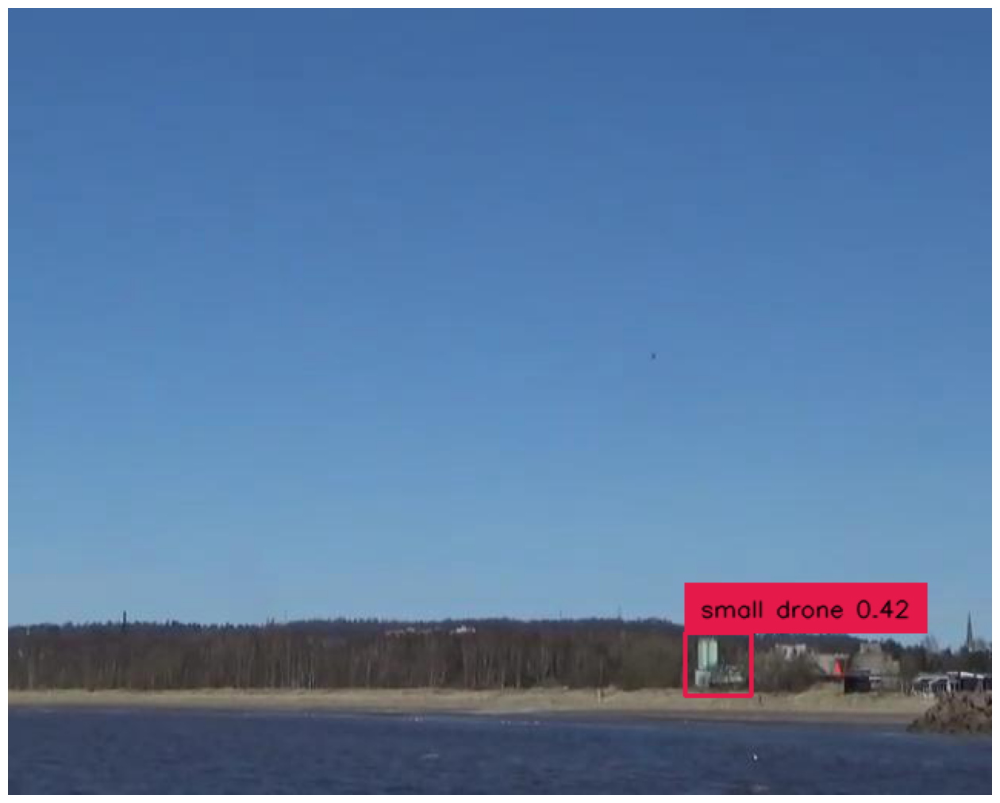

99.jpeg
462.42496490478516 427.1841735839844 43.00002574920654 41.28830337524414


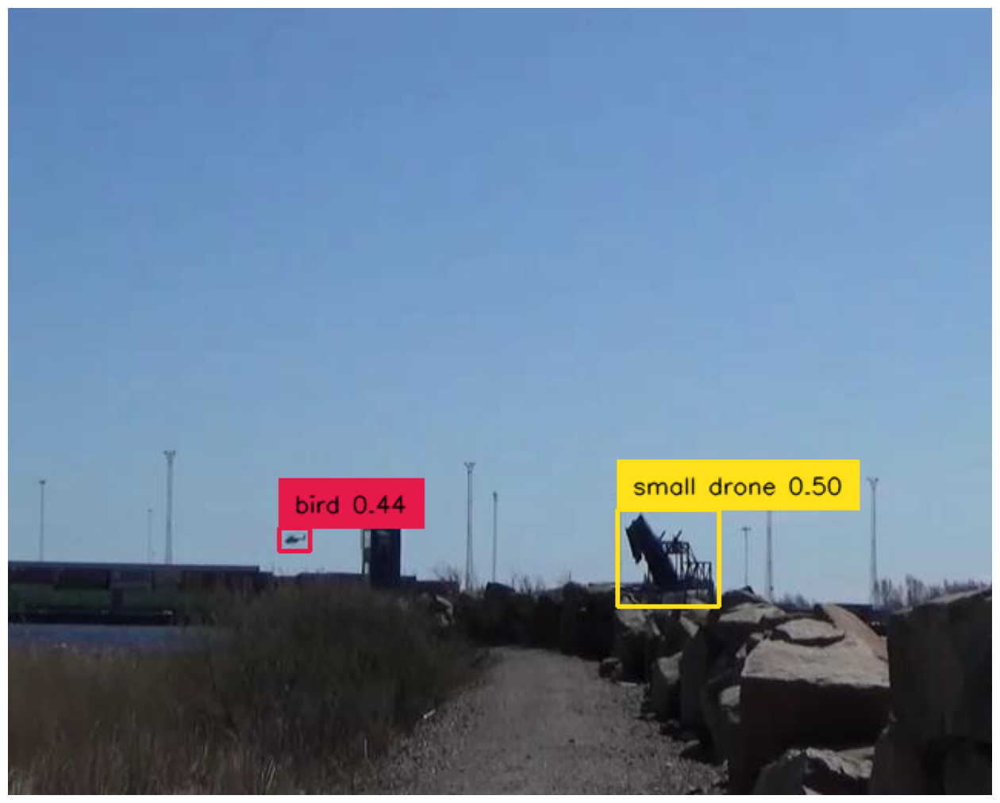

100.jpeg
429.476318359375 358.1048889160156 66.11922264099121 62.8487548828125


In [37]:
import os
import supervision as sv
import pandas as pd
import csv
classes = ['airplane','bird','small drone','helicopter']

output_folder = '/kaggle/working/output'
values = []
def prediction(imagename):
    IMAGE_NAME = "86.jpeg"
    IMAGE_PATH = "/kaggle/input/samplepesu/Test_data_images/" + imagename

    TEXT_PROMPT = "airplane,small drone,helicopter,bird"
    BOX_TRESHOLD = 0.35
    TEXT_TRESHOLD = 0.35

    image_source, image = load_image(IMAGE_PATH)

    boxes, logits, phrases = predict(
        model=model, 
        image=image, 
        caption=TEXT_PROMPT, 
        box_threshold=BOX_TRESHOLD, 
        text_threshold=TEXT_TRESHOLD
    )

    annotated_frame = annotate(image_source=image_source, boxes=boxes, logits=logits, phrases=phrases)

    %matplotlib inline  
    sv.plot_image(annotated_frame, (16, 16)) #to show images
    max_index=0
    maxval = -1
    index =0
    logits_list = logits.tolist() 

    for i in logits:
        if i>maxval:
            max_index = index
            maxval = i
        index+=1
    if(maxval > -1):
        phrase_final = phrases[max_index]
        
        box_list = boxes.tolist()
        box_final = box_list[max_index]
        logits_final = logits_list[max_index]
        
    else:
        box_final = [0.5892, 0.2439, 0.0286, 0.0283]
        phrase_final = "bird"
        logits_final = 0.558956146240234
    final_digit = classes.index(phrase_final)
    #x1, y1, x2, y2 
    x1 = box_final[0] * 640
    y1 = box_final[1] * 512
    x2 = box_final[2] * 640
    y2 = box_final[3] * 512
    print(imagename)
    print(x1,y1,x2,y2)
    #x1, y1, x1+x2, y1+y2
    results = str(final_digit)+" " +str(logits_final)+" " +str(x1)+" " +str(y1)+" " +str(x2)+" "+str(y2) 
    
    
    results2 = []
    results2 = [imagename,results]
    
    values.append(results2)
    return values
    # 0.5589561462402344 183.50775146484375 254.75418090820312 204.68694686889648 280.895516872406
        
        
for i in range(1,101):
    imagename = str(i) + ".jpeg"
    values = prediction(imagename)

    
header = ['Test image', 'Prediction string']
#print(values)
with open('final_output.csv', 'w') as file:
    writer = csv.writer(file)
    writer.writerow(header)
    writer.writerows(values)


